In [ ]:
import cv2
import numpy as np
import pandas as pd
from math import *
import matplotlib.pyplot as plt

%matplotlib inline

读入原始答题卡图像

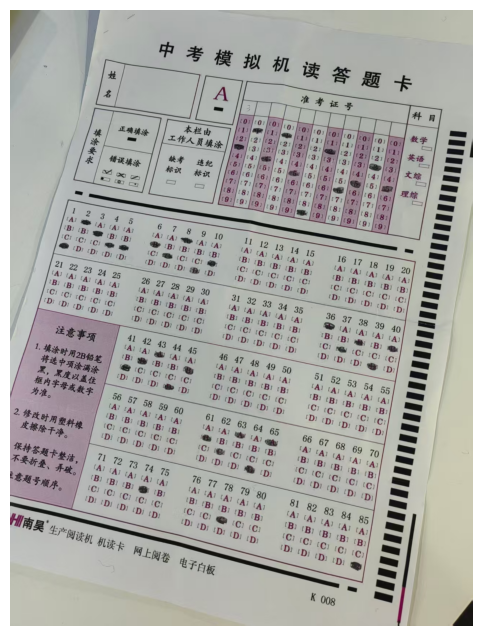

In [ ]:
img_path = "images/test2.jpg"
img = cv2.imread(img_path)
plt.figure(figsize=(10, 8))
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

检测黑线

检测到 9 条直线
线段 0: (705,591)-(1202,679), 长度=504.7px, 角度=10.0°
线段 1: (731,603)-(1201,686), 长度=477.3px, 角度=10.0°
线段 2: (436,1472)-(801,1569), 长度=377.7px, 角度=14.9°
线段 3: (142,1392)-(543,1492), 长度=413.3px, 角度=14.0°
线段 4: (321,527)-(677,584), 长度=360.5px, 角度=9.1°
线段 5: (100,1390)-(529,1497), 长度=442.1px, 角度=14.0°
线段 6: (392,546)-(690,594), 长度=301.8px, 角度=9.2°
线段 7: (1050,1635)-(1256,338), 长度=1313.3px, 角度=-81.0°
线段 8: (426,1461)-(772,1553), 长度=358.0px, 角度=14.9°
[9.096553846686023, 9.150256778014878, 10.014934016665483, 10.040859276492256, 14.002619188034716, 14.004814080232427, 14.88255502086047, 14.89018236732713]
建议答题卡逆时针旋转校正角度:14.0°


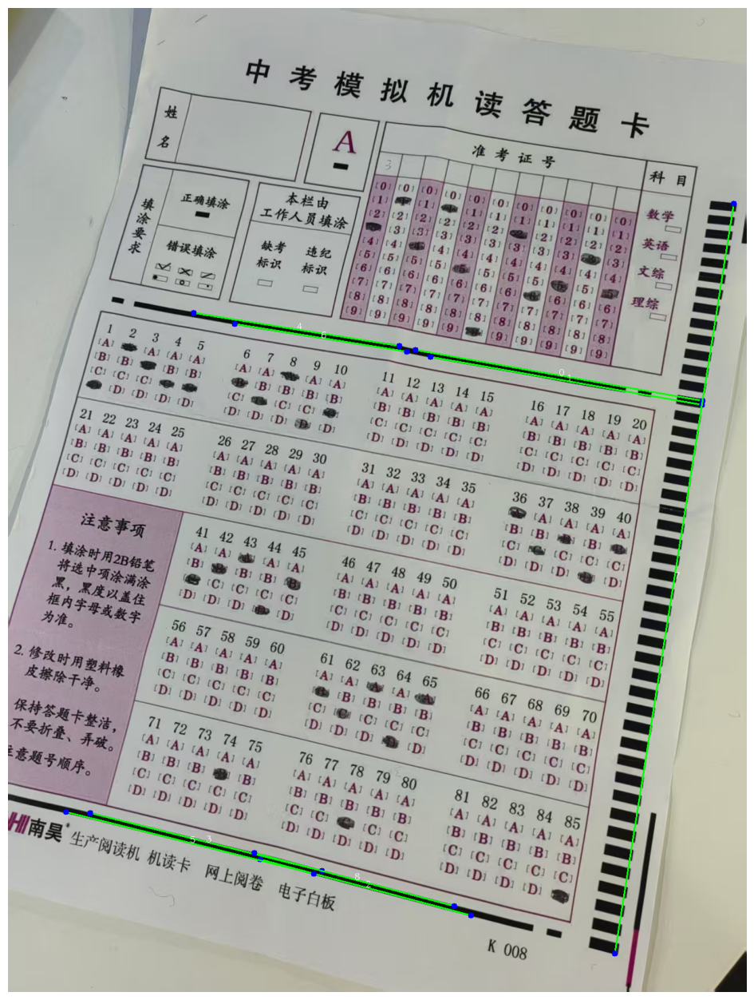

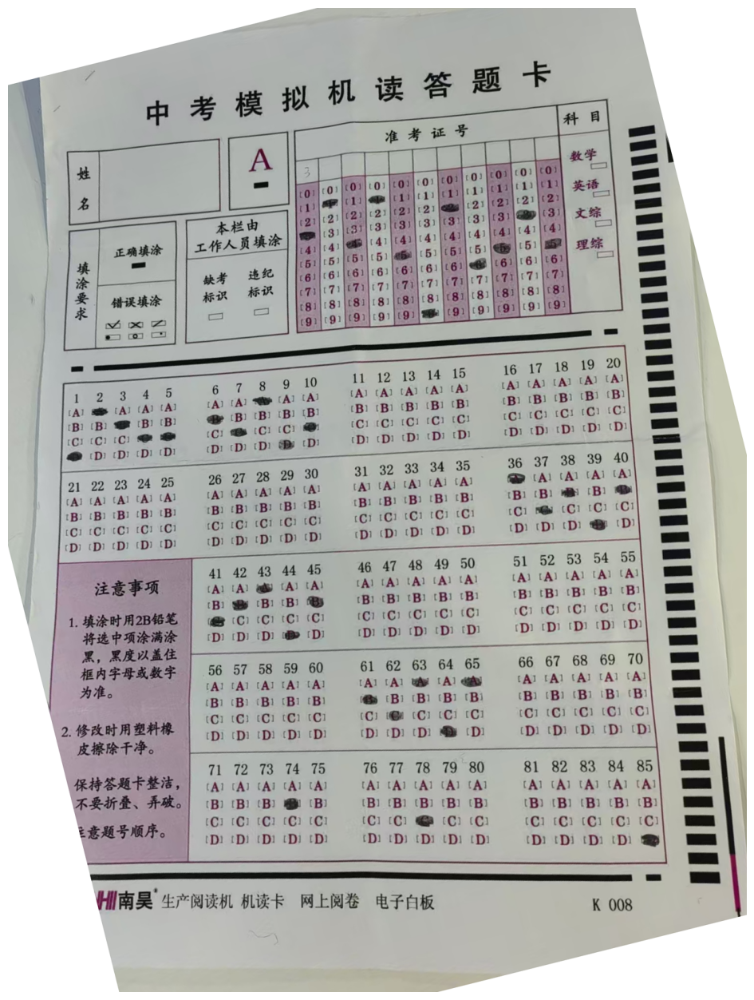

In [ ]:
#转灰度图
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
#高斯模糊去噪
is_blur = True
blur = cv2.GaussianBlur(gray, (3, 3), 0) if is_blur else gray
#二值化（检测黑线）,<30 -> white, >30 -> black
_, binary= cv2.threshold(blur, 30, 255, cv2.THRESH_BINARY_INV)
#闭运算缝合边缘/黑块
kernel = np.ones((5, 5), np.uint8)
binary = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel)
#边缘检测
edges = cv2.Canny(binary, 50, 150, apertureSize=3)
#闭运算缝合边缘
#kernel = np.ones((5, 5), np.uint8)
#edges_closed = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)
#霍夫变换直线检测
lines = cv2.HoughLinesP(edges,
                       rho=1,                # 距离分辨率（像素）
                       theta=np.pi/180,      # 角度分辨率（弧度）
                       threshold=200,         # 投票阈值 -> 控制检测灵敏度（值小检测更多直线）
                       minLineLength=200,    # 最小线段长度
                       maxLineGap=80)        # 最大线段间隙

black_lines = img.copy()

angle_list = []
if lines is not None:
    print(f"检测到 {len(lines)} 条直线")

    for i, line in enumerate(lines):
        x1, y1, x2, y2 = line[0]

        # 绘制绿色直线，线宽2
        cv2.line(black_lines, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # 可选：标注端点（红色圆点）
        cv2.circle(black_lines, (x1, y1), 5, (255, 0, 0), -1)
        cv2.circle(black_lines, (x2, y2), 5, (255, 0, 0), -1)

        # 可选：显示线段编号
        mid_x = (x1 + x2) // 2
        mid_y = (y1 + y2) // 2
        cv2.putText(black_lines, str(i), (mid_x, mid_y),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 1)

        # 打印线段信息
        angle = np.degrees(np.arctan2(y2 - y1, x2 - x1))
        if abs(angle)<45:
             angle_list.append(angle)
        length = np.sqrt((x2 - x1)**2 + (y2 - y1)**2)
        print(f"线段 {i}: ({x1},{y1})-({x2},{y2}), "
              f"长度={length:.1f}px, 角度={angle:.1f}°")
else:
    print("未检测到直线")

# 取角度中位值作为校正角度
sorted_angle_list = sorted(angle_list)
rotation_angle = sorted_angle_list[len(sorted_angle_list)//2]
print(sorted_angle_list)
print(f"建议答题卡逆时针旋转校正角度:{rotation_angle:.1f}°")

angle_threshold =  1
if abs(rotation_angle) > angle_threshold:
    #旋转校正图像
    (h, w) = img.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, rotation_angle, 1.0)
    rotated = cv2.warpAffine(img, M, (w, h),
                                 flags=cv2.INTER_CUBIC,
                                 borderMode=cv2.BORDER_CONSTANT,
                                 borderValue=(255, 255, 255))
else:
    print("无需校正！")

figure_plot = True

if figure_plot:
    '''
    plt.figure(figsize=(20, 16))
    plt.imshow(gray, cmap='gray')
    plt.axis('off')
    plt.show()

    plt.figure(figsize=(20, 16))
    plt.imshow(blur, cmap='gray')
    plt.axis('off')
    plt.show()

    plt.figure(figsize=(20, 16))
    plt.imshow(binary, cmap='gray')
    plt.axis('off')
    plt.show()

    plt.figure(figsize=(20, 16))
    plt.imshow(edges, cmap='gray')
    plt.axis('off')
    plt.show()

    plt.figure(figsize=(20, 16))
    plt.imshow(edges_closed, cmap='gray')
    plt.axis('off')
    plt.show()
    '''

    plt.figure(figsize=(20, 16))
    plt.imshow(cv2.cvtColor(black_lines, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

    plt.figure(figsize=(20, 16))
    plt.imshow(cv2.cvtColor(rotated, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()


识别黑块，确定水平网格线

一共检测到 661 个轮廓
筛选出 46 个有效轮廓
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

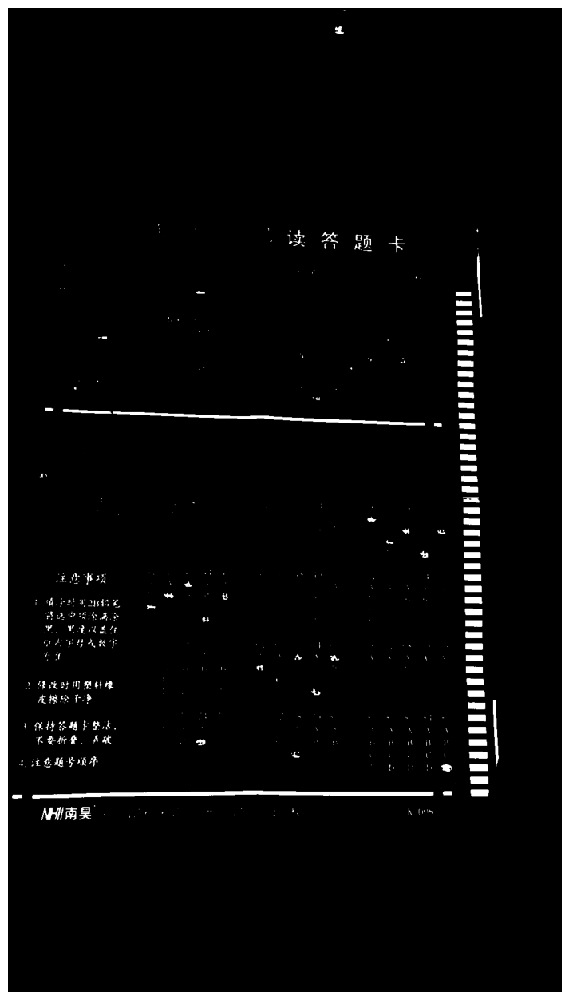

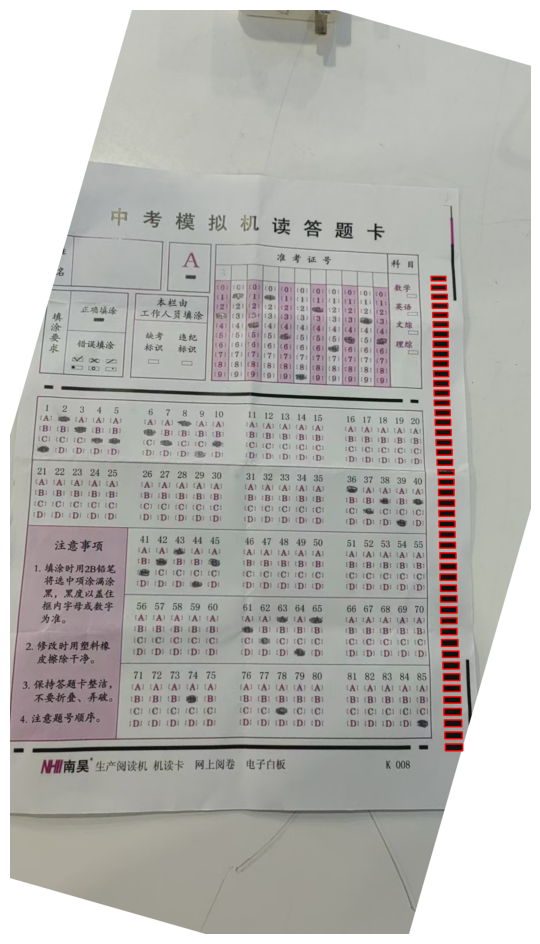

In [ ]:
#转灰度图
gray2 = cv2.cvtColor(rotated, cv2.COLOR_BGR2GRAY)
#高斯模糊去噪
is_blur2 = True
blur2 = cv2.GaussianBlur(gray2, (3, 3), 0) if is_blur2 else gray2
_, binary2 = cv2.threshold(blur2, 70, 255, cv2.THRESH_BINARY_INV)

#检测轮廓
contours, _ = cv2.findContours(binary2, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

marked_img_simple = rotated.copy()
print(f"一共检测到 {len(contours)} 个轮廓")
valid_cnts = 0
area_list = []
aspect_ratio_list = []

# 绘制所有轮廓
for i, cnt in enumerate(contours):
    area = cv2.contourArea(cnt)
    x, y, w, h = cv2.boundingRect(cnt)
    aspect_ratio = w/h
    area_list.append(area)
    aspect_ratio_list.append(aspect_ratio)
    if area>200 and area<2000 and aspect_ratio>1.5 and aspect_ratio<5:
        # 绘制边界框
        cv2.rectangle(marked_img_simple, (x, y), (x + w, y + h), (0,0,255), 2)
        valid_cnts = valid_cnts + 1
print(f"筛选出 {valid_cnts} 个有效轮廓")
print(sorted(area_list))
print(sorted(aspect_ratio_list))

plt.figure(figsize=(20, 16))
plt.imshow(binary2, cmap='gray')
plt.axis('off')
plt.show()

plt.figure(figsize=(20, 12))
plt.imshow(cv2.cvtColor(marked_img_simple, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [ ]:
from find_region import process_answer_sheet

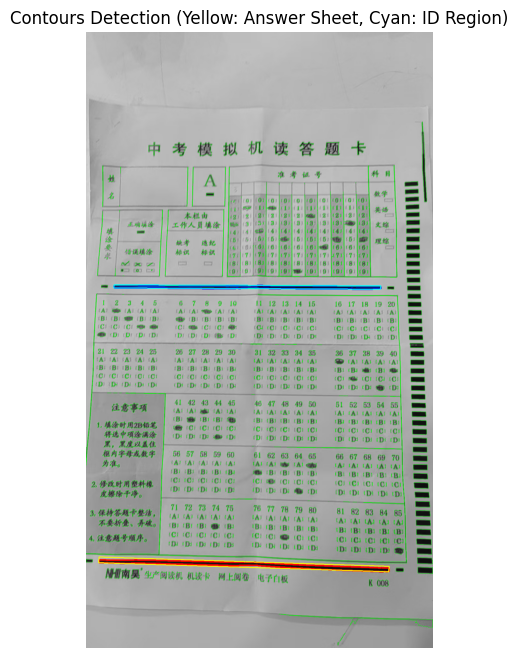

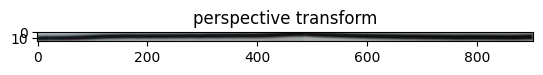

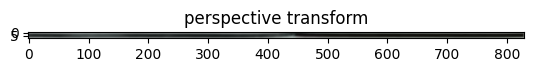

In [ ]:
sheet_warped, id_region_warped = process_answer_sheet('./images/test3.jpg', show=True)

检测到 8 条直线
线段 0: (202,1647)-(402,1653), 长度=200.1px, 角度=1.7°
线段 1: (696,1669)-(932,1677), 长度=236.1px, 角度=1.9°
线段 2: (239,1653)-(654,1661), 长度=415.1px, 角度=1.1°
线段 3: (535,793)-(799,793), 长度=264.0px, 角度=0.0°
线段 4: (595,1659)-(1076,1676), 长度=481.3px, 角度=2.0°
线段 5: (998,667)-(1033,1679), 长度=1012.6px, 角度=88.0°
线段 6: (765,798)-(1039,798), 长度=274.0px, 角度=0.0°
线段 7: (43,1649)-(314,1654), 长度=271.0px, 角度=1.1°
建议答题卡逆时针旋转校正角度:1.1°
一共检测到 653 个轮廓


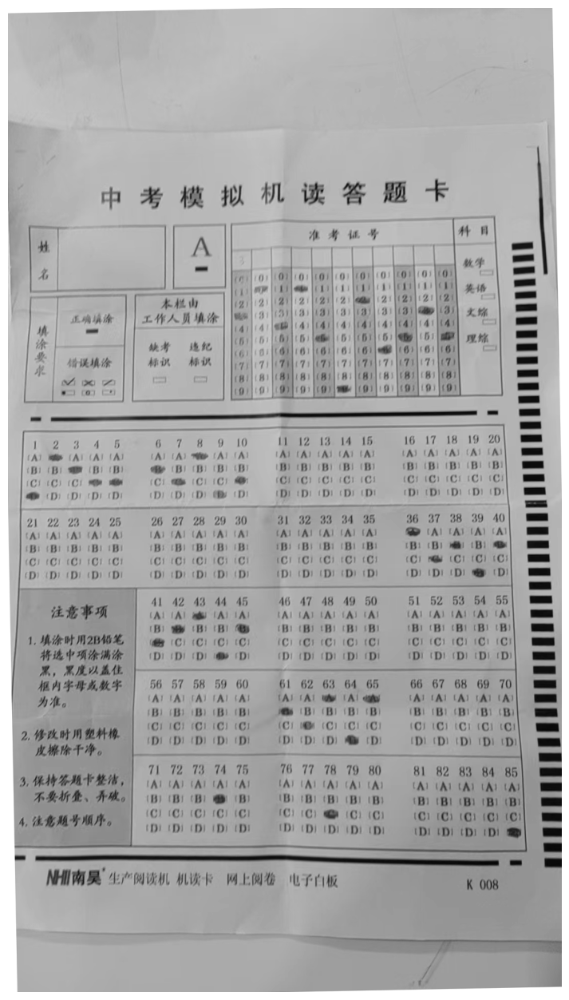

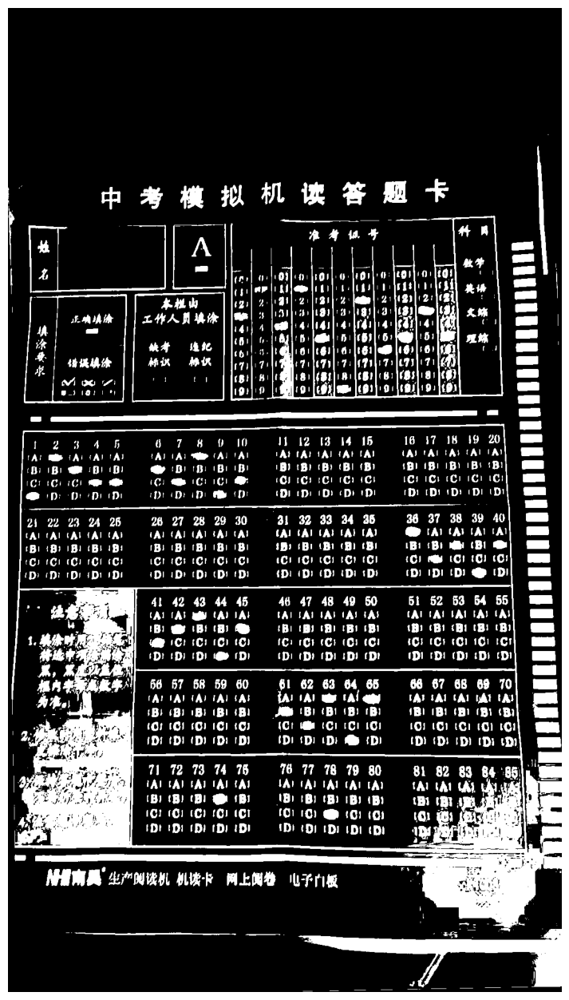

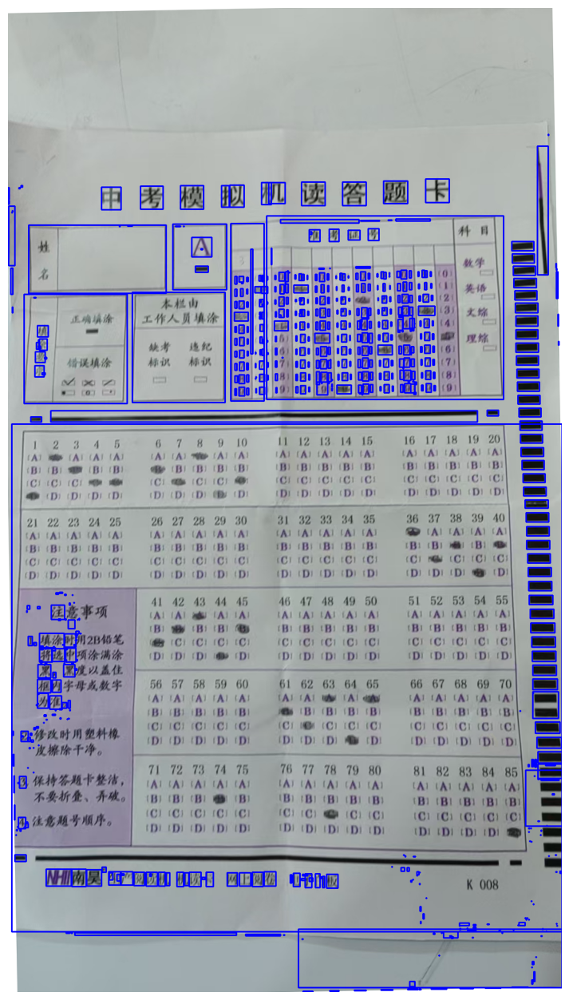

In [ ]:
from deskew_sheet import deskew_sheet
deskewed = deskew_sheet('images/test3.jpg', debug = False)
# 识别块状区域（覆盖答题区）
gray = cv2.cvtColor(deskewed, cv2.COLOR_BGR2GRAY)
_, binary = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
#_, binary = cv2.threshold(gray, 150, 255, cv2.THRESH_BINARY_INV )
#blur = cv2.GaussianBlur(gray, (3, 3), 0)
# 闭运算
#kernel = np.ones((3, 3), np.uint8)
#closed = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel)
#边缘检测
contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

img_edges = deskewed.copy()
print(f"一共检测到 {len(contours)} 个轮廓")
valid_cnts = 0
area_list = []
aspect_ratio_list = []

# 绘制所有轮廓
for i, cnt in enumerate(contours):
    area = cv2.contourArea(cnt)
    x, y, w, h = cv2.boundingRect(cnt)
    aspect_ratio = w/h
    #if area>200 and area<2000 and aspect_ratio>1.5 and aspect_ratio<5:
    # 绘制边界框
    cv2.rectangle(img_edges, (x, y), (x + w, y + h), (0,0,255), 2)

plt.figure(figsize=(20, 16))
plt.imshow(gray, cmap='gray')
plt.axis('off')
plt.show()

plt.figure(figsize=(20, 16))
plt.imshow(binary, cmap='gray')
plt.axis('off')
plt.show()

plt.figure(figsize=(20, 16))
plt.imshow(img_edges, cmap='gray')
plt.axis('off')
plt.show()


2025-12-19 涂卡点位识别

In [ ]:
def filter_and_renumber_groups(group_labels, min_group_size=3):
    """
    过滤小分组并重新编号组号
    
    参数:
    group_labels: 原始组标签列表，如 [0, 1, 1, 2, 2, 2, 3]
    min_group_size: 最小分组大小阈值，小于此值的组将被过滤
    
    返回:
    new_labels: 过滤并重新编号后的组标签列表
    group_mapping: 新旧组号映射字典 {old_group: new_group or None}
    """
    from collections import Counter
    
    # 1. 统计每个组的大小
    group_counts = Counter(group_labels)
    
    # 2. 创建组号映射：只保留大小>=阈值的组
    valid_groups = [g for g, count in group_counts.items() if count >= min_group_size]
    valid_groups.sort()  # 确保顺序
    
    # 3. 创建映射字典
    group_mapping = {}
    for i, old_group in enumerate(valid_groups):
        group_mapping[old_group] = i  # 重新编号为0,1,2...
    
    # 4. 生成新的组标签
    new_labels = []
    for old_group in group_labels:
        if old_group in group_mapping:
            new_labels.append(group_mapping[old_group])
        else:
            new_labels.append(None)  # 或者可以设为-1表示被过滤
    
    return new_labels, group_mapping

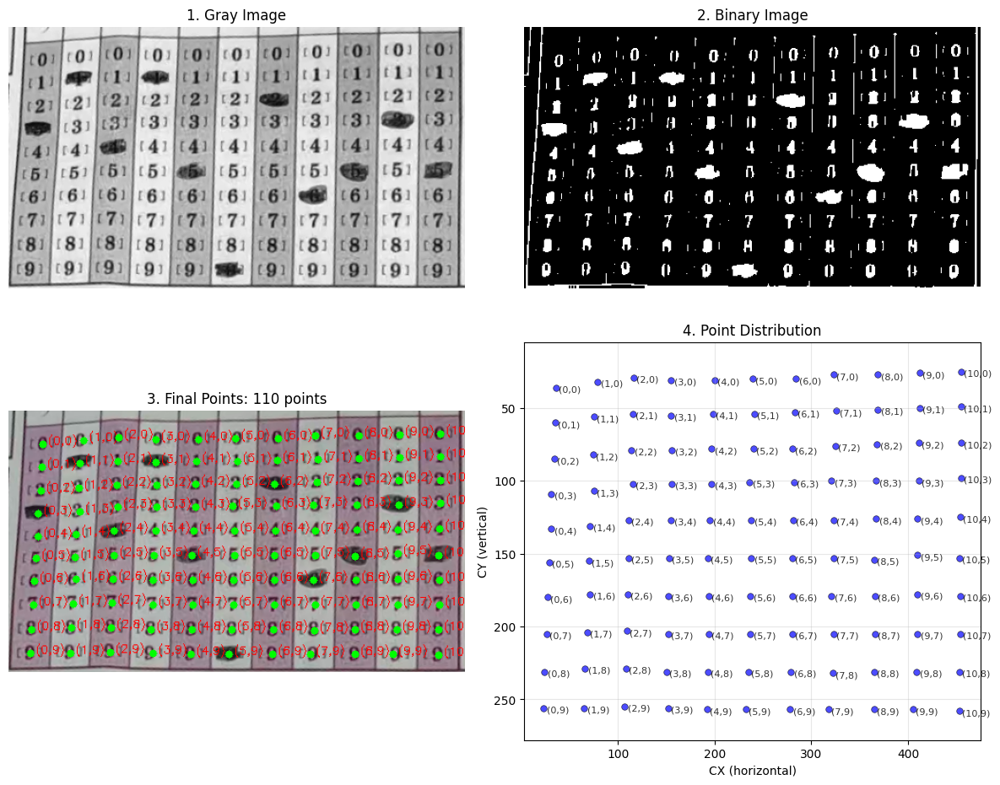

In [ ]:
from find_region import process_answer_sheet
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ==================== 1. 图像预处理 ====================
# 处理答题卡
ans_region, id_region = process_answer_sheet('images/test2.jpg', show=False)

# 裁剪区域
W_id, H_id = id_region.shape[1], id_region.shape[0]
W_thres_paint, H_thres_paint = 0.85, 0.25
id_region_paint = id_region[int(H_thres_paint*H_id):, :int(W_thres_paint*W_id)]

# 灰度化和二值化
id_region_gray = cv2.cvtColor(id_region_paint, cv2.COLOR_BGR2GRAY)
kernel = np.ones((6, 2), np.uint8)
id_region_opened = cv2.morphologyEx(id_region_gray, cv2.MORPH_OPEN, kernel)
_, id_region_binary = cv2.threshold(id_region_opened, 80, 255, cv2.THRESH_BINARY_INV)

# 轮廓检测
id_region_cnts, _ = cv2.findContours(id_region_binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# 轮廓过滤
id_region_edges = id_region_paint.copy() 
filtered_cnts_info = []

for cnt in id_region_cnts:
    x, y, w, h = cv2.boundingRect(cnt)
    area = cv2.contourArea(cnt)
    aspect_ratio = w / h
    
    if area > 5 and area < 400 and 0.1 < aspect_ratio < 10:
        contour_info = {
            'cnt': cnt,
            'x': x, 'y': y, 'w': w, 'h': h,
            'cx': x + w // 2,
            'cy': y + h // 2
        }
        filtered_cnts_info.append(contour_info)
        cv2.rectangle(id_region_edges, (x, y), (x + w, y + h), (0, 0, 255), 2)

# ==================== 2. 创建DataFrame ====================
df = pd.DataFrame([
    {'cx': info['cx'], 'cy': info['cy'], 'contour': info['cnt']} 
    for info in filtered_cnts_info
])

# ==================== 3. 水平方向聚类 ====================
df = df.sort_values('cx').reset_index(drop=True)

x_group_thres = 10
df['group_x_temp'] = 0
current_group = 0

for i in range(len(df)):
    if i == 0:
        df.at[i, 'group_x_temp'] = current_group
    else:
        if df.at[i, 'cx'] - df.at[i-1, 'cx'] <= x_group_thres:
            df.at[i, 'group_x_temp'] = current_group
        else:
            current_group += 1
            df.at[i, 'group_x_temp'] = current_group

# 过滤小水平组
def filter_small_groups(df, group_col, min_size=5):
    group_counts = df[group_col].value_counts()
    valid_groups = group_counts[group_counts >= min_size].index.tolist()
    df_filtered = df[df[group_col].isin(valid_groups)].copy()
    
    group_mapping = {old: new for new, old in enumerate(sorted(valid_groups))}
    new_col = f'{group_col.split("_")[0]}_x' if 'x' in group_col else f'{group_col.split("_")[0]}_y'
    df_filtered[new_col] = df_filtered[group_col].map(group_mapping)
    
    return df_filtered.drop(columns=[group_col])

df = filter_small_groups(df, 'group_x_temp', min_size=5)

# 在水平组内垂直过滤
def filter_vertical_in_group(df, cy_threshold=5):
    filtered_rows = []
    for group_id, group_df in df.groupby('group_x'):
        group_df = group_df.sort_values('cy').reset_index(drop=True)
        last_cy = None
        keep_indices = []
        for idx, row in group_df.iterrows():
            if last_cy is None or abs(row['cy'] - last_cy) > cy_threshold:
                keep_indices.append(idx)
                last_cy = row['cy']
        filtered_rows.append(group_df.iloc[keep_indices])
    return pd.concat(filtered_rows, ignore_index=True)

df = filter_vertical_in_group(df, cy_threshold=5)

# ==================== 4. 垂直方向聚类 ====================
df = df.sort_values('cy').reset_index(drop=True)

y_group_thres = 10
df['group_y_temp'] = 0
current_group = 0

for i in range(len(df)):
    if i == 0:
        df.at[i, 'group_y_temp'] = current_group
    else:
        if df.at[i, 'cy'] - df.at[i-1, 'cy'] <= y_group_thres:
            df.at[i, 'group_y_temp'] = current_group
        else:
            current_group += 1
            df.at[i, 'group_y_temp'] = current_group

# 过滤小垂直组
df = filter_small_groups(df, 'group_y_temp', min_size=5)

# 在垂直组内水平过滤
def filter_horizontal_in_group(df, cx_threshold=5):
    filtered_rows = []
    for group_id, group_df in df.groupby('group_y'):
        group_df = group_df.sort_values('cx').reset_index(drop=True)
        last_cx = None
        keep_indices = []
        for idx, row in group_df.iterrows():
            if last_cx is None or abs(row['cx'] - last_cx) > cx_threshold:
                keep_indices.append(idx)
                last_cx = row['cx']
        filtered_rows.append(group_df.iloc[keep_indices])
    return pd.concat(filtered_rows, ignore_index=True)

df = filter_horizontal_in_group(df, cx_threshold=5)

# 添加二维坐标标签
df['coord_label'] = df.apply(lambda row: f"({row['group_x']},{row['group_y']})", axis=1)

# ==================== 5. 简洁可视化 ====================
fig, axes = plt.subplots(2, 2, figsize=(12, 10))

# 图1: 灰度图像
axes[0, 0].imshow(id_region_gray, cmap='gray')
axes[0, 0].set_title('1. Gray Image')
axes[0, 0].axis('off')

# 图2: 二值图像
axes[0, 1].imshow(id_region_binary, cmap='gray')
axes[0, 1].set_title('2. Binary Image')
axes[0, 1].axis('off')

# 图3: 简洁标注结果
img_labeled_simple = id_region_paint.copy()

# 只标记中心点和坐标标签
for idx, row in df.iterrows():
    cx, cy = int(row['cx']), int(row['cy'])
    coord_label = row['coord_label']
    
    # 画中心点
    cv2.circle(img_labeled_simple, (cx, cy), 4, (0, 255, 0), -1)
    
    # 标注坐标标签
    cv2.putText(img_labeled_simple, coord_label, 
                (cx + 5, cy), 
                cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0, 0, 255), 1)

axes[1, 0].imshow(cv2.cvtColor(img_labeled_simple, cv2.COLOR_BGR2RGB))
axes[1, 0].set_title(f'3. Final Points: {len(df)} points')
axes[1, 0].axis('off')

# 图4: 二维分布图（优化legend）
axes[1, 1].scatter(df['cx'], df['cy'], alpha=0.7, s=30, c='blue', edgecolors='black', linewidth=0.5)

# 添加坐标标签
for idx, row in df.iterrows():
    axes[1, 1].text(row['cx'] + 3, row['cy'] + 3, row['coord_label'], 
                   fontsize=8, alpha=0.8)

axes[1, 1].set_xlabel('CX (horizontal)')
axes[1, 1].set_ylabel('CY (vertical)')
axes[1, 1].set_title('4. Point Distribution')
axes[1, 1].grid(True, alpha=0.3)

# 设置合适的坐标范围
padding = 20
x_min, x_max = df['cx'].min() - padding, df['cx'].max() + padding
y_min, y_max = df['cy'].min() - padding, df['cy'].max() + padding
axes[1, 1].set_xlim(x_min, x_max)
axes[1, 1].set_ylim(y_max, y_min)  # 反转y轴，与图像坐标一致

plt.tight_layout()
plt.show()


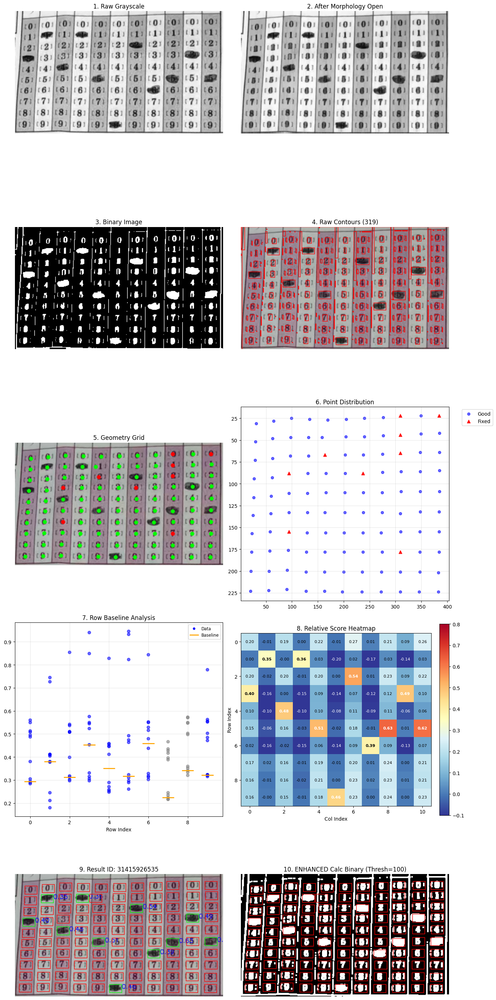

In [154]:
from find_region import process_answer_sheet
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from matplotlib.lines import Line2D

# ==================== 1. 图像预处理 ====================
ans_region, id_region = process_answer_sheet('images/test2.jpg', show=False)
id_region = cv2.resize(id_region, (480, 320))

W_id, H_id = id_region.shape[1], id_region.shape[0]
W_thres_paint, H_thres_paint = 0.85, 0.25
id_region_paint = id_region[int(H_thres_paint*H_id):, :int(W_thres_paint*W_id)]

id_region_gray = cv2.cvtColor(id_region_paint, cv2.COLOR_BGR2GRAY)
kernel_open = np.ones((6, 2), np.uint8)
id_region_opened = cv2.morphologyEx(id_region_gray, cv2.MORPH_OPEN, kernel_open)
_, id_region_binary = cv2.threshold(id_region_opened, 95, 255, cv2.THRESH_BINARY_INV)

id_region_cnts, _ = cv2.findContours(id_region_binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

img_raw_contours = id_region_paint.copy()
for cnt in id_region_cnts:
    x, y, w, h = cv2.boundingRect(cnt)
    cv2.rectangle(img_raw_contours, (x, y), (x + w, y + h), (0, 0, 255), 1)

filtered_cnts_info = []
for cnt in id_region_cnts:
    x, y, w, h = cv2.boundingRect(cnt)
    area = cv2.contourArea(cnt)
    aspect_ratio = w / h
    if area > 5 and area < 400 and 0.1 < aspect_ratio < 10:
        filtered_cnts_info.append({'cnt': cnt, 'x': x, 'y': y, 'w': w, 'h': h, 'cx': x + w // 2, 'cy': y + h // 2})

df = pd.DataFrame([{'cx': info['cx'], 'cy': info['cy'], 'contour': info['cnt']} for info in filtered_cnts_info])

# ==================== 3. 聚类逻辑 ====================
df = df.sort_values('cx').reset_index(drop=True)
x_group_thres = 10
df['group_x_temp'] = 0
current_group = 0
for i in range(len(df)):
    if i > 0 and df.at[i, 'cx'] - df.at[i-1, 'cx'] > x_group_thres: current_group += 1
    df.at[i, 'group_x_temp'] = current_group

def filter_small_groups(df, group_col, min_size=5):
    group_counts = df[group_col].value_counts()
    valid_groups = group_counts[group_counts >= min_size].index.tolist()
    df_filtered = df[df[group_col].isin(valid_groups)].copy()
    group_mapping = {old: new for new, old in enumerate(sorted(valid_groups))}
    new_col = f'{group_col.split("_")[0]}_x' if 'x' in group_col else f'{group_col.split("_")[0]}_y'
    df_filtered[new_col] = df_filtered[group_col].map(group_mapping)
    return df_filtered.drop(columns=[group_col])

df = filter_small_groups(df, 'group_x_temp', min_size=5)

def filter_vertical_in_group(df, cy_threshold=5):
    filtered_rows = []
    for group_id, group_df in df.groupby('group_x'):
        group_df = group_df.sort_values('cy').reset_index(drop=True)
        last_cy = None; keep_indices = []
        for idx, row in group_df.iterrows():
            if last_cy is None or abs(row['cy'] - last_cy) > cy_threshold:
                keep_indices.append(idx); last_cy = row['cy']
        filtered_rows.append(group_df.iloc[keep_indices])
    return pd.concat(filtered_rows, ignore_index=True)

df = filter_vertical_in_group(df, cy_threshold=5)
df = df.sort_values('cy').reset_index(drop=True)
y_group_thres = 10
df['group_y_temp'] = 0
current_group = 0
for i in range(len(df)):
    if i > 0 and df.at[i, 'cy'] - df.at[i-1, 'cy'] > y_group_thres: current_group += 1
    df.at[i, 'group_y_temp'] = current_group
df = filter_small_groups(df, 'group_y_temp', min_size=5)

def filter_horizontal_in_group(df, cx_threshold=5):
    filtered_rows = []
    for group_id, group_df in df.groupby('group_y'):
        group_df = group_df.sort_values('cx').reset_index(drop=True)
        last_cx = None; keep_indices = []
        for idx, row in group_df.iterrows():
            if last_cx is None or abs(row['cx'] - last_cx) > cx_threshold:
                keep_indices.append(idx); last_cx = row['cx']
        filtered_rows.append(group_df.iloc[keep_indices])
    return pd.concat(filtered_rows, ignore_index=True)
df = filter_horizontal_in_group(df, cx_threshold=5)

# ==================== 4.5 智能补全与按需校正 ====================
grid_x_map = df.groupby('group_x')['cx'].median().to_dict()
grid_y_map = df.groupby('group_y')['cy'].median().to_dict()
max_x_idx, max_y_idx = int(df['group_x'].max()), int(df['group_y'].max())
new_rows = []
df['is_original'] = True; df['is_corrected'] = False 
CORRECTION_THRESHOLD = 6.0 
for x_idx in range(max_x_idx + 1):
    for y_idx in range(max_y_idx + 1):
        if x_idx not in grid_x_map or y_idx not in grid_y_map: continue
        ideal_cx, ideal_cy = grid_x_map[x_idx], grid_y_map[y_idx]
        match = df[(df['group_x'] == x_idx) & (df['group_y'] == y_idx)]
        if len(match) > 0:
            original_idx = match.index[0]
            curr_cx, curr_cy = df.at[original_idx, 'cx'], df.at[original_idx, 'cy']
            if abs(curr_cx - ideal_cx) > CORRECTION_THRESHOLD:
                df.at[original_idx, 'cx'] = ideal_cx; df.at[original_idx, 'is_corrected'] = True
            if abs(curr_cy - ideal_cy) > CORRECTION_THRESHOLD:
                df.at[original_idx, 'cy'] = ideal_cy; df.at[original_idx, 'is_corrected'] = True
        else:
            new_rows.append({'cx': ideal_cx, 'cy': ideal_cy, 'contour': None, 'group_x': x_idx, 'group_y': y_idx, 'is_original': False, 'is_corrected': False})
if new_rows: df = pd.concat([df, pd.DataFrame(new_rows)], ignore_index=True)

# ==================== 6. 填涂识别 (笔迹增强逻辑) ====================
# 增强笔迹：灰度腐蚀
kernel_erode = np.ones((3, 3), np.uint8)
id_region_gray_enhanced = cv2.erode(id_region_gray, kernel_erode, iterations=1)

ROI_W, ROI_H = 24, 16
PIXEL_THRESH = 100 
MIN_SCORE_THRESH = 0.3

df['fill_ratio'] = 0.0; df['row_baseline'] = 0.0; df['relative_score'] = 0.0 
df['is_filled'] = False; df['cluster_status'] = 'Normal' 

for idx, row in df.iterrows():
    cx, cy = int(row['cx']), int(row['cy'])
    x1, y1 = max(0, cx - ROI_W // 2), max(0, cy - ROI_H // 2)
    x2, y2 = min(id_region_gray_enhanced.shape[1], cx + ROI_W // 2), min(id_region_gray_enhanced.shape[0], cy + ROI_H // 2)
    roi = id_region_gray_enhanced[y1:y2, x1:x2]
    if roi.size > 0:
        df.at[idx, 'fill_ratio'] = np.count_nonzero(roi < PIXEL_THRESH) / roi.size

sorted_rows = sorted(df['group_y'].unique())
for row_idx in sorted_rows:
    row_data = df[df['group_y'] == row_idx].copy()
    ratios = row_data['fill_ratio'].values.reshape(-1, 1)
    if len(ratios) < 2: baseline = 0
    else:
        kmeans = KMeans(n_clusters=2, random_state=0, n_init=10).fit(ratios)
        centers = kmeans.cluster_centers_.flatten()
        labels = kmeans.labels_
        low_idx = np.argmin(centers)
        baseline = df.loc[row_data.index[labels == low_idx], 'fill_ratio'].median()
        status = 'Normal'
        if max(centers) - min(centers) < 0.2:
             status = 'All_Black' if min(centers) > 0.6 else 'All_White'
    df.loc[df['group_y'] == row_idx, ['row_baseline', 'cluster_status']] = [baseline, status]
    df.loc[df['group_y'] == row_idx, 'relative_score'] = df.loc[df['group_y'] == row_idx, 'fill_ratio'] - baseline

student_id_str = ""
for col_idx in sorted(df['group_x'].unique()):
    col_data = df[df['group_x'] == col_idx]
    if col_data.empty: student_id_str += "?"; continue
    best_match_idx = col_data['relative_score'].idxmax()
    score, abs_ratio, row_status = df.at[best_match_idx, 'relative_score'], df.at[best_match_idx, 'fill_ratio'], df.at[best_match_idx, 'cluster_status']
    is_valid = (abs_ratio > 0.45) if row_status == 'All_Black' else (score > MIN_SCORE_THRESH)
    if is_valid:
        df.at[best_match_idx, 'is_filled'] = True
        student_id_str += str(int(df.at[best_match_idx, 'group_y']))
    else: student_id_str += "?"

# ==================== 7. 全流程可视化 (5行2列) ====================
fig, axes = plt.subplots(5, 2, figsize=(14, 30))
plt.subplots_adjust(wspace=0.2, hspace=0.3)

# 1-4 基础图
axes[0, 0].imshow(id_region_gray, cmap='gray'); axes[0, 0].set_title('1. Raw Grayscale'); axes[0, 0].axis('off')
axes[0, 1].imshow(id_region_opened, cmap='gray'); axes[0, 1].set_title('2. After Morphology Open'); axes[0, 1].axis('off')
axes[1, 0].imshow(id_region_binary, cmap='gray'); axes[1, 0].set_title('3. Binary Image'); axes[1, 0].axis('off')
axes[1, 1].imshow(cv2.cvtColor(img_raw_contours, cv2.COLOR_BGR2RGB)); axes[1, 1].set_title(f'4. Raw Contours ({len(id_region_cnts)})'); axes[1, 1].axis('off')

# 5. 几何网格 (还原颜色逻辑)
img_geo = id_region_paint.copy()
for idx, row in df.iterrows():
    is_orig = row.get('is_original', True)
    is_corr = row.get('is_corrected', False)
    if not is_orig: color = (0, 255, 255) # 黄色补全
    elif is_corr: color = (0, 0, 255)     # 红色校正
    else: color = (0, 255, 0)             # 绿色原始
    cv2.circle(img_geo, (int(row['cx']), int(row['cy'])), 4, color, -1)
    if not is_orig: cv2.circle(img_geo, (int(row['cx']), int(row['cy'])), 8, (0, 255, 255), 1)
axes[2, 0].imshow(cv2.cvtColor(img_geo, cv2.COLOR_BGR2RGB)); axes[2, 0].set_title('5. Geometry Grid'); axes[2, 0].axis('off')

# 6. 点分布 (还原分类标记逻辑)
df_good = df[(df['is_original']==True) & (df['is_corrected']==False)]
df_fixed = df[(df['is_original']==True) & (df['is_corrected']==True)]
df_filled = df[df['is_original']==False]
axes[2, 1].scatter(df_good['cx'], df_good['cy'], alpha=0.6, s=30, c='blue', label='Good')
if not df_fixed.empty: axes[2, 1].scatter(df_fixed['cx'], df_fixed['cy'], alpha=0.9, s=40, c='red', marker='^', label='Fixed')
if not df_filled.empty: axes[2, 1].scatter(df_filled['cx'], df_filled['cy'], alpha=0.9, s=50, c='orange', marker='x', label='Filled')
axes[2, 1].set_title('6. Point Distribution'); axes[2, 1].grid(True, alpha=0.3); axes[2, 1].legend(bbox_to_anchor=(1.05, 1), loc='upper left'); axes[2, 1].set_ylim(axes[2, 1].get_ylim()[::-1])

# 7. 行基准分析 (还原颜色区分逻辑)
colors_plot = df['cluster_status'].map({'Normal': 'blue', 'All_White': 'gray', 'All_Black': 'red'}).fillna('blue')
axes[3, 0].scatter(df['group_y'], df['fill_ratio'], c=colors_plot, alpha=0.6)
for r in sorted_rows:
    base = df[df['group_y']==r]['row_baseline'].iloc[0]
    axes[3, 0].hlines(base, r-0.3, r+0.3, color='orange', lw=2)
legend_el = [Line2D([0], [0], marker='o', color='w', markerfacecolor='blue', label='Data'), Line2D([0], [0], color='orange', lw=2, label='Baseline')]
axes[3, 0].legend(handles=legend_el, loc='upper right', fontsize='small'); axes[3, 0].set_title('7. Row Baseline Analysis'); axes[3, 0].set_xlabel('Row Index'); axes[3, 0].grid(True, alpha=0.3)

# 8. 相对得分热力图 (还原加粗逻辑)
score_matrix = np.zeros((max_y_idx + 1, max_x_idx + 1)); score_matrix[:] = np.nan 
for idx, row in df.iterrows():
    gx, gy = int(row['group_x']), int(row['group_y'])
    if 0 <= gy <= max_y_idx and 0 <= gx <= max_x_idx: score_matrix[gy, gx] = row['relative_score']
im = axes[3, 1].imshow(score_matrix, cmap='RdYlBu_r', vmin=-0.1, vmax=0.8); axes[3, 1].set_title('8. Relative Score Heatmap'); axes[3, 1].set_xlabel('Col Index'); axes[3, 1].set_ylabel('Row Index')
for y in range(score_matrix.shape[0]):
    for x in range(score_matrix.shape[1]):
        val = score_matrix[y, x]
        if not np.isnan(val):
            text_color = "white" if val > 0.4 or val < -0.05 else "black"
            weight = 'bold' if df[(df['group_x']==x) & (df['group_y']==y)]['is_filled'].any() else 'normal'
            axes[3, 1].text(x, y, f"{val:.2f}", ha="center", va="center", color=text_color, fontsize=8, fontweight=weight)
plt.colorbar(im, ax=axes[3, 1], fraction=0.046, pad=0.04)

# 9. OMR 结果
img_omr = id_region_paint.copy()
for idx, row in df.iterrows():
    color = (0, 255, 0) if row['is_filled'] else (0, 0, 255)
    x1, y1 = int(row['cx']-ROI_W//2), int(row['cy']-ROI_H//2)
    x2, y2 = int(row['cx']+ROI_W//2), int(row['cy']+ROI_H//2)
    cv2.rectangle(img_omr, (x1, y1), (x2, y2), color, 1)
    if row['is_filled']: cv2.putText(img_omr, f"{row['relative_score']:.2f}", (x2, int(row['cy'])), cv2.FONT_HERSHEY_SIMPLEX, 0.4, (255, 0, 0), 1)
axes[4, 0].imshow(cv2.cvtColor(img_omr, cv2.COLOR_BGR2RGB)); axes[4, 0].set_title(f'9. Result ID: {student_id_str}'); axes[4, 0].axis('off')

# 10. 加强版二值图
_, enhanced_binary = cv2.threshold(id_region_gray_enhanced, PIXEL_THRESH, 255, cv2.THRESH_BINARY_INV)
img_inspect = cv2.cvtColor(enhanced_binary, cv2.COLOR_GRAY2RGB)
for idx, row in df.iterrows():
    x1, y1 = int(row['cx']-ROI_W//2), int(row['cy']-ROI_H//2)
    x2, y2 = int(row['cx']+ROI_W//2), int(row['cy']+ROI_H//2)
    cv2.rectangle(img_inspect, (x1, y1), (x2, y2), (255, 0, 0), 1)
axes[4, 1].imshow(img_inspect); axes[4, 1].set_title(f'10. ENHANCED Calc Binary (Thresh={PIXEL_THRESH})'); axes[4, 1].axis('off')

plt.tight_layout(); plt.show()


In [182]:
from find_region import process_answer_sheet
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ==================== 1. 图像预处理 ====================
ans_region, id_region = process_answer_sheet('images/test2.jpg', show=False)
ans_region = cv2.resize(ans_region, (820, 680))

W_ans, H_ans = ans_region.shape[1], ans_region.shape[0]
W_thres_mask, H_thres_mask = 0.24, 0.38
ans_region_masked = ans_region.copy()
# 遮掉左下区域
ans_region_masked[int(H_thres_mask*H_ans):, :int(W_thres_mask*W_ans)] = 255

ans_region_gray = cv2.cvtColor(ans_region_masked, cv2.COLOR_BGR2GRAY)
kernel = np.ones((6, 6), np.uint8)
ans_region_opened = cv2.morphologyEx(ans_region_gray, cv2.MORPH_OPEN, kernel)
_, ans_region_binary = cv2.threshold(ans_region_opened, 90, 255, cv2.THRESH_BINARY_INV)

ans_region_cnts, _ = cv2.findContours(ans_region_binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

filtered_cnts_info_ans = []
for cnt in ans_region_cnts:
    x, y, w, h = cv2.boundingRect(cnt)
    area = cv2.contourArea(cnt)
    aspect_ratio = w / h
    # 增加了一些基本的几何过滤
    if area > 10 and area < 300 and 0.1 < aspect_ratio < 5 and h > 5 and h < 15:
        filtered_cnts_info_ans.append({
            'cx': x + w // 2, 'cy': y + h // 2, 
            'x': x, 'y': y, 'w': w, 'h': h, 'area': area
        })

df_ans = pd.DataFrame(filtered_cnts_info_ans)

if df_ans.empty:
    print("未检测到有效轮廓。")
else:
    # ==================== 2. 区域分割 (局部搜索逻辑) ====================
    def neighbor_filter(df, sort_by='cy', delta_threshold=6):
        df_sorted = df.sort_values(sort_by).reset_index(drop=True)
        is_valid = []
        for i in range(len(df_sorted)):
            is_upper = i >= 2 and (df_sorted.at[i, sort_by] - df_sorted.at[i-1, sort_by] < delta_threshold) and (df_sorted.at[i, sort_by] - df_sorted.at[i-2, sort_by] < delta_threshold * 2)
            is_lower = i <= len(df_sorted) - 3 and (df_sorted.at[i+1, sort_by] - df_sorted.at[i, sort_by] < delta_threshold) and (df_sorted.at[i+2, sort_by] - df_sorted.at[i, sort_by] < delta_threshold * 2)
            is_valid.append(is_upper or is_lower)
        return df_sorted[is_valid].copy()

    def find_split_lines_localized(df, sort_by='cy', refs=[], tolerance=50):
        coord_sorted = df[sort_by].sort_values().reset_index(drop=True)
        diffs = []
        for i in range(1, len(coord_sorted)):
            before, after = coord_sorted.iloc[i-1], coord_sorted.iloc[i]
            diffs.append({'mid': (before + after) / 2, 'diff': after - before})
        df_diffs = pd.DataFrame(diffs)
        
        final_splits = []
        for ref in refs:
            local_jumps = df_diffs[(df_diffs['mid'] > ref - tolerance) & (df_diffs['mid'] < ref + tolerance)]
            if not local_jumps.empty:
                best_jump = local_jumps.sort_values('diff', ascending=False).iloc[0]
                final_splits.append(best_jump['mid'])
            else:
                final_splits.append(ref)
        return sorted(final_splits)

    df_filtered = neighbor_filter(df_ans, sort_by='cy')
    df_filtered = neighbor_filter(df_filtered, sort_by='cx')
    
    split_y_refs = [130, 270, 390, 530]
    split_x_refs = [200, 400, 610]
    split_y = find_split_lines_localized(df_filtered, sort_by='cy', refs=split_y_refs)
    split_x = find_split_lines_localized(df_filtered, sort_by='cx', refs=split_x_refs)
    
    def assign_region_id(x, y, sx, sy):
        y_id = sum(1 for line in sy if y > line)
        x_id = sum(1 for line in sx if x > line)
        region_map = {(0,0): 1, (0,1): 2, (0,2): 3, (0,3): 4, (1,0): 5, (1,1): 6, (1,2): 7, (1,3): 8, (2,1): 9, (2,2): 10, (2,3): 11, (3,1): 12, (3,2): 13, (3,3): 14, (4,1): 15, (4,2): 16, (4,3): 17}
        return region_map.get((y_id, x_id), -1)

    df_ans['region'] = df_ans.apply(lambda row: assign_region_id(row['cx'], row['cy'], split_x, split_y), axis=1)
    
    # ==================== 3. 逐个区域网格化 (增强去重与合并逻辑) ====================
    all_regions_df = []      
    clustered_raw_df = []    
    CORRECTION_THRESHOLD = 5.0 

    def process_and_trim_groups(df_region, group_col, coord_col, target_max=5):
        """合并邻近行列并剔除稀疏行列"""
        # 1. 计算当前各组中心
        centers = df_region.groupby(group_col)[coord_col].median().sort_values()
        # 2. 近邻合并逻辑 (阈值 5 像素)
        merge_map = {old: old for old in centers.index}
        for i in range(1, len(centers)):
            if centers.iloc[i] - centers.iloc[i-1] < 5:
                merge_map[centers.index[i]] = merge_map[centers.index[i-1]]
        df_region[group_col] = df_region[group_col].map(merge_map)
        
        # 3. 剔除点数最少的行列 (直到满足 target_max)
        while df_region[group_col].nunique() > target_max:
            counts = df_region[group_col].value_counts()
            worst_group = counts.idxmin() # 找到包含点数最少的组
            df_region = df_region[df_region[group_col] != worst_group]
            
        # 4. 重新连续编号
        unique_sorted = sorted(df_region[group_col].unique())
        df_region[group_col] = df_region[group_col].map({old: new for new, old in enumerate(unique_sorted)})
        return df_region

    for region_id in range(1, 18):
        df_region = df_ans[df_ans['region'] == region_id].copy()
        if len(df_region) < 5: continue
            
        # 初始聚类
        df_region = df_region.sort_values('cx').reset_index(drop=True)
        df_region['group_x'] = (df_region['cx'].diff() > 10).cumsum()
        df_region = df_region.sort_values('cy').reset_index(drop=True)
        df_region['group_y'] = (df_region['cy'].diff() > 10).cumsum()
        
        # 应用合并与裁剪逻辑
        # 区域 1-8 可能是 4列，9-17 可能是 3列，这里统一按 5 列上限处理，或根据需求微调
        df_region = process_and_trim_groups(df_region, 'group_x', 'cx', target_max=5)
        df_region = process_and_trim_groups(df_region, 'group_y', 'cy', target_max=5)
        
        # 网格内去重
        df_region = df_region.sort_values('area', ascending=False).drop_duplicates(subset=['group_x', 'group_y'], keep='first')
        
        df_region['region_id'] = region_id
        clustered_raw_df.append(df_region)

        # 计算理想网格并插值
        grid_x_map = df_region.groupby('group_x')['cx'].median().to_dict()
        grid_y_map = df_region.groupby('group_y')['cy'].median().to_dict()
        
        max_gx, max_gy = int(max(grid_x_map.keys())), int(max(grid_y_map.keys()))

        for gx in range(max_gx + 1):
            for gy in range(max_gy + 1):
                if gx not in grid_x_map or gy not in grid_y_map: continue
                ideal_cx, ideal_cy = grid_x_map[gx], grid_y_map[gy]
                match = df_region[(df_region['group_x'] == gx) & (df_region['group_y'] == gy)]
                
                if len(match) > 0:
                    ccx, ccy = match.iloc[0]['cx'], match.iloc[0]['cy']
                    final_cx, final_cy, status = ccx, ccy, 'Original'
                    if abs(ccx-ideal_cx) > CORRECTION_THRESHOLD: final_cx = ideal_cx; status = 'Corrected'
                    if abs(ccy-ideal_cy) > CORRECTION_THRESHOLD: final_cy = ideal_cy; status = 'Corrected'
                    all_regions_df.append({'cx': final_cx, 'cy': final_cy, 'status': status})
                else:
                    all_regions_df.append({'cx': ideal_cx, 'cy': ideal_cy, 'status': 'Filled'})
        
    df_final_grid = pd.DataFrame(all_regions_df)
    df_clustered_raw = pd.concat(clustered_raw_df, ignore_index=True)
    
    # ==================== 4. 可视化 (4行2列) ====================
    fig, axes = plt.subplots(4, 2, figsize=(16, 24))

    # 1. 滤波
    axes[0, 0].scatter(df_ans['cx'], df_ans['cy'], c='gray', s=10); axes[0, 0].invert_yaxis(); axes[0, 0].set_title('1. Points Filtering')

    # 2. 分割线
    axes[0, 1].scatter(df_filtered['cx'], df_filtered['cy'], c='blue', s=10)
    for y_line in split_y: axes[0, 1].axhline(y_line, color='red', linestyle='--')
    for x_line in split_x: axes[0, 1].axvline(x_line, color='green', linestyle='--')
    axes[0, 1].set_title('2. Localized Split Lines'); axes[0, 1].invert_yaxis()

    # 3. 原图轮廓矩形框
    img_v = ans_region_masked.copy()
    for _, row in df_ans.iterrows():
        cv2.rectangle(img_v, (int(row['x']), int(row['y'])), (int(row['x']+row['w']), int(row['y']+row['h'])), (0, 0, 255), 1)
    for y_l in split_y: cv2.line(img_v, (0, int(y_l)), (W_ans, int(y_l)), (255, 0, 0), 2)
    for x_l in split_x: cv2.line(img_v, (int(x_l), 0), (int(x_l), H_ans), (0, 255, 0), 2)
    axes[1, 0].imshow(cv2.cvtColor(img_v, cv2.COLOR_BGR2RGB)); axes[1, 0].set_title('3. Raw Contours & Split Lines'); axes[1, 0].axis('off')

    # 4. 最终网格红点
    img_labeled = ans_region_masked.copy()
    for _, row in df_final_grid.iterrows():
        cv2.circle(img_labeled, (int(row['cx']), int(row['cy'])), 3, (0, 0, 255), -1)
    axes[1, 1].imshow(cv2.cvtColor(img_labeled, cv2.COLOR_BGR2RGB)); axes[1, 1].set_title('4. Final Grid Points'); axes[1, 1].axis('off')

    # 5. 聚类原始点 (带 gx, gy) - 展示合并与剔除后的结果
    axes[2, 0].scatter(df_clustered_raw['cx'], df_clustered_raw['cy'], c='purple', s=20, alpha=0.5)
    for _, row in df_clustered_raw.iterrows():
        axes[2, 0].text(row['cx']+2, row['cy']+2, f"({int(row['group_x'])},{int(row['group_y'])})", fontsize=6)
    axes[2, 0].set_title('5. Cleaned Clustered Points (gx, gy)'); axes[2, 0].invert_yaxis()

    # 6. 网格状态分布
    colors = {'Original': 'green', 'Corrected': 'red', 'Filled': 'orange'}
    markers = {'Original': '.', 'Corrected': '^', 'Filled': 'x'}
    for status, group_df in df_final_grid.groupby('status'):
        axes[2, 1].scatter(group_df['cx'], group_df['cy'], s=30, c=colors[status], marker=markers[status], label=status)
    axes[2, 1].set_title('6. Grid Status Distribution'); axes[2, 1].legend(loc='upper right'); axes[2, 1].invert_yaxis()

    axes[3, 0].axis('off'); axes[3, 1].axis('off')
    for ax in [axes[0,0], axes[0,1], axes[2,0], axes[2,1]]:
        ax.set_xlabel('CX'); ax.set_ylabel('CY'); ax.grid(True, alpha=0.3)

    plt.tight_layout(); plt.show()


ValueError: too many values to unpack (expected 2)

In [184]:
from find_region import process_answer_sheet
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from matplotlib.lines import Line2D

# ==================== 1. 图像预处理 ====================
ans_region, id_region = process_answer_sheet('images/test4.jpg', show=False)
id_region = cv2.resize(id_region, (480, 320))

W_id, H_id = id_region.shape[1], id_region.shape[0]
W_thres_paint, H_thres_paint = 0.85, 0.25
id_region_paint = id_region[int(H_thres_paint*H_id):, :int(W_thres_paint*W_id)]

id_region_gray = cv2.cvtColor(id_region_paint, cv2.COLOR_BGR2GRAY)
kernel = np.ones((6, 2), np.uint8)
id_region_opened = cv2.morphologyEx(id_region_gray, cv2.MORPH_OPEN, kernel)
_, id_region_binary = cv2.threshold(id_region_opened, 80, 255, cv2.THRESH_BINARY_INV)

id_region_cnts, _ = cv2.findContours(id_region_binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

img_raw_contours = id_region_paint.copy()
for cnt in id_region_cnts:
    x, y, w, h = cv2.boundingRect(cnt)
    cv2.rectangle(img_raw_contours, (x, y), (x + w, y + h), (0, 0, 255), 1)

filtered_cnts_info = []
for cnt in id_region_cnts:
    x, y, w, h = cv2.boundingRect(cnt)
    area = cv2.contourArea(cnt)
    aspect_ratio = w / h
    if area > 5 and area < 400 and 0.1 < aspect_ratio < 10:
        filtered_cnts_info.append({'cnt': cnt, 'x': x, 'y': y, 'w': w, 'h': h, 'cx': x + w // 2, 'cy': y + h // 2})

df = pd.DataFrame(filtered_cnts_info)

# ==================== 3. 基础聚类 (用于计算步长) ====================
# 这里的聚类只是为了找到“现有的”行列线
df = df.sort_values('cx').reset_index(drop=True)
df['group_x_temp'] = (df['cx'].diff() > 10).cumsum()
df = df.sort_values('cy').reset_index(drop=True)
df['group_y_temp'] = (df['cy'].diff() > 10).cumsum()

# ==================== 4.5 完善的插值与校正逻辑 (针对10行11列) ====================
EXPECTED_COLS = 11
EXPECTED_ROWS = 10

# 1. 计算现有行列的平均坐标
existing_x = df.groupby('group_x_temp')['cx'].median().sort_values().values
existing_y = df.groupby('group_y_temp')['cy'].median().sort_values().values

# 2. 推断步长 (使用中位数差值，防止异常间距干扰)
if len(existing_x) >= 2:
    stride_x = np.median(np.diff(existing_x))
else:
    stride_x = 30 # 默认兜底值
    
if len(existing_y) >= 2:
    stride_y = np.median(np.diff(existing_y))
else:
    stride_y = 22 # 默认兜底值

# 3. 确定网格锚点 (假设检测到的第一个点大概率是靠前的索引)
# 我们通过计算每个点相对于最小坐标的偏移量，来确定它的逻辑索引 (0~10, 0~9)
# 这一步可以自动修正“第一列完全缺失”的情况
min_x, min_y = existing_x[0], existing_y[0]

# 重新计算每个点所属的逻辑行列
df['logical_x'] = np.round((df['cx'] - min_x) / stride_x).astype(int)
df['logical_y'] = np.round((df['cy'] - min_y) / stride_y).astype(int)

# 归一化逻辑索引（防止出现负数，如果min_x不是真正的第一列）
x_offset = df['logical_x'].min()
y_offset = df['logical_y'].min()
df['logical_x'] -= x_offset
df['logical_y'] -= y_offset

# 4. 构建理想网格坐标映射表
# 基于现有的点和推断的步长，重建整张表的基准线
base_x = min_x - (x_offset * stride_x)
base_y = min_y - (y_offset * stride_y)

grid_x_map = {i: base_x + i * stride_x for i in range(EXPECTED_COLS)}
grid_y_map = {j: base_y + j * stride_y for j in range(EXPECTED_ROWS)}

# 5. 遍历理想网格进行补全和校正
final_points = []
CORRECTION_THRESHOLD = 7.0

for i in range(EXPECTED_COLS):
    for j in range(EXPECTED_ROWS):
        ideal_cx = grid_x_map[i]
        ideal_cy = grid_y_map[j]
        
        # 查找逻辑索引匹配的点
        match = df[(df['logical_x'] == i) & (df['logical_y'] == j)]
        
        if len(match) > 0:
            # 点存在
            original_idx = match.index[0]
            curr_cx, curr_cy = df.at[original_idx, 'cx'], df.at[original_idx, 'cy']
            
            status = 'Original'
            final_cx, final_cy = curr_cx, curr_cy
            
            # 按需校正
            if abs(curr_cx - ideal_cx) > CORRECTION_THRESHOLD:
                final_cx = ideal_cx
                status = 'Corrected'
            if abs(curr_cy - ideal_cy) > CORRECTION_THRESHOLD:
                final_cy = ideal_cy
                status = 'Corrected'
                
            final_points.append({
                'cx': final_cx, 'cy': final_cy, 'group_x': i, 'group_y': j,
                'status': status, 'is_filled': False
            })
        else:
            # 列或点缺失，进行插值补全
            final_points.append({
                'cx': ideal_cx, 'cy': ideal_cy, 'group_x': i, 'group_y': j,
                'status': 'Filled', 'is_filled': False
            })

df_final = pd.DataFrame(final_points)

# ==================== 6. 填涂识别 (逻辑保持不变) ====================
ROI_W, ROI_H = 20, 14
PIXEL_THRESH, MIN_SCORE_THRESH = 80, 0.15

# 计算 fill_ratio 和 baseline
df_final['fill_ratio'] = 0.0
for idx, row in df_final.iterrows():
    cx, cy = int(row['cx']), int(row['cy'])
    x1, y1 = max(0, cx - ROI_W//2), max(0, cy - ROI_H//2)
    x2, y2 = min(id_region_gray.shape[1], cx + ROI_W//2), min(id_region_gray.shape[0], cy + ROI_H//2)
    roi = id_region_gray[y1:y2, x1:x2]
    if roi.size > 0:
        df_final.at[idx, 'fill_ratio'] = np.count_nonzero(roi < PIXEL_THRESH) / roi.size

df_final['row_baseline'] = 0.0
df_final['cluster_status'] = 'Normal'
df_final['relative_score'] = 0.0

for row_idx in range(EXPECTED_ROWS):
    row_data = df_final[df_final['group_y'] == row_idx]
    ratios = row_data['fill_ratio'].values.reshape(-1, 1)
    kmeans = KMeans(n_clusters=2, random_state=0, n_init=10).fit(ratios)
    centers = np.sort(kmeans.cluster_centers_.flatten())
    
    if (centers[1] - centers[0]) < 0.2:
        status = 'All_Black' if centers[0] > 0.6 else 'All_White'
        baseline = 0.0 if status == 'All_Black' else np.median(row_data['fill_ratio'])
    else:
        status = 'Normal'
        baseline = row_data[row_data['fill_ratio'] < (centers[0]+centers[1])/2]['fill_ratio'].median()
    
    df_final.loc[df_final['group_y'] == row_idx, 'row_baseline'] = baseline
    df_final.loc[df_final['group_y'] == row_idx, 'cluster_status'] = status
    df_final.loc[df_final['group_y'] == row_idx, 'relative_score'] = row_data['fill_ratio'] - baseline

# 读取学号
student_id_str = ""
for col_idx in range(EXPECTED_COLS):
    col_data = df_final[df_final['group_x'] == col_idx]
    best_idx = col_data['relative_score'].idxmax()
    row_status = df_final.at[best_idx, 'cluster_status']
    score = df_final.at[best_idx, 'relative_score']
    
    match_found = (score > 0.4) if row_status == 'All_Black' else (score > MIN_SCORE_THRESH)
    if match_found:
        df_final.at[best_idx, 'is_filled'] = True
        student_id_str += str(int(df_final.at[best_idx, 'group_y']))
    else:
        student_id_str += "?"

print(f"识别学号: {student_id_str}")

# ==================== 7. 可视化展示 (保持5行2列布局) ====================
fig, axes = plt.subplots(5, 2, figsize=(14, 30))
plt.subplots_adjust(wspace=0.2, hspace=0.3)

# 1-4 原样展示
axes[0, 0].imshow(cv2.cvtColor(id_region_paint, cv2.COLOR_BGR2RGB)); axes[0, 0].set_title('1. Raw ROI')
axes[0, 1].imshow(id_region_gray, cmap='gray'); axes[0, 1].set_title('2. After Morphology Open')
axes[1, 0].imshow(id_region_binary, cmap='gray'); axes[1, 0].set_title('3. Binary Image')
axes[1, 1].imshow(cv2.cvtColor(img_raw_contours, cv2.COLOR_BGR2RGB)); axes[1, 1].set_title('4. Unfiltered Contours')

# 5. 几何网格 (展示补全效果)
img_geo = id_region_paint.copy()
colors = {'Original': (0, 255, 0), 'Corrected': (0, 0, 255), 'Filled': (0, 255, 255)}
for _, row in df_final.iterrows():
    cv2.circle(img_geo, (int(row['cx']), int(row['cy'])), 4, colors[row['status']], -1)
axes[2, 0].imshow(cv2.cvtColor(img_geo, cv2.COLOR_BGR2RGB)); axes[2, 0].set_title('5. Corrected & Filled Grid (11x10)')

# 6. 点分布
for status, color in zip(['Original', 'Corrected', 'Filled'], ['green', 'red', 'orange']):
    curr = df_final[df_final['status'] == status]
    axes[2, 1].scatter(curr['cx'], curr['cy'], c=color, label=status, s=30)
axes[2, 1].invert_yaxis(); axes[2, 1].legend(); axes[2, 1].set_title('6. Grid Status Distribution')

# 7. Baseline
colors_map = {'Normal': 'blue', 'All_White': 'gray', 'All_Black': 'red'}
for s, c in colors_map.items():
    curr = df_final[df_final['cluster_status'] == s]
    axes[3, 0].scatter(curr['group_y'], curr['fill_ratio'], c=c, alpha=0.5)
for r in range(EXPECTED_ROWS):
    b = df_final[df_final['group_y']==r]['row_baseline'].iloc[0]
    axes[3, 0].hlines(b, r-0.3, r+0.3, color='orange', lw=2)
axes[3, 0].set_title('7. Row Baseline Analysis')

# 8. Heatmap
score_matrix = df_final.pivot(index='group_y', columns='group_x', values='relative_score').values
im = axes[3, 1].imshow(score_matrix, cmap='RdYlBu_r', vmin=-0.1, vmax=0.8)
for y in range(EXPECTED_ROWS):
    for x in range(EXPECTED_COLS):
        val = score_matrix[y, x]
        is_f = df_final[(df_final['group_x']==x) & (df_final['group_y']==y)]['is_filled'].values[0]
        axes[3, 1].text(x, y, f"{val:.2f}", ha="center", va="center", color="white" if val>0.4 else "black", weight='bold' if is_f else 'normal', fontsize=7)
plt.colorbar(im, ax=axes[3, 1]); axes[3, 1].set_title('8. Relative Score Heatmap')

# 9. Final OMR
img_res = id_region_paint.copy()
for _, row in df_final.iterrows():
    color = (0, 255, 0) if row['is_filled'] else (0, 0, 255)
    cv2.rectangle(img_res, (int(row['cx']-10), int(row['cy']-7)), (int(row['cx']+10), int(row['cy']+7)), color, 2 if row['is_filled'] else 1)
axes[4, 0].imshow(cv2.cvtColor(img_res, cv2.COLOR_BGR2RGB)); axes[4, 0].set_title(f'9. Final Result: {student_id_str}')
axes[4, 1].axis('off')

for ax in axes.flatten():
    if not ax.get_title().startswith(('7','8')): ax.axis('off')

plt.tight_layout(); plt.show()


ValueError: too many values to unpack (expected 2)

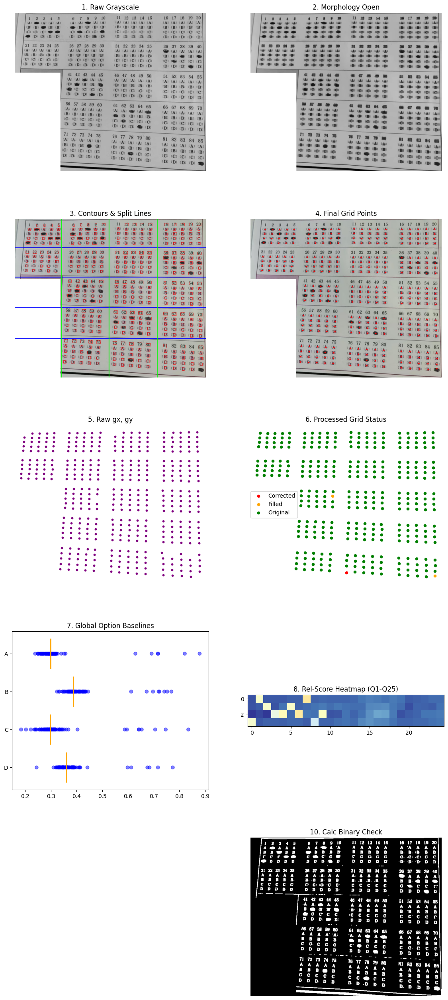

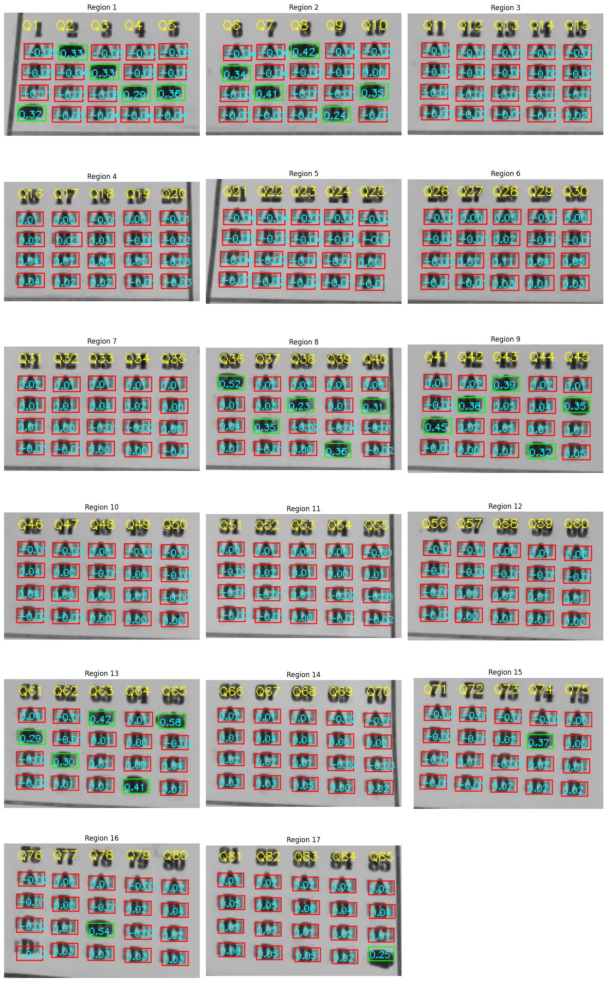


      FINAL OMR RESULTS (1-85)
Q1:D | Q2:A | Q3:B | Q4:C | Q5:C
Q6:B | Q7:C | Q8:A | Q9:D | Q10:C
Q11:_ | Q12:_ | Q13:_ | Q14:_ | Q15:_
Q16:_ | Q17:_ | Q18:_ | Q19:_ | Q20:_
Q21:_ | Q22:_ | Q23:_ | Q24:_ | Q25:_
Q26:_ | Q27:_ | Q28:_ | Q29:_ | Q30:_
Q31:_ | Q32:_ | Q33:_ | Q34:_ | Q35:_
Q36:A | Q37:C | Q38:B | Q39:D | Q40:B
Q41:C | Q42:B | Q43:A | Q44:D | Q45:B
Q46:_ | Q47:_ | Q48:_ | Q49:_ | Q50:_
Q51:_ | Q52:_ | Q53:_ | Q54:_ | Q55:_
Q56:_ | Q57:_ | Q58:_ | Q59:_ | Q60:_
Q61:B | Q62:C | Q63:A | Q64:D | Q65:A
Q66:_ | Q67:_ | Q68:_ | Q69:_ | Q70:_
Q71:_ | Q72:_ | Q73:_ | Q74:B | Q75:_
Q76:_ | Q77:_ | Q78:C | Q79:_ | Q80:_
Q81:_ | Q82:_ | Q83:_ | Q84:_ | Q85:D


In [161]:
from find_region import process_answer_sheet
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from matplotlib.lines import Line2D

# ==================== 1. 图像预处理 ====================
ans_region, id_region = process_answer_sheet('images/test2.jpg', show=False)
ans_region = cv2.resize(ans_region, (820, 680))

W_ans, H_ans = ans_region.shape[1], ans_region.shape[0]
W_thres_mask, H_thres_mask = 0.24, 0.38
ans_region_masked = ans_region.copy()
ans_region_masked[int(H_thres_mask*H_ans):, :int(W_thres_mask*W_ans)] = 255

ans_region_gray = cv2.cvtColor(ans_region_masked, cv2.COLOR_BGR2GRAY)
kernel_erode = np.ones((3, 3), np.uint8)
ans_region_gray_eroded = cv2.erode(ans_region_gray, kernel_erode, iterations=1)

kernel = np.ones((6, 6), np.uint8)
ans_region_opened = cv2.morphologyEx(ans_region_gray, cv2.MORPH_OPEN, kernel)
_, ans_region_binary = cv2.threshold(ans_region_opened, 90, 255, cv2.THRESH_BINARY_INV)

ans_region_cnts, _ = cv2.findContours(ans_region_binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

filtered_cnts_info_ans = []
for cnt in ans_region_cnts:
    x, y, w, h = cv2.boundingRect(cnt)
    if 10 < cv2.contourArea(cnt) < 300 and 5 < h < 15:
        filtered_cnts_info_ans.append({'cx': x + w // 2, 'cy': y + h // 2, 'x': x, 'y': y, 'w': w, 'h': h, 'area': cv2.contourArea(cnt)})

df_ans = pd.DataFrame(filtered_cnts_info_ans)

if df_ans.empty:
    print("未检测到有效轮廓。")
else:
    # ==================== 2. 区域分割 ====================
    def neighbor_filter(df, sort_by='cy', delta=6):
        ds = df.sort_values(sort_by).reset_index(drop=True)
        v = [(i>=2 and ds.at[i,sort_by]-ds.at[i-1,sort_by]<delta) or (i<=len(ds)-3 and ds.at[i+1,sort_by]-ds.at[i,sort_by]<delta) for i in range(len(ds))]
        return ds[v].copy()

    def find_splits(df, sort_by, refs):
        ds = df[sort_by].sort_values().reset_index(drop=True)
        diffs = [{'mid':(ds[i-1]+ds[i])/2, 'd':ds[i]-ds[i-1]} for i in range(1, len(ds))]
        df_d = pd.DataFrame(diffs)
        res = []
        for r in refs:
            local = df_d[(df_d['mid']>r-50) & (df_d['mid']<r+50)]
            res.append(local.sort_values('d', ascending=False).iloc[0]['mid'] if not local.empty else r)
        return sorted(res)

    df_filt = neighbor_filter(neighbor_filter(df_ans, 'cy'), 'cx')
    split_y = find_splits(df_filt, 'cy', [130, 270, 390, 530])
    split_x = find_splits(df_filt, 'cx', [200, 400, 610])
    
    def assign_ids(x, y, sx, sy):
        return sum(1 for l in sy if y > l), sum(1 for l in sx if x > l)

    df_ans['sy'] = df_ans.apply(lambda r: assign_ids(r['cx'], r['cy'], split_x, split_y)[0], axis=1)
    df_ans['sx'] = df_ans.apply(lambda r: assign_ids(r['cx'], r['cy'], split_x, split_y)[1], axis=1)
    rmap = {(0,0):1,(0,1):2,(0,2):3,(0,3):4,(1,0):5,(1,1):6,(1,2):7,(1,3):8,(2,1):9,(2,2):10,(2,3):11,(3,1):12,(3,2):13,(3,3):14,(4,1):15,(4,2):16,(4,3):17}
    df_ans['region'] = df_ans.apply(lambda r: rmap.get((r['sy'], r['sx']), -1), axis=1)

    # ==================== 3. 逐区域网格化 + 绝对占比采集 ====================
    all_points_collection = []
    clustered_raw_df_list = []
    ROI_W, ROI_H, PIXEL_THRESH = 26, 14, 100
    CORRECTION_THRESHOLD = 5.0

    def process_and_trim_groups(df_region, group_col, coord_col, target_max=5):
        centers = df_region.groupby(group_col)[coord_col].median().sort_values()
        merge_map = {old: old for old in centers.index}
        for i in range(1, len(centers)):
            if centers.iloc[i] - centers.iloc[i-1] < 5: merge_map[centers.index[i]] = merge_map[centers.index[i-1]]
        df_region[group_col] = df_region[group_col].map(merge_map)
        while df_region[group_col].nunique() > target_max:
            df_region = df_region[df_region[group_col] != df_region[group_col].value_counts().idxmin()]
        unique_sorted = sorted(df_region[group_col].unique())
        df_region[group_col] = df_region[group_col].map({old: new for new, old in enumerate(unique_sorted)})
        return df_region

    for rid in range(1, 18):
        df_r = df_ans[df_ans['region'] == rid].copy()
        if len(df_r) < 5: continue
        
        # 聚类
        df_r = df_r.sort_values('cx').reset_index(drop=True)
        df_r['group_x'] = (df_r['cx'].diff() > 10).cumsum()
        df_r = df_r.sort_values('cy').reset_index(drop=True)
        df_r['group_y'] = (df_r['cy'].diff() > 8).cumsum()
        
        # Trim
        df_r = process_and_trim_groups(df_r, 'group_x', 'cx', 5)
        df_r = process_and_trim_groups(df_r, 'group_y', 'cy', 6)
        df_r = df_r.sort_values('area', ascending=False).drop_duplicates(subset=['group_x', 'group_y'], keep='first')
        clustered_raw_df_list.append(df_r.assign(region_id=rid))

        grid_x_map = df_r.groupby('group_x')['cx'].median().to_dict()
        grid_y_map = df_r.groupby('group_y')['cy'].median().to_dict()
        valid_gy_indices = sorted(grid_y_map.keys())[-4:] # A-D

        for gx in sorted(grid_x_map.keys()):
            # 提前计算 q_id
            q_id = (rid - 1) * 5 + gx + 1
            for opt_idx, gy in enumerate(valid_gy_indices):
                ideal_cx, ideal_cy = grid_x_map[gx], grid_y_map[gy]
                match = df_r[(df_r['group_x'] == gx) & (df_r['group_y'] == gy)]
                
                final_cx, final_cy, status = ideal_cx, ideal_cy, 'Filled'
                if not match.empty:
                    ccx, ccy = match.iloc[0]['cx'], match.iloc[0]['cy']
                    final_cx, final_cy, status = ccx, ccy, 'Original'
                    if abs(ccx-ideal_cx) > CORRECTION_THRESHOLD or abs(ccy-ideal_cy) > CORRECTION_THRESHOLD:
                        final_cx, final_cy, status = ideal_cx, ideal_cy, 'Corrected'
                
                roi = ans_region_gray_eroded[max(0,int(final_cy-ROI_H//2)):int(final_cy+ROI_H//2), max(0,int(final_cx-ROI_W//2)):int(final_cx+ROI_W//2)]
                abs_ratio = np.count_nonzero(roi < PIXEL_THRESH) / roi.size if roi.size > 0 else 0
                
                # 存入 q_id
                all_points_collection.append({
                    'cx':final_cx, 'cy':final_cy, 'status':status, 'abs_ratio':abs_ratio, 
                    'region':rid, 'opt_idx':opt_idx, 'q_gx':gx, 'q_id': q_id
                })

    df_final_grid = pd.DataFrame(all_points_collection)

    # ==================== 4. 全局跨区域行聚类 ====================
    df_final_grid['baseline'] = 0.0
    df_final_grid['rel_score'] = 0.0
    df_final_grid['cluster_status'] = 'Normal'

    for opt in range(4):
        opt_data = df_final_grid[df_final_grid['opt_idx'] == opt]
        ratios = opt_data['abs_ratio'].values.reshape(-1, 1)
        kmeans = KMeans(n_clusters=2, random_state=0, n_init=10).fit(ratios)
        centers = np.sort(kmeans.cluster_centers_.flatten())
        low_idx = np.argmin(kmeans.cluster_centers_.flatten())
        
        baseline = opt_data.iloc[kmeans.labels_ == low_idx]['abs_ratio'].median()
        status = 'Normal'
        if centers[1] - centers[0] < 0.2:
            status = 'All_Black' if centers[0] > 0.6 else 'All_White'
            baseline = 0.0 if status == 'All_Black' else np.median(ratios)
            
        df_final_grid.loc[opt_data.index, ['baseline','cluster_status']] = [baseline, status]
        df_final_grid.loc[opt_data.index, 'rel_score'] = opt_data['abs_ratio'] - baseline

    # ==================== 5. 判定与可视化结果准备 ====================
    REL_JUDGE_THRESH = 0.2
    final_results = []
    region_images = {}

    for rid in range(1, 18):
        df_r = df_final_grid[df_final_grid['region'] == rid]
        if df_r.empty: continue
        
        # 准备裁剪图
        y_min, y_max = int(df_r['cy'].min()-35), int(df_r['cy'].max()+20)
        x_min, x_max = int(df_r['cx'].min()-25), int(df_r['cx'].max()+25)
        crop_img = cv2.cvtColor(ans_region_gray_eroded[max(0,y_min):y_max, max(0,x_min):x_max], cv2.COLOR_GRAY2RGB)

        for q_id in sorted(df_r['q_id'].unique()):
            q_data = df_r[df_r['q_id'] == q_id].sort_values('opt_idx')
            q_ans = []
            
            lx_q = int(q_data['cx'].median() - x_min)
            cv2.putText(crop_img, f"Q{int(q_id)}", (lx_q-12, 15), cv2.FONT_HERSHEY_SIMPLEX, 0.4, (255, 255, 0), 1)

            for _, row in q_data.iterrows():
                is_filled = (row['abs_ratio'] > 0.45) if row['cluster_status'] == 'All_Black' else (row['rel_score'] > REL_JUDGE_THRESH)
                if is_filled: q_ans.append(chr(ord('A') + int(row['opt_idx'])))
                
                box_color = (0, 255, 0) if is_filled else (255, 0, 0)
                local_x, local_y = int(row['cx'] - x_min), int(row['cy'] - y_min)
                cv2.rectangle(crop_img, (local_x-ROI_W//2, local_y-ROI_H//2), (local_x+ROI_W//2, local_y+ROI_H//2), box_color, 1)
                cv2.putText(crop_img, f"{row['rel_score']:.2f}", (local_x-12, local_y+4), cv2.FONT_HERSHEY_SIMPLEX, 0.3, (0, 255, 255), 1)
            
            final_results.append({'Q': q_id, 'Ans': "".join(q_ans)})
        region_images[rid] = crop_img

    # ==================== 6. 可视化展示 ====================
    fig, axes = plt.subplots(5, 2, figsize=(14, 32))
    plt.subplots_adjust(wspace=0.2, hspace=0.3)
    
    axes[0,0].imshow(ans_region_gray, cmap='gray'); axes[0,0].set_title('1. Raw Grayscale')
    axes[0,1].imshow(ans_region_opened, cmap='gray'); axes[0,1].set_title('2. Morphology Open')
    
    img_v = ans_region_masked.copy()
    for _, r in df_ans.iterrows(): cv2.rectangle(img_v, (int(r['x']), int(r['y'])), (int(r['x']+r['w']), int(r['y']+r['h'])), (0,0,255), 1)
    for y_l in split_y: cv2.line(img_v, (0, int(y_l)), (W_ans, int(y_l)), (255,0,0), 2)
    for x_l in split_x: cv2.line(img_v, (int(x_l), 0), (int(x_l), H_ans), (0,255,0), 2)
    axes[1,0].imshow(cv2.cvtColor(img_v, cv2.COLOR_BGR2RGB)); axes[1,0].set_title('3. Contours & Split Lines')

    img_f = ans_region_masked.copy()
    for _, r in df_final_grid.iterrows(): cv2.circle(img_f, (int(r['cx']), int(r['cy'])), 3, (0, 0, 255), -1)
    axes[1,1].imshow(cv2.cvtColor(img_f, cv2.COLOR_BGR2RGB)); axes[1,1].set_title('4. Final Grid Points')

    df_raw_all = pd.concat(clustered_raw_df_list)
    axes[2,0].scatter(df_raw_all['cx'], df_raw_all['cy'], c='purple', s=10); axes[2,0].invert_yaxis(); axes[2,0].set_title('5. Raw gx, gy')
    
    c_map = {'Original': 'green', 'Corrected': 'red', 'Filled': 'orange'}
    for st, g in df_final_grid.groupby('status'):
        axes[2,1].scatter(g['cx'], g['cy'], c=c_map[st], label=st, s=20); axes[2,1].invert_yaxis()
    axes[2,1].legend(); axes[2,1].set_title('6. Processed Grid Status')

    # 图 7: 全局 A-D Baseline
    colors_p = df_final_grid['cluster_status'].map({'Normal':'blue','All_White':'gray','All_Black':'red'}).fillna('blue')
    axes[3,0].scatter(df_final_grid['abs_ratio'], df_final_grid['opt_idx'], c=colors_p, alpha=0.5)
    for opt in range(4):
        b = df_final_grid[df_final_grid['opt_idx']==opt]['baseline'].iloc[0]
        axes[3,0].vlines(b, opt-0.4, opt+0.4, color='orange', lw=2)
    axes[3,0].set_yticks(range(4)); axes[3,0].set_yticklabels(['A','B','C','D']); axes[3,0].invert_yaxis(); axes[3,0].set_title('7. Global Option Baselines')

    # 图 8: 修复后的热力图 (取前 25 题预览)
    score_mat = df_final_grid[df_final_grid['q_id'] <= 25].pivot_table(index='opt_idx', columns='q_id', values='rel_score').values
    axes[3,1].imshow(score_mat, cmap='RdYlBu_r', vmin=-0.1, vmax=0.8); axes[3,1].set_title('8. Rel-Score Heatmap (Q1-Q25)')

    # 图 10: 二值图
    _, real_b = cv2.threshold(ans_region_gray_eroded, 100, 255, cv2.THRESH_BINARY_INV)
    axes[4,1].imshow(real_b, cmap='gray'); axes[4,1].set_title('10. Calc Binary Check')
    
    for ax in [axes[0,0], axes[0,1], axes[1,0], axes[1,1], axes[2,0], axes[2,1], axes[4,0], axes[4,1]]: ax.axis('off')
    plt.show()

    # ==================== 7. 17 区域详情大图 ====================
    fig2, axes2 = plt.subplots(6, 3, figsize=(15, 25))
    axes2 = axes2.flatten()
    for i in range(1, 18):
        if i in region_images:
            axes2[i-1].imshow(region_images[i])
            axes2[i-1].set_title(f'Region {i}')
        axes2[i-1].axis('off')
    axes2[17].axis('off'); plt.tight_layout(); plt.show()

    # ==================== 8. 答案统计输出 ====================
    print("\n" + "="*40 + "\n      FINAL OMR RESULTS (1-85)\n" + "="*40)
    for i in range(0, len(final_results), 5):
        chunk = final_results[i:i+5]
        print(" | ".join([f"Q{int(r['Q'])}:{r['Ans'] if r['Ans'] else '_'}" for r in chunk]))


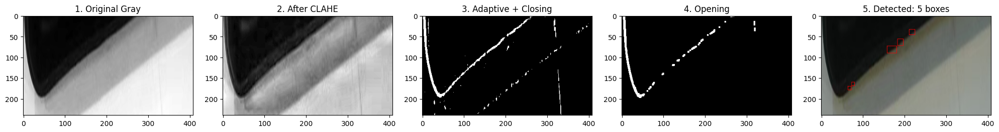

实验报告: 按照当前参数，系统在区域内抓取到 5 个符合条件的轮廓。


In [55]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from find_region import process_answer_sheet


# ==================== 1. 实验参数配置区 ====================
# 你可以在这里调整参数，观察下方图像的变化
EXPERIMENTAL_PARAMS = {
    'clahe_clip': 2.5,        # 对比度限制，越高笔迹越黑，但噪点也会增加
    'clahe_grid': (8, 8),     # 局部窗口大小
    'adaptive_block': 31,     # 自适应阈值窗口(必须为奇数)，越大越看整体，越小越看局部细节
    'adaptive_C': 12,         # 从均值中减去的常数，越大则二值化越“干净”，但会抹去浅色笔迹
    'morph_kernel': (3, 3),   # 闭运算核大小，用于连接断裂的数字笔画
    'min_area': 30,           # 过滤轮廓的最小面积
    'max_area': 800         # 过滤轮廓的最大面积
}

# ==================== 2. 核心处理流程 ====================
def experiment_preprocess(img_path):
    # 独立测试逻辑
    _, img, _ = process_answer_sheet('images/test13.jpg', show=False)
    # 读取并裁剪ROI (模拟你的 Step2 逻辑)
    img = cv2.resize(img, (480, 320))
    h, w = img.shape[:2]
    roi = img[int(0.25*h):, :int(0.85*w)]
    gray = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    
    # --- 步骤 A: 局部对比度增强 (CLAHE) ---
    clahe = cv2.createCLAHE(clipLimit=EXPERIMENTAL_PARAMS['clahe_clip'], 
                            tileGridSize=EXPERIMENTAL_PARAMS['clahe_grid'])
    gray_enhanced = clahe.apply(gray)
    
    # --- 步骤 B: 自适应阈值 (Adaptive Thresholding) ---
    # 使用 GAUSSIAN_C 效果通常比 MEAN_C 更平滑，边缘更完整
    binary = cv2.adaptiveThreshold(gray_enhanced, 255, 
                                   cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                                   cv2.THRESH_BINARY_INV, 
                                   EXPERIMENTAL_PARAMS['adaptive_block'], 
                                   EXPERIMENTAL_PARAMS['adaptive_C'])
    
    # --- 步骤 C: 闭运算 (Closing) ---
    # 连接由于填涂不均导致的断裂笔画
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, EXPERIMENTAL_PARAMS['morph_kernel'])
    closed = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel)

    # 定义一个核，比如 (5,5) 或 (3,3)
    kernel_cut = cv2.getStructuringElement(cv2.MORPH_RECT, (4, 4))
    # 开运算：断开粘连
    separated = cv2.morphologyEx(closed, cv2.MORPH_OPEN, kernel_cut)
    
    # --- 步骤 D: 轮廓提取与计数 ---
    cnts, _ = cv2.findContours(separated, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    # 绘制结果用于对比
    viz_img = cv2.cvtColor(roi, cv2.COLOR_BGR2RGB)
    valid_count = 0
    for c in cnts:
        area = cv2.contourArea(c)
        x, y, w_box, h_box = cv2.boundingRect(c)
        if EXPERIMENTAL_PARAMS['min_area'] < area < EXPERIMENTAL_PARAMS['max_area']:
            cv2.rectangle(viz_img, (x, y), (x + w_box, y + h_box), (255, 0, 0), 1)
            valid_count += 1
            
    # ==================== 3. 结果可视化 ====================
    plt.figure(figsize=(20, 10))
    
    plt.subplot(151)
    plt.imshow(gray, cmap='gray')
    plt.title("1. Original Gray")
    
    plt.subplot(152)
    plt.imshow(gray_enhanced, cmap='gray')
    plt.title("2. After CLAHE")
    
    plt.subplot(153)
    plt.imshow(closed, cmap='gray')
    plt.title("3. Adaptive + Closing")

    plt.subplot(154)
    plt.imshow(separated, cmap='gray')
    plt.title("4. Opening")    
    
    plt.subplot(155)
    plt.imshow(viz_img)
    plt.title(f"5. Detected: {valid_count} boxes")
    
    plt.tight_layout()
    plt.show()
    
    print(f"实验报告: 按照当前参数，系统在区域内抓取到 {valid_count} 个符合条件的轮廓。")

# 运行实验
experiment_preprocess('images/test13.jpg')


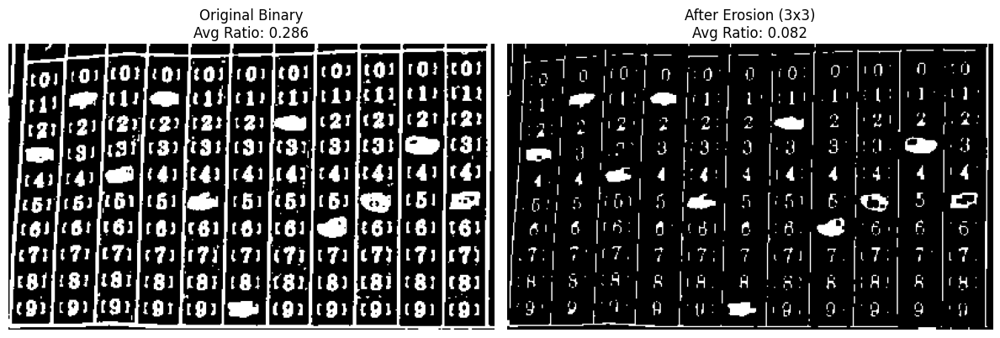

In [39]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def experiment_contrast_enhancement(img_path):
    # 模拟 Step 2 的预处理
    _, img, _ = process_answer_sheet(img_path, show=False)
    img = cv2.resize(img, (480, 320))
    h, w = img.shape[:2]
    roi_global = img[int(0.25*h):, :int(0.85*w)]
    gray = cv2.cvtColor(roi_global, cv2.COLOR_BGR2GRAY)
    
    # 1. 预处理 (CLAHE + Adaptive)
    clahe = cv2.createCLAHE(clipLimit=2.5, tileGridSize=(8,8))
    enhanced = clahe.apply(gray)
    binary = cv2.adaptiveThreshold(enhanced, 255, 
                                   cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                                   cv2.THRESH_BINARY_INV, 31, 12)
    
    # 2. 模拟两个 ROI：一个涂了(Filled)，一个没涂(Empty/Digit)
    # 这里你需要手动指定坐标，或者用之前的代码跑出来的坐标
    # 假设我们找到了一个填涂的点 (cx1, cy1) 和一个数字点 (cx2, cy2)
    # 为了演示，我直接对整个二值图做腐蚀，你可以对比整体效果
    
    # --- 核心操作：二值图腐蚀 ---
    kernel = np.ones((3, 3), np.uint8)
    eroded_binary = cv2.erode(binary, kernel, iterations=1)
    
    # 可视化对比
    plt.figure(figsize=(12, 6))
    
    plt.subplot(121)
    plt.imshow(binary, cmap='gray')
    plt.title(f"Original Binary\nAvg Ratio: {np.mean(binary)/255:.3f}")
    plt.axis('off')
    
    plt.subplot(122)
    plt.imshow(eroded_binary, cmap='gray')
    plt.title(f"After Erosion (3x3)\nAvg Ratio: {np.mean(eroded_binary)/255:.3f}")
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()

experiment_contrast_enhancement('images/test2.jpg')


学号识别——预处理（clahe + adaptive binary + close + find contours【w\h\S\r filter】）

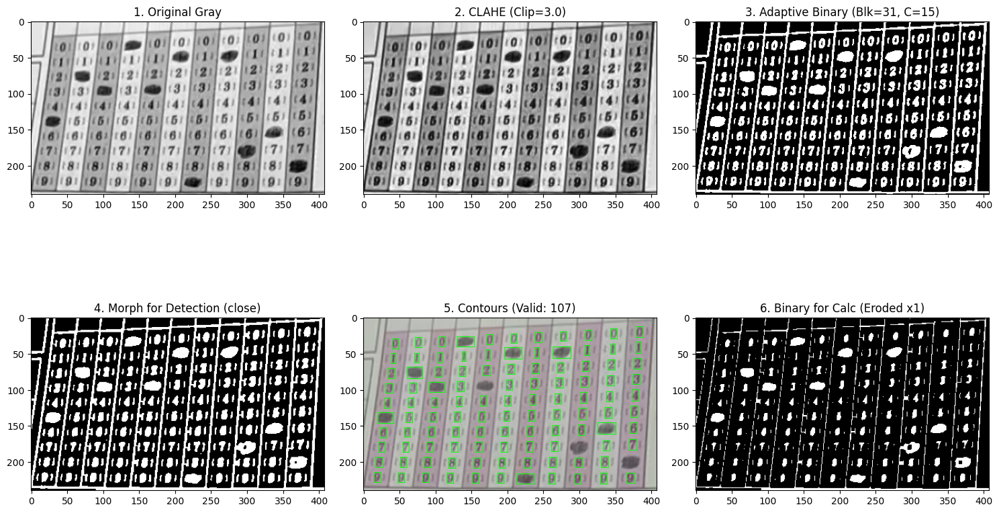

In [30]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from find_region import process_answer_sheet

# ==================== 1. 实验参数配置区 ====================
# 调整这些参数，直到你看到满意的效果
PARAMS = {
    'target_size': (480, 320),  # 缩放尺寸
    
    # CLAHE (对比度增强)
    'clahe_clip': 3.0,          # 越高对比度越强，但噪点也会增加 (建议 2.0 - 4.0)
    'clahe_grid': (8, 8),       # 网格大小
    
    # Adaptive Threshold (自适应二值化)
    'adaptive_block': 31,       # 邻域大小，必须是奇数 (建议 15 - 51)
    'adaptive_c': 15,           # 常数，越大过滤越强，但可能丢细节 (建议 5 - 20)
    
    # Morphology (形态学操作)
    'morph_type': 'close',      # 'open':断开粘连, 'close':连接断点, 'erode':加粗黑块
    'morph_kernel': (3, 3),     # 核大小 (3,3) 或 (5,5)
    
    # Erosion for Calc (计算占比用的腐蚀)
    'calc_erode_iter': 1        # 腐蚀次数，次数越多黑块越大
}

# ==================== 2. 核心处理流程 ====================
def run_experiment(img_path):
    # 1. 获取学号区域 (模拟 Step 1)
    try:
        res = process_answer_sheet(img_path, show=False)
        if len(res) == 3: _, roi_raw, _ = res
        else: _, roi_raw = res
    except:
        print("区域提取失败，使用原图测试")
        roi_raw = cv2.imread(img_path)

    # 2. 缩放与灰度
    resized = cv2.resize(roi_raw, PARAMS['target_size'])
    w, h = PARAMS['target_size']
    roi = resized[int(0.25*h):, :int(0.85*w)]
    gray = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    
    # 3. CLAHE 增强
    clahe = cv2.createCLAHE(clipLimit=PARAMS['clahe_clip'], tileGridSize=PARAMS['clahe_grid'])
    gray_enhanced = clahe.apply(gray)
    
    # 4. 自适应二值化 (Detection Path)
    bin_detect = cv2.adaptiveThreshold(gray_enhanced, 255, 
                                       cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                                       cv2.THRESH_BINARY_INV, 
                                       PARAMS['adaptive_block'], 
                                       PARAMS['adaptive_c'])
    
    # 5. 形态学处理 (Detection Path)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, PARAMS['morph_kernel'])
    if PARAMS['morph_type'] == 'open':
        morph_detect = cv2.morphologyEx(bin_detect, cv2.MORPH_OPEN, kernel)
    elif PARAMS['morph_type'] == 'close':
        morph_detect = cv2.morphologyEx(bin_detect, cv2.MORPH_CLOSE, kernel)
    elif PARAMS['morph_type'] == 'erode':
        morph_detect = cv2.erode(bin_detect, kernel, iterations=1)
    else:
        morph_detect = bin_detect
        
    # 6. 轮廓检测预览
    cnts, _ = cv2.findContours(morph_detect, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    img_cnt = cv2.cvtColor(roi, cv2.COLOR_BGR2RGB)
    valid_count = 0
    for c in cnts:
        area = cv2.contourArea(c)
        x, y, w, h = cv2.boundingRect(c)
        # 模拟筛选条件
        if 30 < area < 600 and 0.2 < w/h < 5 and 5 < h < 30 and w < 50 :
            cv2.rectangle(img_cnt, (x, y), (x+w, y+h), (0, 255, 0), 1)
            valid_count += 1
            
    # 7. 计算路径增强 (用于算占比)
    # 对二值图进行腐蚀 (白色区域变小 -> 数字变细/消失)
    # 或者对灰度图进行腐蚀 (黑色区域变大 -> 填涂变粗)
    # 这里演示你要求的：二值图腐蚀 (Erode Binary)
    kernel_calc = np.ones((3, 3), np.uint8)
    bin_calc = cv2.erode(morph_detect, kernel_calc, iterations=PARAMS['calc_erode_iter'])
    
    # ==================== 3. 可视化对比 ====================
    plt.figure(figsize=(15, 10))
    
    plt.subplot(231); plt.imshow(gray, cmap='gray'); plt.title("1. Original Gray")
    plt.subplot(232); plt.imshow(gray_enhanced, cmap='gray'); plt.title(f"2. CLAHE (Clip={PARAMS['clahe_clip']})")
    plt.subplot(233); plt.imshow(bin_detect, cmap='gray'); plt.title(f"3. Adaptive Binary (Blk={PARAMS['adaptive_block']}, C={PARAMS['adaptive_c']})")
    
    plt.subplot(234); plt.imshow(morph_detect, cmap='gray'); plt.title(f"4. Morph for Detection ({PARAMS['morph_type']})")
    plt.subplot(235); plt.imshow(img_cnt); plt.title(f"5. Contours (Valid: {valid_count})")
    plt.subplot(236); plt.imshow(bin_calc, cmap='gray'); plt.title(f"6. Binary for Calc (Eroded x{PARAMS['calc_erode_iter']})")
    
    plt.tight_layout()
    plt.show()

# 运行 (请替换为你的图片路径)
run_experiment('images/test15.jpg')


开始独立行列聚类，总点数: 101
  行聚类完成: 检测到 10 行
  行中心坐标: [21.0, 43.0, 64.0, 86.0, 108.5, 131.0, 154.0, 176.0, 199.0, 222.0]
  列聚类完成: 检测到 11 列
  列中心坐标: [20.0, 57.0, 93.0, 129.0, 165.0, 202.0, 239.0, 275.0, 312.0, 349.0, 385.5]
  网格大小: 10行 × 11列
去重完成: 101 -> 100 个点, 合并了 1 组重复点
平均行间距: 22.31, 平均列间距: 36.51
改进插值完成: 插值了 10 个点, 总共 110 个点

插值方法统计:
  纵坐标插值方法:
    上下线性插值(2→6): 3个
    上下线性插值(4→6): 2个
    下邻居外推(1→0): 1个
    上下线性插值(1→3): 1个
    上下线性插值(2→4): 1个
    上下线性插值(5→7): 1个
    上邻居外推(8→9): 1个

  横坐标插值方法:
    左右线性插值(1→3): 4个
    左右线性插值(5→7): 1个
    左右线性插值(8→10): 1个
    左右线性插值(3→5): 1个
    左右线性插值(7→9): 1个
    左右线性插值(6→8): 1个
    左右线性插值(4→6): 1个


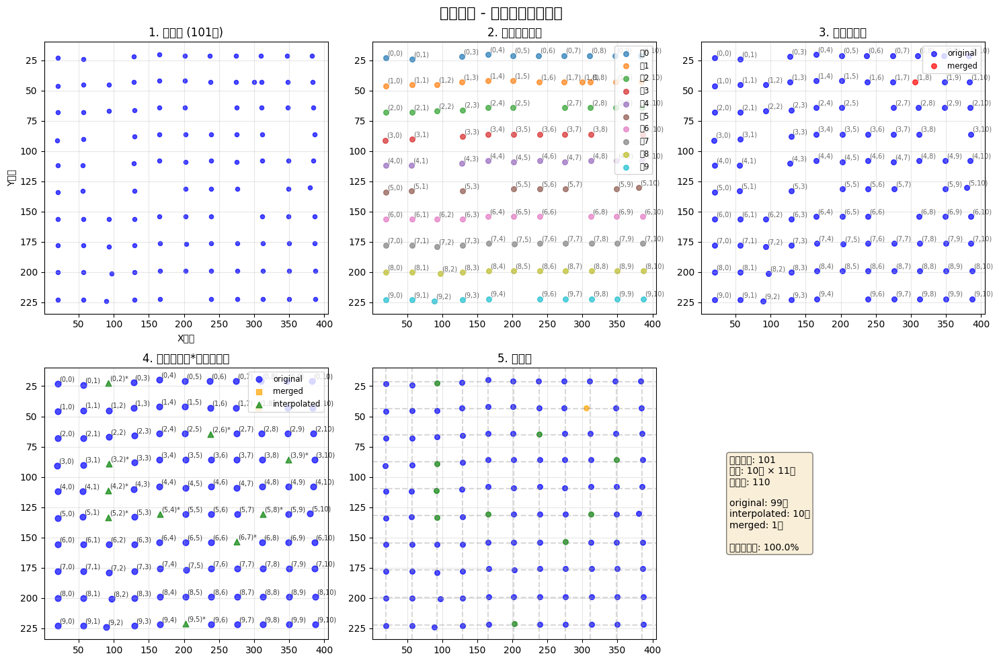


最终结果
网格大小: 10行 × 11列
总点数: 110

点状态统计:
  original: 99个
  interpolated: 10个
  merged: 1个


In [52]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from find_region import process_answer_sheet
from sklearn.cluster import KMeans
import pandas as pd

# ==================== 1. 实验参数配置区 ====================
PARAMS = {
    'target_size': (480, 320),  # 缩放尺寸
    'clahe_clip': 3.0,          # CLAHE
    'clahe_grid': (8, 8),       
    'adaptive_block': 31,       # 自适应二值化
    'adaptive_c': 15,           
    'morph_type': 'close',      # 形态学操作
    'morph_kernel': (3, 3),     
    'calc_erode_iter': 1,       # 腐蚀
    
    # 聚类参数
    'min_area': 30,
    'max_area': 600,
    'min_width': 5,
    'max_width': 50,
    'min_height': 5,
    'max_height': 30,
    'expected_rows': 10,  # 学号0-9
    'expected_cols': 11,  # 学号11位数
}

# ==================== 2. 核心处理流程 ====================
def run_experiment(img_path):
    # 1. 预处理
    try:
        res = process_answer_sheet(img_path, show=False)
        if len(res) == 3: _, roi_raw, _ = res
        else: _, roi_raw = res
    except:
        print("区域提取失败，使用原图测试")
        roi_raw = cv2.imread(img_path)

    # 2. 预处理
    resized = cv2.resize(roi_raw, PARAMS['target_size'])
    w, h = PARAMS['target_size']
    roi = resized[int(0.25*h):, :int(0.85*w)]
    gray = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    
    clahe = cv2.createCLAHE(clipLimit=PARAMS['clahe_clip'], tileGridSize=PARAMS['clahe_grid'])
    gray_enhanced = clahe.apply(gray)
    
    bin_detect = cv2.adaptiveThreshold(gray_enhanced, 255, 
                                       cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                                       cv2.THRESH_BINARY_INV, 
                                       PARAMS['adaptive_block'], 
                                       PARAMS['adaptive_c'])
    
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, PARAMS['morph_kernel'])
    if PARAMS['morph_type'] == 'close':
        morph_detect = cv2.morphologyEx(bin_detect, cv2.MORPH_CLOSE, kernel)
    else:
        morph_detect = bin_detect
        
    # 3. 轮廓检测
    cnts, _ = cv2.findContours(morph_detect, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    
    points = []
    for c in cnts:
        area = cv2.contourArea(c)
        x, y, w, h = cv2.boundingRect(c)
        
        if (PARAMS['min_area'] < area < PARAMS['max_area'] and 
            0.2 < w/h < 5 and 
            PARAMS['min_height'] < h < PARAMS['max_height'] and 
            w < PARAMS['max_width']):
            
            cx = x + w // 2
            cy = y + h // 2
            
            points.append({
                'x': x, 'y': y, 'w': w, 'h': h,
                'cx': cx, 'cy': cy, 
                'area': area,
            })
    
    df_points = pd.DataFrame(points) if points else pd.DataFrame()
    
    # 4. 聚类分析
    if not df_points.empty:
        # 独立行列聚类
        df_independent = independent_row_col_clustering(df_points.copy(), PARAMS)
        
        # 去重
        df_dedup = simple_deduplicate(df_independent.copy(), PARAMS)
        
        # 重新设计的插值算法
        df_interp = improved_interpolate(df_dedup.copy(), PARAMS)
        
        # 可视化
        visualize_results(roi, df_points, df_independent, df_dedup, df_interp)
        
        df_final = df_interp
    else:
        df_final = pd.DataFrame()
        print("没有检测到有效点")
    
    return df_final, roi, morph_detect

# ==================== 独立行列聚类函数 ====================
def independent_row_col_clustering(df_points, params):
    """独立的行列聚类，确保行列号从上到下、从左到右排序"""
    df = df_points.copy()
    
    print(f"开始独立行列聚类，总点数: {len(df)}")
    
    # 1. 独立行聚类（对所有y坐标聚类）
    y_coords = df['cy'].values.reshape(-1, 1)
    n_rows = min(params['expected_rows'], len(df))
    
    kmeans_y = KMeans(n_clusters=n_rows, random_state=42, n_init=10)
    df['row_label'] = kmeans_y.fit_predict(y_coords)
    
    # 计算每个聚类标签的y坐标中位数
    row_centers = {}
    for label in df['row_label'].unique():
        row_centers[label] = df[df['row_label'] == label]['cy'].median()
    
    # 按y坐标从小到大排序（从上到下）
    sorted_labels = sorted(row_centers.items(), key=lambda x: x[1])
    
    # 重新分配行号：y坐标最小的为行0，最大的为行9
    row_mapping = {old_label: i for i, (old_label, _) in enumerate(sorted_labels)}
    df['row_id'] = df['row_label'].map(row_mapping)
    df['row_center'] = df['row_label'].map(row_centers)
    
    print(f"  行聚类完成: 检测到 {df['row_id'].nunique()} 行")
    print(f"  行中心坐标: {[center for _, center in sorted_labels]}")
    
    # 2. 独立列聚类（对所有x坐标聚类）
    x_coords = df['cx'].values.reshape(-1, 1)
    n_cols = min(params['expected_cols'], len(df))
    
    kmeans_x = KMeans(n_clusters=n_cols, random_state=42, n_init=10)
    df['col_label'] = kmeans_x.fit_predict(x_coords)
    
    # 计算每个聚类标签的x坐标中位数
    col_centers = {}
    for label in df['col_label'].unique():
        col_centers[label] = df[df['col_label'] == label]['cx'].median()
    
    # 按x坐标从小到大排序（从左到右）
    sorted_col_labels = sorted(col_centers.items(), key=lambda x: x[1])
    
    # 重新分配列号：x坐标最小的为列0，最大的为列10
    col_mapping = {old_label: i for i, (old_label, _) in enumerate(sorted_col_labels)}
    df['col_id'] = df['col_label'].map(col_mapping)
    df['col_center'] = df['col_label'].map(col_centers)
    
    print(f"  列聚类完成: 检测到 {df['col_id'].nunique()} 列")
    print(f"  列中心坐标: {[center for _, center in sorted_col_labels]}")
    print(f"  网格大小: {df['row_id'].nunique()}行 × {df['col_id'].nunique()}列")
    
    return df

# ==================== 简单去重函数 ====================
def simple_deduplicate(df_clustered, params):
    """简单去重：同一行列位置取均值"""
    df = df_clustered.copy()
    
    if 'row_id' not in df.columns or 'col_id' not in df.columns:
        return df
    
    deduplicated = []
    duplicates_found = 0
    
    for (row_id, col_id), group in df.groupby(['row_id', 'col_id']):
        if len(group) > 1:
            # 取均值
            mean_point = {
                'row_id': int(row_id),
                'col_id': int(col_id),
                'cx': group['cx'].mean(),
                'cy': group['cy'].mean(),
                'area': group['area'].mean(),
                'x': int(group['x'].mean()),
                'y': int(group['y'].mean()),
                'w': int(group['w'].mean()),
                'h': int(group['h'].mean()),
                'status': 'merged',
                'count': len(group)
            }
            deduplicated.append(mean_point)
            duplicates_found += 1
        else:
            point = group.iloc[0].to_dict()
            point['row_id'] = int(point['row_id'])
            point['col_id'] = int(point['col_id'])
            point['status'] = 'original'
            point['count'] = 1
            deduplicated.append(point)
    
    result = pd.DataFrame(deduplicated)
    print(f"去重完成: {len(df)} -> {len(result)} 个点, 合并了 {duplicates_found} 组重复点")
    
    return result

# ==================== 改进的插值函数 ====================
def improved_interpolate(df_dedup, params):
    """改进的插值算法：考虑网格间距的线性插值"""
    df = df_dedup.copy()
    
    if 'row_id' not in df.columns or 'col_id' not in df.columns:
        return df
    
    # 获取行和列的范围
    rows = sorted(df['row_id'].unique())
    cols = sorted(df['col_id'].unique())
    
    # 创建点字典，方便快速查找
    point_dict = {}
    for _, point in df.iterrows():
        point_dict[(int(point['row_id']), int(point['col_id']))] = point.to_dict()
    
    all_points = []
    interpolated_count = 0
    
    # 计算平均行间距和列间距
    row_spacings = []
    col_spacings = []
    
    # 计算行间距（垂直间距）
    for col in cols:
        col_points = df[df['col_id'] == col]
        if len(col_points) > 1:
            col_points = col_points.sort_values('row_id')
            for i in range(1, len(col_points)):
                row_diff = col_points.iloc[i]['row_id'] - col_points.iloc[i-1]['row_id']
                y_diff = col_points.iloc[i]['cy'] - col_points.iloc[i-1]['cy']
                if row_diff > 0:
                    row_spacings.append(y_diff / row_diff)
    
    # 计算列间距（水平间距）
    for row in rows:
        row_points = df[df['row_id'] == row]
        if len(row_points) > 1:
            row_points = row_points.sort_values('col_id')
            for i in range(1, len(row_points)):
                col_diff = row_points.iloc[i]['col_id'] - row_points.iloc[i-1]['col_id']
                x_diff = row_points.iloc[i]['cx'] - row_points.iloc[i-1]['cx']
                if col_diff > 0:
                    col_spacings.append(x_diff / col_diff)
    
    avg_row_spacing = np.mean(row_spacings) if row_spacings else 20
    avg_col_spacing = np.mean(col_spacings) if col_spacings else 20
    
    print(f"平均行间距: {avg_row_spacing:.2f}, 平均列间距: {avg_col_spacing:.2f}")
    
    for row in rows:
        for col in cols:
            # 检查这个位置是否有点
            if (row, col) in point_dict:
                all_points.append(point_dict[(row, col)])
            else:
                # 需要插值
                interpolated_point = {
                    'row_id': int(row),
                    'col_id': int(col),
                    'status': 'interpolated',
                    'count': 0
                }
                
                # 1. 寻找最近的上下邻居（用于y坐标插值）
                up_neighbor = None
                down_neighbor = None
                
                # 向上找最近邻居
                for r in range(row-1, -1, -1):
                    if (r, col) in point_dict:
                        up_neighbor = (r, point_dict[(r, col)]['cy'])
                        break
                
                # 向下找最近邻居
                for r in range(row+1, max(rows)+1):
                    if (r, col) in point_dict:
                        down_neighbor = (r, point_dict[(r, col)]['cy'])
                        break
                
                # 2. 计算y坐标
                if up_neighbor and down_neighbor:
                    # 上下都有，线性插值
                    up_row, up_y = up_neighbor
                    down_row, down_y = down_neighbor
                    ratio = (row - up_row) / (down_row - up_row)
                    interpolated_point['cy'] = up_y + (down_y - up_y) * ratio
                    interpolated_point['y_method'] = f'上下线性插值({up_row}→{down_row})'
                elif up_neighbor:
                    # 只有上邻居，向下外推
                    up_row, up_y = up_neighbor
                    interpolated_point['cy'] = up_y + (row - up_row) * avg_row_spacing
                    interpolated_point['y_method'] = f'上邻居外推({up_row}→{row})'
                elif down_neighbor:
                    # 只有下邻居，向上外推
                    down_row, down_y = down_neighbor
                    interpolated_point['cy'] = down_y - (down_row - row) * avg_row_spacing
                    interpolated_point['y_method'] = f'下邻居外推({down_row}→{row})'
                else:
                    # 没有邻居，用该列的均值
                    col_points = df[df['col_id'] == col]
                    if len(col_points) > 0:
                        interpolated_point['cy'] = col_points['cy'].mean()
                        interpolated_point['y_method'] = f'列{col}均值'
                    else:
                        # 该列没有点，用全局均值
                        interpolated_point['cy'] = df['cy'].mean()
                        interpolated_point['y_method'] = '全局均值'
                
                # 3. 寻找最近的左右邻居（用于x坐标插值）
                left_neighbor = None
                right_neighbor = None
                
                # 向左找最近邻居
                for c in range(col-1, -1, -1):
                    if (row, c) in point_dict:
                        left_neighbor = (c, point_dict[(row, c)]['cx'])
                        break
                
                # 向右找最近邻居
                for c in range(col+1, max(cols)+1):
                    if (row, c) in point_dict:
                        right_neighbor = (c, point_dict[(row, c)]['cx'])
                        break
                
                # 4. 计算x坐标
                if left_neighbor and right_neighbor:
                    # 左右都有，线性插值
                    left_col, left_x = left_neighbor
                    right_col, right_x = right_neighbor
                    ratio = (col - left_col) / (right_col - left_col)
                    interpolated_point['cx'] = left_x + (right_x - left_x) * ratio
                    interpolated_point['x_method'] = f'左右线性插值({left_col}→{right_col})'
                elif left_neighbor:
                    # 只有左邻居，向右外推
                    left_col, left_x = left_neighbor
                    interpolated_point['cx'] = left_x + (col - left_col) * avg_col_spacing
                    interpolated_point['x_method'] = f'左邻居外推({left_col}→{col})'
                elif right_neighbor:
                    # 只有右邻居，向左外推
                    right_col, right_x = right_neighbor
                    interpolated_point['cx'] = right_x - (right_col - col) * avg_col_spacing
                    interpolated_point['x_method'] = f'右邻居外推({right_col}→{col})'
                else:
                    # 没有邻居，用该行的均值
                    row_points = df[df['row_id'] == row]
                    if len(row_points) > 0:
                        interpolated_point['cx'] = row_points['cx'].mean()
                        interpolated_point['x_method'] = f'行{row}均值'
                    else:
                        # 该行没有点，用全局均值
                        interpolated_point['cx'] = df['cx'].mean()
                        interpolated_point['x_method'] = '全局均值'
                
                # 5. 填充其他字段
                interpolated_point['area'] = df['area'].mean() if len(df) > 0 else 100
                interpolated_point['x'] = int(interpolated_point['cx'] - 10)
                interpolated_point['y'] = int(interpolated_point['cy'] - 5)
                interpolated_point['w'] = 20
                interpolated_point['h'] = 10
                
                all_points.append(interpolated_point)
                interpolated_count += 1
    
    result = pd.DataFrame(all_points)
    result = result.sort_values(['row_id', 'col_id']).reset_index(drop=True)
    
    print(f"改进插值完成: 插值了 {interpolated_count} 个点, 总共 {len(result)} 个点")
    
    # 显示插值统计
    if 'y_method' in result.columns and 'x_method' in result.columns:
        interpolated_points = result[result['status'] == 'interpolated']
        if len(interpolated_points) > 0:
            print("\n插值方法统计:")
            y_methods = interpolated_points['y_method'].value_counts()
            x_methods = interpolated_points['x_method'].value_counts()
            
            print("  纵坐标插值方法:")
            for method, count in y_methods.items():
                print(f"    {method}: {count}个")
            
            print("\n  横坐标插值方法:")
            for method, count in x_methods.items():
                print(f"    {method}: {count}个")
    
    return result

# ==================== 可视化函数 ====================
def visualize_results(roi, df_raw, df_independent, df_dedup, df_final):
    """可视化结果"""
    fig, axes = plt.subplots(2, 3, figsize=(15, 10))
    
    # 1. 原始点
    ax = axes[0, 0]
    ax.scatter(df_raw['cx'], df_raw['cy'], s=20, alpha=0.7, c='blue')
    ax.invert_yaxis()  # 图片坐标原点在左上角
    ax.set_xlabel('X坐标')
    ax.set_ylabel('Y坐标')
    ax.set_title(f'1. 原始点 ({len(df_raw)}个)')
    ax.grid(True, alpha=0.3)
    
    # 2. 独立行列聚类结果
    ax = axes[0, 1]
    if 'row_id' in df_independent.columns and 'col_id' in df_independent.columns:
        # 按行号着色
        unique_rows = sorted(df_independent['row_id'].unique())
        colors = plt.cm.tab10(np.linspace(0, 1, len(unique_rows)))
        
        for row_id, color in zip(unique_rows, colors):
            row_data = df_independent[df_independent['row_id'] == row_id]
            ax.scatter(row_data['cx'], row_data['cy'], 
                      color=color, s=30, label=f'行{row_id}', alpha=0.7)
        
        # 添加行列标签
        for _, point in df_independent.iterrows():
            ax.text(point['cx']+2, point['cy']-2, 
                   f"({int(point['row_id'])},{int(point['col_id'])})", 
                   fontsize=7, alpha=0.6)
    
    ax.legend(loc='upper right', fontsize='small')
    ax.invert_yaxis()
    ax.set_title('2. 独立行列聚类')
    ax.grid(True, alpha=0.3)
    
    # 3. 去重后结果
    ax = axes[0, 2]
    if 'status' in df_dedup.columns:
        colors = {'original': 'blue', 'merged': 'red'}
        for status, color in colors.items():
            status_data = df_dedup[df_dedup['status'] == status]
            if not status_data.empty:
                ax.scatter(status_data['cx'], status_data['cy'], 
                          color=color, s=30, label=status, alpha=0.7)
        
        for _, point in df_dedup.iterrows():
            ax.text(point['cx']+2, point['cy']-2, 
                   f"({int(point['row_id'])},{int(point['col_id'])})", 
                   fontsize=7, alpha=0.6)
    
    ax.legend(loc='upper right', fontsize='small')
    ax.invert_yaxis()
    ax.set_title('3. 去重后结果')
    ax.grid(True, alpha=0.3)
    
    # 4. 最终网格（包含插值点）
    ax = axes[1, 0]
    if 'status' in df_final.columns:
        colors = {'original': 'blue', 'merged': 'orange', 'interpolated': 'green'}
        markers = {'original': 'o', 'merged': 's', 'interpolated': '^'}
        
        for status, color in colors.items():
            status_data = df_final[df_final['status'] == status]
            if not status_data.empty:
                marker = markers[status]
                ax.scatter(status_data['cx'], status_data['cy'], 
                          color=color, s=40, marker=marker, 
                          label=status, alpha=0.7)
        
        # 添加标签（插值点用*标记）
        for _, point in df_final.iterrows():
            label = f"({int(point['row_id'])},{int(point['col_id'])})"
            if point['status'] == 'interpolated':
                label += "*"
            ax.text(point['cx']+2, point['cy']-2, label, fontsize=7, alpha=0.8)
    
    ax.legend(loc='upper right', fontsize='small')
    ax.invert_yaxis()
    ax.set_title('4. 最终网格（*为插值点）')
    ax.grid(True, alpha=0.3)
    
    # 5. 网格线可视化
    ax = axes[1, 1]
    if all(col in df_final.columns for col in ['row_id', 'col_id']):
        # 绘制网格线
        for row_id in sorted(df_final['row_id'].unique()):
            row_data = df_final[df_final['row_id'] == row_id]
            if not row_data.empty:
                y_mean = row_data['cy'].mean()
                ax.axhline(y=y_mean, color='gray', alpha=0.3, linestyle='--')
        
        for col_id in sorted(df_final['col_id'].unique()):
            col_data = df_final[df_final['col_id'] == col_id]
            if not col_data.empty:
                x_mean = col_data['cx'].mean()
                ax.axvline(x=x_mean, color='gray', alpha=0.3, linestyle='--')
        
        # 绘制点
        for _, point in df_final.iterrows():
            color = 'blue' if point['status'] == 'original' else 'orange' if point['status'] == 'merged' else 'green'
            ax.scatter(point['cx'], point['cy'], color=color, s=30, alpha=0.7)
    
    ax.invert_yaxis()
    ax.set_title('5. 网格线')
    ax.grid(True, alpha=0.3)
    
    # 6. 统计信息
    ax = axes[1, 2]
    ax.axis('off')
    
    # 创建统计文本
    stats_text = f"原始点数: {len(df_raw)}\n"
    if 'row_id' in df_final.columns and 'col_id' in df_final.columns:
        stats_text += f"网格: {df_final['row_id'].nunique()}行 × {df_final['col_id'].nunique()}列\n"
        stats_text += f"总点数: {len(df_final)}\n\n"
        
        if 'status' in df_final.columns:
            status_counts = df_final['status'].value_counts()
            for status, count in status_counts.items():
                stats_text += f"{status}: {count}个\n"
        
        # 检查是否完整
        expected_cells = df_final['row_id'].nunique() * df_final['col_id'].nunique()
        actual_cells = len(df_final)
        if expected_cells > 0:
            completeness = actual_cells / expected_cells * 100
            stats_text += f"\n网格完整度: {completeness:.1f}%"
    
    ax.text(0.1, 0.5, stats_text, fontsize=10, 
            verticalalignment='center', transform=ax.transAxes,
            bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))
    
    plt.suptitle('学号识别 - 独立行列聚类分析', fontsize=16)
    plt.tight_layout()
    plt.show()
    
    # 打印结果
    print("\n" + "="*60)
    print("最终结果")
    print("="*60)
    if not df_final.empty:
        print(f"网格大小: {df_final['row_id'].nunique()}行 × {df_final['col_id'].nunique()}列")
        print(f"总点数: {len(df_final)}")
        
        if 'status' in df_final.columns:
            print("\n点状态统计:")
            for status, count in df_final['status'].value_counts().items():
                print(f"  {status}: {count}个")

# ==================== 运行实验 ====================
# 运行
df_final, roi, morph_detect = run_experiment('images/test8.jpg')

去重完成: 合并了 1 组重复点
插值完成: 插值了 9 个点

填涂检测完成:
  阈值: 0.4
  学号: 31415926535
  填涂点: 11个


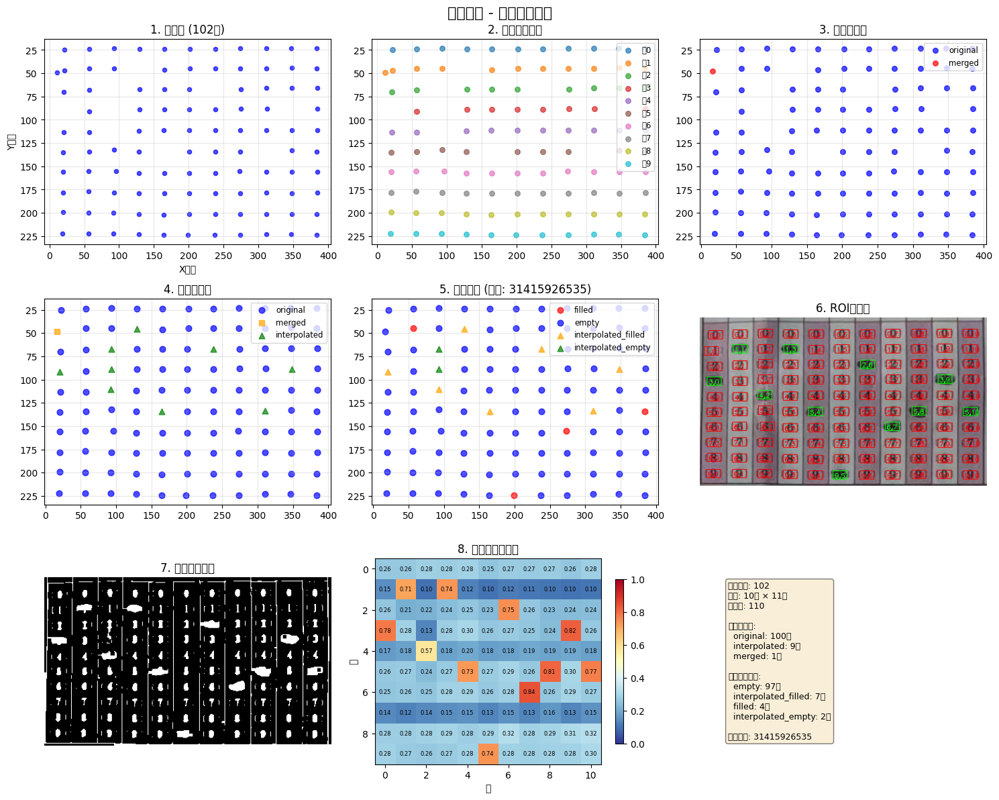


完整识别结果
网格大小: 10行 × 11列
学号: 31415926535

填涂状态统计:
  empty: 97个
  interpolated_filled: 7个
  filled: 4个
  interpolated_empty: 2个

填涂矩阵 (行0-9, 列0-10):
    0  1  2  3  4  5  6  7  8  9 10
 0 ▪ ▪ ▪ ▪ ▪ ▪ ▪ ▪ ▪ ▪ ▪
 1 ▪ ● ▪ ○ ▪ ▪ ▪ ▪ ▪ ▪ ▪
 2 ▪ ▪ □ ▪ ▪ ▪ ○ ▪ ▪ ▪ ▪
 3 ○ ▪ □ ▪ ▪ ▪ ▪ ▪ ▪ ○ ▪
 4 ▪ ▪ ○ ▪ ▪ ▪ ▪ ▪ ▪ ▪ ▪
 5 ▪ ▪ ▪ ▪ ○ ▪ ▪ ▪ ○ ▪ ●
 6 ▪ ▪ ▪ ▪ ▪ ▪ ▪ ● ▪ ▪ ▪
 7 ▪ ▪ ▪ ▪ ▪ ▪ ▪ ▪ ▪ ▪ ▪
 8 ▪ ▪ ▪ ▪ ▪ ▪ ▪ ▪ ▪ ▪ ▪
 9 ▪ ▪ ▪ ▪ ▪ ● ▪ ▪ ▪ ▪ ▪

图例: ●=填涂 ○=插值填涂 ▪=未填涂 □=插值未填涂


In [63]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from find_region import process_answer_sheet
from sklearn.cluster import KMeans
import pandas as pd

# ==================== 1. 实验参数配置区 ====================
PARAMS = {
    'target_size': (480, 320),  # 缩放尺寸
    'clahe_clip': 3.0,          # CLAHE
    'clahe_grid': (8, 8),       
    'adaptive_block': 31,       # 自适应二值化
    'adaptive_c': 15,           
    'morph_type': 'close',      # 形态学操作
    'morph_kernel': (3, 3),     
    'calc_erode_iter': 1,       # 腐蚀
    
    # 聚类参数
    'min_area': 30,
    'max_area': 600,
    'min_width': 5,
    'max_width': 50,
    'min_height': 5,
    'max_height': 30,
    'expected_rows': 10,  # 学号0-9
    'expected_cols': 11,  # 学号11位数
    
    # ROI和填涂检测参数
    'roi_size': (20, 12),       # ROI大小 (宽, 高)
    'fill_threshold': 0.4,      # 填涂阈值 (绝对占比)
}

# ==================== 2. 核心处理流程 ====================
def run_complete_experiment(img_path):
    """完整的学号识别流程"""
    # 1. 获取学号区域
    try:
        res = process_answer_sheet(img_path, show=False)
        if len(res) == 3: _, roi_raw, _ = res
        else: _, roi_raw = res
    except:
        print("区域提取失败，使用原图测试")
        roi_raw = cv2.imread(img_path)

    # 2. 预处理
    resized = cv2.resize(roi_raw, PARAMS['target_size'])
    w, h = PARAMS['target_size']
    roi = resized[int(0.25*h):, :int(0.85*w)]
    gray = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    
    clahe = cv2.createCLAHE(clipLimit=PARAMS['clahe_clip'], tileGridSize=PARAMS['clahe_grid'])
    gray_enhanced = clahe.apply(gray)
    
    bin_detect = cv2.adaptiveThreshold(gray_enhanced, 255, 
                                       cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                                       cv2.THRESH_BINARY_INV, 
                                       PARAMS['adaptive_block'], 
                                       PARAMS['adaptive_c'])
    
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, PARAMS['morph_kernel'])
    if PARAMS['morph_type'] == 'close':
        morph_detect = cv2.morphologyEx(bin_detect, cv2.MORPH_CLOSE, kernel)
    else:
        morph_detect = bin_detect
        
    # 3. 轮廓检测
    cnts, _ = cv2.findContours(morph_detect, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    
    points = []
    for c in cnts:
        area = cv2.contourArea(c)
        x, y, w_rect, h_rect = cv2.boundingRect(c)
        
        if (PARAMS['min_area'] < area < PARAMS['max_area'] and 
            0.2 < w_rect/h_rect < 5 and 
            PARAMS['min_height'] < h_rect < PARAMS['max_height'] and 
            w_rect < PARAMS['max_width']):
            
            cx = x + w_rect // 2
            cy = y + h_rect // 2
            
            points.append({
                'x': x, 'y': y, 'w': w_rect, 'h': h_rect,
                'cx': cx, 'cy': cy, 
                'area': area,
            })
    
    df_points = pd.DataFrame(points) if points else pd.DataFrame()
    
    # 4. 计算路径增强（用于填涂检测）
    kernel_calc = np.ones((3, 3), np.uint8)
    bin_calc = cv2.erode(morph_detect, kernel_calc, iterations=PARAMS['calc_erode_iter'])
    
    # 5. 聚类和填涂检测
    if not df_points.empty:
        # 独立行列聚类
        df_independent = independent_row_col_clustering(df_points.copy(), PARAMS)
        
        # 去重
        df_dedup = simple_deduplicate(df_independent.copy(), PARAMS)
        
        # 插值
        df_interp = improved_interpolate(df_dedup.copy(), PARAMS)
        
        # 填涂检测
        df_final = detect_filling(df_interp.copy(), bin_calc, PARAMS)
        
        # 可视化
        visualize_complete_results(roi, df_points, df_independent, df_dedup, df_interp, df_final, bin_calc)
        
    else:
        df_final = pd.DataFrame()
        print("没有检测到有效点")
    
    return df_final, roi, morph_detect, bin_calc

# ==================== 聚类函数 ====================
def independent_row_col_clustering(df_points, params):
    """独立的行列聚类，确保行列号从上到下、从左到右排序"""
    df = df_points.copy()
    
    # 1. 独立行聚类（对所有y坐标聚类）
    y_coords = df['cy'].values.reshape(-1, 1)
    n_rows = min(params['expected_rows'], len(df))
    
    kmeans_y = KMeans(n_clusters=n_rows, random_state=42, n_init=10)
    df['row_label'] = kmeans_y.fit_predict(y_coords)
    
    # 计算每个聚类标签的y坐标中位数
    row_centers = {}
    for label in df['row_label'].unique():
        row_centers[label] = df[df['row_label'] == label]['cy'].median()
    
    # 按y坐标从小到大排序（从上到下）
    sorted_labels = sorted(row_centers.items(), key=lambda x: x[1])
    
    # 重新分配行号：y坐标最小的为行0，最大的为行9
    row_mapping = {old_label: i for i, (old_label, _) in enumerate(sorted_labels)}
    df['row_id'] = df['row_label'].map(row_mapping)
    
    # 2. 独立列聚类（对所有x坐标聚类）
    x_coords = df['cx'].values.reshape(-1, 1)
    n_cols = min(params['expected_cols'], len(df))
    
    kmeans_x = KMeans(n_clusters=n_cols, random_state=42, n_init=10)
    df['col_label'] = kmeans_x.fit_predict(x_coords)
    
    # 计算每个聚类标签的x坐标中位数
    col_centers = {}
    for label in df['col_label'].unique():
        col_centers[label] = df[df['col_label'] == label]['cx'].median()
    
    # 按x坐标从小到大排序（从左到右）
    sorted_col_labels = sorted(col_centers.items(), key=lambda x: x[1])
    
    # 重新分配列号：x坐标最小的为列0，最大的为列10
    col_mapping = {old_label: i for i, (old_label, _) in enumerate(sorted_col_labels)}
    df['col_id'] = df['col_label'].map(col_mapping)
    
    return df

def simple_deduplicate(df_clustered, params):
    """简单去重：同一行列位置取均值"""
    df = df_clustered.copy()
    
    if 'row_id' not in df.columns or 'col_id' not in df.columns:
        return df
    
    deduplicated = []
    duplicates_found = 0
    
    for (row_id, col_id), group in df.groupby(['row_id', 'col_id']):
        if len(group) > 1:
            # 取均值
            mean_point = {
                'row_id': int(row_id),
                'col_id': int(col_id),
                'cx': group['cx'].mean(),
                'cy': group['cy'].mean(),
                'area': group['area'].mean(),
                'x': int(group['x'].mean()),
                'y': int(group['y'].mean()),
                'w': int(group['w'].mean()),
                'h': int(group['h'].mean()),
                'status': 'merged',
                'count': len(group)
            }
            deduplicated.append(mean_point)
            duplicates_found += 1
        else:
            point = group.iloc[0].to_dict()
            point['row_id'] = int(point['row_id'])
            point['col_id'] = int(point['col_id'])
            point['status'] = 'original'
            point['count'] = 1
            deduplicated.append(point)
    
    result = pd.DataFrame(deduplicated)
    print(f"去重完成: 合并了 {duplicates_found} 组重复点")
    
    return result

def improved_interpolate(df_dedup, params):
    """改进的插值算法：考虑网格间距的线性插值"""
    df = df_dedup.copy()
    
    if 'row_id' not in df.columns or 'col_id' not in df.columns:
        return df
    
    # 获取行和列的范围
    rows = sorted(df['row_id'].unique())
    cols = sorted(df['col_id'].unique())
    
    # 创建点字典，方便快速查找
    point_dict = {}
    for _, point in df.iterrows():
        point_dict[(int(point['row_id']), int(point['col_id']))] = point.to_dict()
    
    all_points = []
    interpolated_count = 0
    
    # 计算平均行间距和列间距
    row_spacings = []
    col_spacings = []
    
    # 计算行间距（垂直间距）
    for col in cols:
        col_points = df[df['col_id'] == col]
        if len(col_points) > 1:
            col_points = col_points.sort_values('row_id')
            for i in range(1, len(col_points)):
                row_diff = col_points.iloc[i]['row_id'] - col_points.iloc[i-1]['row_id']
                y_diff = col_points.iloc[i]['cy'] - col_points.iloc[i-1]['cy']
                if row_diff > 0:
                    row_spacings.append(y_diff / row_diff)
    
    # 计算列间距（水平间距）
    for row in rows:
        row_points = df[df['row_id'] == row]
        if len(row_points) > 1:
            row_points = row_points.sort_values('col_id')
            for i in range(1, len(row_points)):
                col_diff = row_points.iloc[i]['col_id'] - row_points.iloc[i-1]['col_id']
                x_diff = row_points.iloc[i]['cx'] - row_points.iloc[i-1]['cx']
                if col_diff > 0:
                    col_spacings.append(x_diff / col_diff)
    
    avg_row_spacing = np.mean(row_spacings) if row_spacings else 20
    avg_col_spacing = np.mean(col_spacings) if col_spacings else 20
    
    for row in rows:
        for col in cols:
            # 检查这个位置是否有点
            if (row, col) in point_dict:
                all_points.append(point_dict[(row, col)])
            else:
                # 需要插值
                interpolated_point = {
                    'row_id': int(row),
                    'col_id': int(col),
                    'status': 'interpolated',
                    'count': 0
                }
                
                # 1. 寻找最近的上下邻居
                up_neighbor = None
                down_neighbor = None
                
                # 向上找最近邻居
                for r in range(row-1, -1, -1):
                    if (r, col) in point_dict:
                        up_neighbor = (r, point_dict[(r, col)]['cy'])
                        break
                
                # 向下找最近邻居
                for r in range(row+1, max(rows)+1):
                    if (r, col) in point_dict:
                        down_neighbor = (r, point_dict[(r, col)]['cy'])
                        break
                
                # 2. 计算y坐标
                if up_neighbor and down_neighbor:
                    # 上下都有，线性插值
                    up_row, up_y = up_neighbor
                    down_row, down_y = down_neighbor
                    ratio = (row - up_row) / (down_row - up_row)
                    interpolated_point['cy'] = up_y + (down_y - up_y) * ratio
                elif up_neighbor:
                    # 只有上邻居，向下外推
                    up_row, up_y = up_neighbor
                    interpolated_point['cy'] = up_y + (row - up_row) * avg_row_spacing
                elif down_neighbor:
                    # 只有下邻居，向上外推
                    down_row, down_y = down_neighbor
                    interpolated_point['cy'] = down_y - (down_row - row) * avg_row_spacing
                else:
                    # 没有邻居，用该列的均值
                    col_points = df[df['col_id'] == col]
                    if len(col_points) > 0:
                        interpolated_point['cy'] = col_points['cy'].mean()
                    else:
                        interpolated_point['cy'] = df['cy'].mean()
                
                # 3. 寻找最近的左右邻居
                left_neighbor = None
                right_neighbor = None
                
                # 向左找最近邻居
                for c in range(col-1, -1, -1):
                    if (row, c) in point_dict:
                        left_neighbor = (c, point_dict[(row, c)]['cx'])
                        break
                
                # 向右找最近邻居
                for c in range(col+1, max(cols)+1):
                    if (row, c) in point_dict:
                        right_neighbor = (c, point_dict[(row, c)]['cx'])
                        break
                
                # 4. 计算x坐标
                if left_neighbor and right_neighbor:
                    # 左右都有，线性插值
                    left_col, left_x = left_neighbor
                    right_col, right_x = right_neighbor
                    ratio = (col - left_col) / (right_col - left_col)
                    interpolated_point['cx'] = left_x + (right_x - left_x) * ratio
                elif left_neighbor:
                    # 只有左邻居，向右外推
                    left_col, left_x = left_neighbor
                    interpolated_point['cx'] = left_x + (col - left_col) * avg_col_spacing
                elif right_neighbor:
                    # 只有右邻居，向左外推
                    right_col, right_x = right_neighbor
                    interpolated_point['cx'] = right_x - (right_col - col) * avg_col_spacing
                else:
                    # 没有邻居，用该行的均值
                    row_points = df[df['row_id'] == row]
                    if len(row_points) > 0:
                        interpolated_point['cx'] = row_points['cx'].mean()
                    else:
                        interpolated_point['cx'] = df['cx'].mean()
                
                # 5. 填充其他字段
                interpolated_point['area'] = df['area'].mean() if len(df) > 0 else 100
                interpolated_point['x'] = int(interpolated_point['cx'] - 10)
                interpolated_point['y'] = int(interpolated_point['cy'] - 5)
                interpolated_point['w'] = 20
                interpolated_point['h'] = 10
                
                all_points.append(interpolated_point)
                interpolated_count += 1
    
    result = pd.DataFrame(all_points)
    result = result.sort_values(['row_id', 'col_id']).reset_index(drop=True)
    
    print(f"插值完成: 插值了 {interpolated_count} 个点")
    
    return result

# ==================== 填涂检测函数 ====================
def detect_filling(df_grid, bin_calc, params):
    """检测每个网格点是否填涂"""
    df = df_grid.copy()
    
    if df.empty:
        return df
    
    # 初始化填涂相关列
    df['fill_ratio'] = 0.0
    df['is_filled'] = False
    df['fill_type'] = 'unknown'
    
    # 获取ROI大小
    roi_w, roi_h = params['roi_size']
    threshold = params['fill_threshold']
    
    for idx, row in df.iterrows():
        # 计算ROI边界
        x1 = int(row['cx'] - roi_w // 2)
        y1 = int(row['cy'] - roi_h // 2)
        x2 = int(row['cx'] + roi_w // 2)
        y2 = int(row['cy'] + roi_h // 2)
        
        # 确保ROI在图像范围内
        h, w = bin_calc.shape
        x1, y1 = max(0, x1), max(0, y1)
        x2, y2 = min(w, x2), min(h, y2)
        
        if x2 > x1 and y2 > y1:
            roi = bin_calc[y1:y2, x1:x2]
            if roi.size > 0:
                # 计算白色像素占比
                total_pixels = roi.size
                white_pixels = cv2.countNonZero(roi)
                fill_ratio = white_pixels / total_pixels
                
                df.at[idx, 'fill_ratio'] = fill_ratio
                
                # 判断是否填涂
                is_filled = fill_ratio > threshold
                df.at[idx, 'is_filled'] = is_filled
                
                # 标记填涂类型
                if is_filled:
                    if row['status'] == 'interpolated':
                        df.at[idx, 'fill_type'] = 'interpolated_filled'
                    else:
                        df.at[idx, 'fill_type'] = 'filled'
                else:
                    if row['status'] == 'interpolated':
                        df.at[idx, 'fill_type'] = 'interpolated_empty'
                    else:
                        df.at[idx, 'fill_type'] = 'empty'
    
    # 识别学号
    student_id = recognize_student_id(df)
    
    df['student_id'] = student_id
    
    print(f"\n填涂检测完成:")
    print(f"  阈值: {threshold}")
    print(f"  学号: {student_id}")
    print(f"  填涂点: {sum(df['is_filled'])}个")
    
    return df

def recognize_student_id(df):
    """从填涂结果识别学号"""
    if 'row_id' not in df.columns or 'col_id' not in df.columns:
        return ""
    
    # 获取列数范围
    cols = sorted(df['col_id'].unique())
    
    student_id = ""
    
    for col in cols:
        # 获取该列的所有点
        col_points = df[df['col_id'] == col]
        
        # 查找填涂的点
        filled_points = col_points[col_points['is_filled']]
        
        if len(filled_points) == 1:
            # 只有一个填涂点，取其行号
            row_id = int(filled_points.iloc[0]['row_id'])
            student_id += str(row_id)
        elif len(filled_points) > 1:
            # 多个填涂点，取填涂比例最高的
            best_idx = filled_points['fill_ratio'].idxmax()
            row_id = int(filled_points.loc[best_idx, 'row_id'])
            student_id += str(row_id)
        else:
            # 没有填涂点
            student_id += "?"
    
    return student_id

# ==================== 可视化函数 ====================
def visualize_complete_results(roi, df_raw, df_independent, df_dedup, df_interp, df_final, bin_calc):
    """可视化完整结果"""
    fig, axes = plt.subplots(3, 3, figsize=(15, 12))
    
    # 1. 原始点
    ax = axes[0, 0]
    ax.scatter(df_raw['cx'], df_raw['cy'], s=20, alpha=0.7, c='blue')
    ax.invert_yaxis()
    ax.set_xlabel('X坐标')
    ax.set_ylabel('Y坐标')
    ax.set_title(f'1. 原始点 ({len(df_raw)}个)')
    ax.grid(True, alpha=0.3)
    
    # 2. 独立行列聚类结果
    ax = axes[0, 1]
    if 'row_id' in df_independent.columns and 'col_id' in df_independent.columns:
        unique_rows = sorted(df_independent['row_id'].unique())
        colors = plt.cm.tab10(np.linspace(0, 1, len(unique_rows)))
        
        for row_id, color in zip(unique_rows, colors):
            row_data = df_independent[df_independent['row_id'] == row_id]
            ax.scatter(row_data['cx'], row_data['cy'], 
                      color=color, s=30, label=f'行{row_id}', alpha=0.7)
    
    ax.legend(loc='upper right', fontsize='small')
    ax.invert_yaxis()
    ax.set_title('2. 独立行列聚类')
    ax.grid(True, alpha=0.3)
    
    # 3. 去重后结果
    ax = axes[0, 2]
    if 'status' in df_dedup.columns:
        colors = {'original': 'blue', 'merged': 'red'}
        for status, color in colors.items():
            status_data = df_dedup[df_dedup['status'] == status]
            if not status_data.empty:
                ax.scatter(status_data['cx'], status_data['cy'], 
                          color=color, s=30, label=status, alpha=0.7)
    
    ax.legend(loc='upper right', fontsize='small')
    ax.invert_yaxis()
    ax.set_title('3. 去重后结果')
    ax.grid(True, alpha=0.3)
    
    # 4. 插值后网格
    ax = axes[1, 0]
    if 'status' in df_interp.columns:
        colors = {'original': 'blue', 'merged': 'orange', 'interpolated': 'green'}
        markers = {'original': 'o', 'merged': 's', 'interpolated': '^'}
        
        for status, color in colors.items():
            status_data = df_interp[df_interp['status'] == status]
            if not status_data.empty:
                marker = markers[status]
                ax.scatter(status_data['cx'], status_data['cy'], 
                          color=color, s=40, marker=marker, 
                          label=status, alpha=0.7)
    
    ax.legend(loc='upper right', fontsize='small')
    ax.invert_yaxis()
    ax.set_title('4. 插值后网格')
    ax.grid(True, alpha=0.3)
    
    # 5. 最终填涂结果
    ax = axes[1, 1]
    if 'fill_type' in df_final.columns:
        colors = {
            'filled': 'red',
            'empty': 'blue',
            'interpolated_filled': 'orange',
            'interpolated_empty': 'green'
        }
        markers = {
            'filled': 'o',
            'empty': 'o',
            'interpolated_filled': '^',
            'interpolated_empty': '^'
        }
        
        for fill_type, color in colors.items():
            type_data = df_final[df_final['fill_type'] == fill_type]
            if not type_data.empty:
                marker = markers[fill_type]
                ax.scatter(type_data['cx'], type_data['cy'], 
                          color=color, s=40, marker=marker, 
                          label=fill_type, alpha=0.7)
    
    ax.legend(loc='upper right', fontsize='small')
    ax.invert_yaxis()
    ax.set_title(f'5. 填涂结果 (学号: {df_final.iloc[0]["student_id"] if "student_id" in df_final.columns else "N/A"})')
    ax.grid(True, alpha=0.3)
    
    # 6. ROI显示
    ax = axes[1, 2]
    if not df_final.empty:
        # 创建带ROI框的图像
        img_roi = cv2.cvtColor(roi, cv2.COLOR_BGR2RGB) if len(roi.shape) == 3 else cv2.cvtColor(roi, cv2.COLOR_GRAY2RGB)
        
        roi_w, roi_h = PARAMS['roi_size']
        
        for _, point in df_final.iterrows():
            x1 = int(point['cx'] - roi_w // 2)
            y1 = int(point['cy'] - roi_h // 2)
            x2 = int(point['cx'] + roi_w // 2)
            y2 = int(point['cy'] + roi_h // 2)
            
            # 根据填涂状态选择颜色
            if point['is_filled']:
                color = (0, 255, 0)  # 绿色：填涂
            else:
                color = (255, 0, 0)  # 红色：未填涂
            
            cv2.rectangle(img_roi, (x1, y1), (x2, y2), color, 1)
            
            # 添加行列标签
            label = f"{int(point['row_id'])},{int(point['col_id'])}"
            cv2.putText(img_roi, label, (x1+2, y1+10), 
                       cv2.FONT_HERSHEY_SIMPLEX, 0.3, color, 1)
        
        ax.imshow(img_roi)
        ax.set_title('6. ROI框显示')
        ax.axis('off')
    
    # 7. 计算用二值图
    ax = axes[2, 0]
    ax.imshow(bin_calc, cmap='gray')
    ax.set_title('7. 计算用二值图')
    ax.axis('off')
    
    # 8. 填涂比例热力图
    ax = axes[2, 1]
    if 'fill_ratio' in df_final.columns and 'row_id' in df_final.columns and 'col_id' in df_final.columns:
        # 创建填涂比例矩阵
        rows = sorted(df_final['row_id'].unique())
        cols = sorted(df_final['col_id'].unique())
        
        fill_matrix = np.zeros((len(rows), len(cols)))
        
        for i, row in enumerate(rows):
            for j, col in enumerate(cols):
                point = df_final[(df_final['row_id'] == row) & (df_final['col_id'] == col)]
                if not point.empty:
                    fill_matrix[i, j] = point.iloc[0]['fill_ratio']
        
        im = ax.imshow(fill_matrix, cmap='RdYlBu_r', vmin=0, vmax=1)
        
        # 添加数值标签
        for i in range(fill_matrix.shape[0]):
            for j in range(fill_matrix.shape[1]):
                ax.text(j, i, f"{fill_matrix[i, j]:.2f}", 
                       ha='center', va='center', fontsize=6)
        
        plt.colorbar(im, ax=ax, shrink=0.8)
        ax.set_title('8. 填涂比例热力图')
        ax.set_xlabel('列')
        ax.set_ylabel('行')
    
    # 9. 统计信息
    ax = axes[2, 2]
    ax.axis('off')
    
    # 创建统计文本
    stats_text = f"原始点数: {len(df_raw)}\n"
    if not df_final.empty:
        stats_text += f"网格: {df_final['row_id'].nunique()}行 × {df_final['col_id'].nunique()}列\n"
        stats_text += f"总点数: {len(df_final)}\n\n"
        
        if 'status' in df_final.columns:
            status_counts = df_final['status'].value_counts()
            stats_text += "点状态统计:\n"
            for status, count in status_counts.items():
                stats_text += f"  {status}: {count}个\n"
        
        if 'fill_type' in df_final.columns:
            fill_counts = df_final['fill_type'].value_counts()
            stats_text += "\n填涂状态统计:\n"
            for fill_type, count in fill_counts.items():
                stats_text += f"  {fill_type}: {count}个\n"
        
        if 'student_id' in df_final.columns and not df_final.empty:
            student_id = df_final.iloc[0]['student_id']
            stats_text += f"\n识别学号: {student_id}"
    
    ax.text(0.1, 0.5, stats_text, fontsize=9, 
            verticalalignment='center', transform=ax.transAxes,
            bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))
    
    plt.suptitle('学号识别 - 完整流程分析', fontsize=16)
    plt.tight_layout()
    plt.show()
    
    # 打印详细结果
    print("\n" + "="*60)
    print("完整识别结果")
    print("="*60)
    
    if not df_final.empty:
        print(f"网格大小: {df_final['row_id'].nunique()}行 × {df_final['col_id'].nunique()}列")
        print(f"学号: {df_final.iloc[0]['student_id'] if 'student_id' in df_final.columns else 'N/A'}")
        
        if 'fill_type' in df_final.columns:
            print("\n填涂状态统计:")
            for fill_type, count in df_final['fill_type'].value_counts().items():
                print(f"  {fill_type}: {count}个")
        
        # 显示填涂矩阵
        print("\n填涂矩阵 (行0-9, 列0-10):")
        rows = sorted(df_final['row_id'].unique())
        cols = sorted(df_final['col_id'].unique())
        
        # 创建网格表示
        grid = []
        for row in rows:
            row_chars = []
            for col in cols:
                point = df_final[(df_final['row_id'] == row) & (df_final['col_id'] == col)]
                if not point.empty:
                    if point.iloc[0]['is_filled']:
                        if point.iloc[0]['status'] == 'interpolated':
                            row_chars.append('○')
                        else:
                            row_chars.append('●')
                    else:
                        if point.iloc[0]['status'] == 'interpolated':
                            row_chars.append('□')
                        else:
                            row_chars.append('▪')
                else:
                    row_chars.append(' ')
            grid.append(row_chars)
        
        # 打印网格
        print("   " + " ".join([f"{c:>2}" for c in cols]))
        for i, row_chars in enumerate(grid):
            print(f"{i:2} " + " ".join(row_chars))
        
        print("\n图例: ●=填涂 ○=插值填涂 ▪=未填涂 □=插值未填涂")

# ==================== 运行完整实验 ====================
# 运行
df_final, roi, morph_detect, bin_calc = run_complete_experiment('images/test3.jpg')

原始图片: (1702, 1279, 3)
✓ 提取答题区域

形态学处理流程:
  1. 闭运算填充
  2. 水平开运算 (核大小: (1, 7))
  3. 竖直开运算 (核大小: (7, 1))
  4. 最终闭运算
  5. 右侧20px归零

连通域: 417个


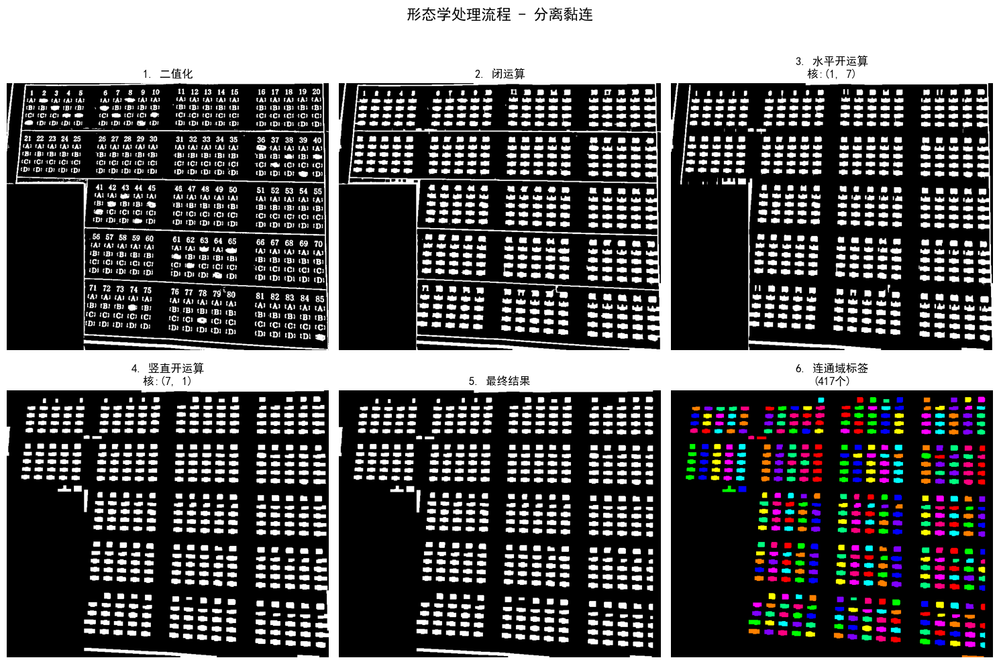

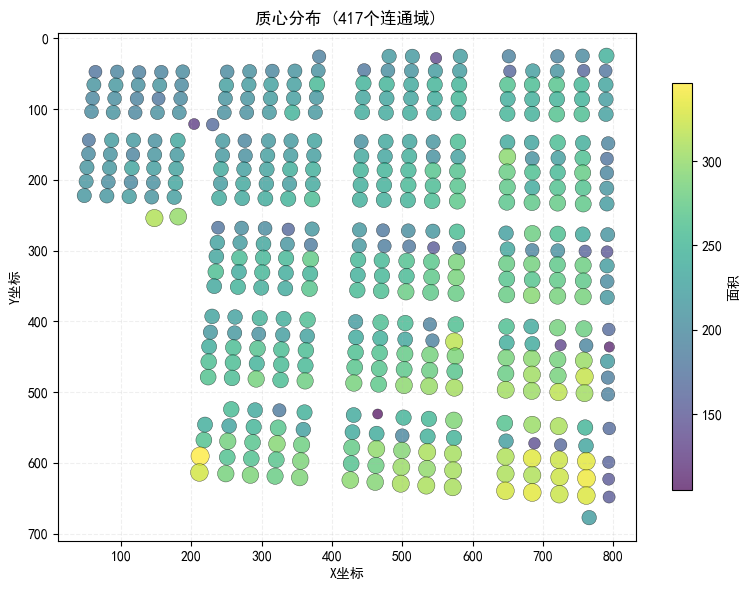


质心统计:
  X范围: 48 - 794
  Y范围: 25 - 677
  平均面积: 240.0


In [181]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from find_region import process_answer_sheet

# ==================== 1. 参数配置 ====================
PARAMS = {
    'target_size': (820, 680),  # 答题卡标准尺寸
    'clahe_clip': 3.0,          # CLAHE
    'clahe_grid': (8, 8),       
    'adaptive_block': 31,       # 自适应二值化
    'adaptive_c': 15,           
    'morph_kernel': (6, 6),     # 闭运算核大小
    'mask_bottom_ratio': 0.38,  # 底部掩码比例
    'mask_right_ratio': 0.24,   # 右侧掩码比例
    'right_strip_width': 20,     # 最右侧归零宽度
    
    # 分离黏连参数
    'open_h_kernel': (1, 7),    # 水平开运算核 (去除水平黏连)
    'open_v_kernel': (7, 1),    # 竖直开运算核 (去除竖直黏连)
    
    # 连通域参数
    'min_area': 100,     # 最小连通域面积
    'max_area': 400,    # 最大连通域面积
}

# ==================== 2. 读取和预处理 ====================
img_path = 'images/test2.jpg'
img = cv2.imread(img_path)
print(f"原始图片: {img.shape}")

# 提取答题区域
try:
    res = process_answer_sheet(img_path, show=False)
    sheet_warped = res[0]
    print("✓ 提取答题区域")
except:
    sheet_warped = img
    print("⚠ 使用原始图片")

# 缩放
resized = cv2.resize(sheet_warped, PARAMS['target_size'])

# 应用左下角掩码
h, w = resized.shape[:2]
masked = resized.copy()
mask_bottom = int(h * PARAMS['mask_bottom_ratio'])
mask_right = int(w * PARAMS['mask_right_ratio'])
masked[mask_bottom:, :mask_right] = 255

# 灰度转换
gray = cv2.cvtColor(masked, cv2.COLOR_BGR2GRAY)

# CLAHE增强
clahe = cv2.createCLAHE(clipLimit=PARAMS['clahe_clip'], 
                        tileGridSize=PARAMS['clahe_grid'])
gray_enhanced = clahe.apply(gray)

# 二值化
binary = cv2.adaptiveThreshold(gray_enhanced, 255, 
                               cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                               cv2.THRESH_BINARY_INV, 
                               PARAMS['adaptive_block'], 
                               PARAMS['adaptive_c'])

# 形态学处理流程
print("\n形态学处理流程:")

# 1. 初始闭运算填充孔洞
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, PARAMS['morph_kernel'])
closed = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel)
print("  1. 闭运算填充")

# 2. 去除水平黏连
kernel_h = cv2.getStructuringElement(cv2.MORPH_RECT, PARAMS['open_h_kernel'])
open_h = cv2.morphologyEx(closed, cv2.MORPH_OPEN, kernel_h)
print(f"  2. 水平开运算 (核大小: {PARAMS['open_h_kernel']})")

# 3. 去除竖直黏连
kernel_v = cv2.getStructuringElement(cv2.MORPH_RECT, PARAMS['open_v_kernel'])
open_v = cv2.morphologyEx(open_h, cv2.MORPH_OPEN, kernel_v)
print(f"  3. 竖直开运算 (核大小: {PARAMS['open_v_kernel']})")

# 4. 最终闭运算
final_closed = cv2.morphologyEx(open_v, cv2.MORPH_CLOSE, kernel)
print("  4. 最终闭运算")

# 最右侧归零
final_closed[:, -PARAMS['right_strip_width']:] = 0
print(f"  5. 右侧{PARAMS['right_strip_width']}px归零")

# ==================== 3. 连通域分析 ====================
num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(
    final_closed, connectivity=8
)

# 过滤和存储连通域
regions = []
for i in range(1, num_labels):
    area = stats[i, cv2.CC_STAT_AREA]
    if PARAMS['min_area'] <= area <= PARAMS['max_area']:
        x = stats[i, cv2.CC_STAT_LEFT]
        y = stats[i, cv2.CC_STAT_TOP]
        w_rect = stats[i, cv2.CC_STAT_WIDTH]
        h_rect = stats[i, cv2.CC_STAT_HEIGHT]
        centroid_x, centroid_y = centroids[i]
        
        regions.append({
            'label': i,
            'area': area,
            'centroid': (centroid_x, centroid_y),
        })

print(f"\n连通域: {len(regions)}个")

# ==================== 4. 可视化 ====================
fig, axes = plt.subplots(2, 3, figsize=(15, 10))

# 第1行：处理过程
# 1. 原始二值化
ax = axes[0, 0]
ax.imshow(binary, cmap='gray')
ax.set_title('1. 二值化', fontsize=12)
ax.axis('off')

# 2. 闭运算
ax = axes[0, 1]
ax.imshow(closed, cmap='gray')
ax.set_title('2. 闭运算', fontsize=12)
ax.axis('off')

# 3. 水平开运算
ax = axes[0, 2]
ax.imshow(open_h, cmap='gray')
ax.set_title(f'3. 水平开运算\n核:{PARAMS["open_h_kernel"]}', fontsize=12)
ax.axis('off')

# 第2行：处理过程
# 4. 竖直开运算
ax = axes[1, 0]
ax.imshow(open_v, cmap='gray')
ax.set_title(f'4. 竖直开运算\n核:{PARAMS["open_v_kernel"]}', fontsize=12)
ax.axis('off')

# 5. 最终结果
ax = axes[1, 1]
ax.imshow(final_closed, cmap='gray')
ax.set_title('5. 最终结果', fontsize=12)
ax.axis('off')

# 6. 连通域标签
ax = axes[1, 2]
if regions:
    # 创建鲜艳的彩色标签图像
    label_colors = np.zeros((labels.shape[0], labels.shape[1], 3), dtype=np.uint8)
    
    # 使用鲜艳的颜色
    colors = [
        (255, 0, 0),    # 红
        (0, 255, 0),    # 绿
        (0, 0, 255),    # 蓝
        (255, 255, 0),  # 黄
        (255, 0, 255),  # 品红
        (0, 255, 255),  # 青
        (255, 128, 0),  # 橙
        (128, 0, 255),  # 紫
        (0, 255, 128),  # 青绿
        (255, 0, 128),  # 粉
    ]
    
    # 为每个连通域分配颜色
    for idx, region in enumerate(regions):
        color_idx = idx % len(colors)
        color = colors[color_idx]
        label_colors[labels == region['label']] = color
    
    ax.imshow(label_colors)
    ax.set_title(f'6. 连通域标签\n({len(regions)}个)', fontsize=12)
else:
    ax.text(0.5, 0.5, '无连通域', ha='center', va='center', 
            transform=ax.transAxes, fontsize=12)
    ax.set_title('6. 连通域标签', fontsize=12)
ax.axis('off')

plt.suptitle('形态学处理流程 - 分离黏连', fontsize=16, y=1.02)
plt.tight_layout()
plt.show()

# ==================== 5. 质心分布图 ====================
if regions:
    fig, ax = plt.subplots(figsize=(8, 6))
    
    centroids_x = [r['centroid'][0] for r in regions]
    centroids_y = [r['centroid'][1] for r in regions]
    areas = [r['area'] for r in regions]
    
    # 散点图
    scatter = ax.scatter(centroids_x, centroids_y, 
                       s=[a/2 for a in areas],
                       c=areas, cmap='viridis', 
                       alpha=0.7, edgecolors='k', linewidth=0.3)
    
    # 设置坐标轴
    ax.invert_yaxis()
    ax.set_xlabel('X坐标', fontsize=10)
    ax.set_ylabel('Y坐标', fontsize=10)
    ax.set_title(f'质心分布 ({len(regions)}个连通域)', fontsize=12)
    ax.grid(True, alpha=0.2, linestyle='--')
    
    # 在图形外部添加颜色条
    plt.colorbar(scatter, ax=ax, label='面积', shrink=0.8)
    
    plt.tight_layout()
    plt.show()
    
    # 简单统计
    print(f"\n质心统计:")
    print(f"  X范围: {min(centroids_x):.0f} - {max(centroids_x):.0f}")
    print(f"  Y范围: {min(centroids_y):.0f} - {max(centroids_y):.0f}")
    print(f"  平均面积: {np.mean(areas):.1f}")

原始图片: (1706, 1279, 3)
✓ 提取答题区域
右侧20px归零
连通域: 375个


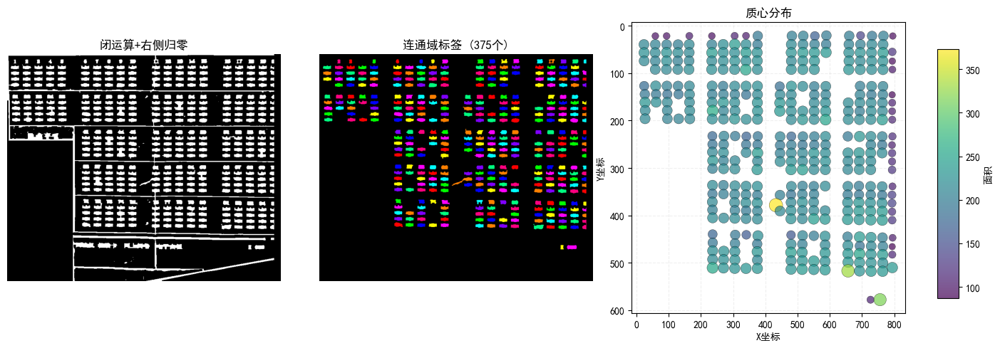


质心统计:
  X: 23-796
  Y: 21-578


In [188]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from find_region import process_answer_sheet

# ==================== 1. 参数配置 ====================
PARAMS = {
    'target_size': (820, 680),  # 答题卡标准尺寸
    'clahe_clip': 3.0,          # CLAHE
    'clahe_grid': (8, 8),       
    'adaptive_block': 31,       # 自适应二值化
    'adaptive_c': 15,           
    'morph_kernel': (6, 6),     # 闭运算核大小
    'mask_bottom_ratio': 0.38,  # 底部掩码比例
    'mask_right_ratio': 0.24,   # 右侧掩码比例
    'right_strip_width': 20,     # 最右侧归零宽度
    
    # 连通域参数
    'min_area': 80,     # 最小连通域面积
    'max_area': 400,    # 最大连通域面积
}

# ==================== 2. 读取和预处理 ====================
img_path = 'images/test6.jpg'
img = cv2.imread(img_path)
print(f"原始图片: {img.shape}")

# 提取答题区域
try:
    res = process_answer_sheet(img_path, show=False)
    sheet_warped = res[0]
    print("✓ 提取答题区域")
except:
    sheet_warped = img
    print("⚠ 使用原始图片")

# 缩放
resized = cv2.resize(sheet_warped, PARAMS['target_size'])

# 应用左下角掩码
h, w = resized.shape[:2]
masked = resized.copy()
mask_bottom = int(h * PARAMS['mask_bottom_ratio'])
mask_right = int(w * PARAMS['mask_right_ratio'])
masked[mask_bottom:, :mask_right] = 255

# 灰度转换
gray = cv2.cvtColor(masked, cv2.COLOR_BGR2GRAY)

# CLAHE增强
clahe = cv2.createCLAHE(clipLimit=PARAMS['clahe_clip'], 
                        tileGridSize=PARAMS['clahe_grid'])
gray_enhanced = clahe.apply(gray)

# 二值化
binary = cv2.adaptiveThreshold(gray_enhanced, 255, 
                               cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                               cv2.THRESH_BINARY_INV, 
                               PARAMS['adaptive_block'], 
                               PARAMS['adaptive_c'])

# 闭运算
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, PARAMS['morph_kernel'])
closed = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel)

# 最右侧归零
closed[:, -PARAMS['right_strip_width']:] = 0
print(f"右侧{PARAMS['right_strip_width']}px归零")

# ==================== 3. 连通域分析 ====================
num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(
    closed, connectivity=8
)

# 过滤和存储连通域
regions = []
for i in range(1, num_labels):
    area = stats[i, cv2.CC_STAT_AREA]
    if PARAMS['min_area'] <= area <= PARAMS['max_area']:
        x = stats[i, cv2.CC_STAT_LEFT]
        y = stats[i, cv2.CC_STAT_TOP]
        w_rect = stats[i, cv2.CC_STAT_WIDTH]
        h_rect = stats[i, cv2.CC_STAT_HEIGHT]
        centroid_x, centroid_y = centroids[i]
        
        regions.append({
            'label': i,
            'area': area,
            'centroid': (centroid_x, centroid_y),
        })

print(f"连通域: {len(regions)}个")

# ==================== 4. 可视化 ====================
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# 左图：预处理结果
ax = axes[0]
ax.imshow(closed, cmap='gray')
ax.set_title('闭运算+右侧归零', fontsize=12)
ax.axis('off')

# 中图：连通域标签
ax = axes[1]
if regions:
    # 创建鲜艳的彩色标签图像
    label_colors = np.zeros((labels.shape[0], labels.shape[1], 3), dtype=np.uint8)
    
    # 使用鲜艳的颜色
    colors = [
        (255, 0, 0),    # 红
        (0, 255, 0),    # 绿
        (0, 0, 255),    # 蓝
        (255, 255, 0),  # 黄
        (255, 0, 255),  # 品红
        (0, 255, 255),  # 青
        (255, 128, 0),  # 橙
        (128, 0, 255),  # 紫
        (0, 255, 128),  # 青绿
        (255, 0, 128),  # 粉
    ]
    
    # 为每个连通域分配颜色
    for idx, region in enumerate(regions):
        color_idx = idx % len(colors)
        color = colors[color_idx]
        label_colors[labels == region['label']] = color
    
    ax.imshow(label_colors)
    ax.set_title(f'连通域标签 ({len(regions)}个)', fontsize=12)
else:
    ax.text(0.5, 0.5, '无连通域', ha='center', va='center', 
            transform=ax.transAxes, fontsize=12)
    ax.set_title('连通域标签', fontsize=12)
ax.axis('off')

# 右图：质心分布
ax = axes[2]
if regions:
    centroids_x = [r['centroid'][0] for r in regions]
    centroids_y = [r['centroid'][1] for r in regions]
    areas = [r['area'] for r in regions]
    
    # 散点图
    scatter = ax.scatter(centroids_x, centroids_y, 
                       s=[a/2 for a in areas],
                       c=areas, cmap='viridis', 
                       alpha=0.7, edgecolors='k', linewidth=0.3)
    
    # 设置坐标轴
    ax.invert_yaxis()
    ax.set_xlabel('X坐标', fontsize=10)
    ax.set_ylabel('Y坐标', fontsize=10)
    ax.set_title('质心分布', fontsize=12)
    ax.grid(True, alpha=0.2, linestyle='--')
else:
    ax.text(0.5, 0.5, '无连通域', ha='center', va='center', 
            transform=ax.transAxes, fontsize=12)
    ax.set_title('质心分布', fontsize=12)
    ax.axis('off')

plt.tight_layout()

# 在图形外部添加颜色条
if regions:
    fig.subplots_adjust(right=0.85)
    cbar_ax = fig.add_axes([0.88, 0.15, 0.02, 0.7])  # [左, 下, 宽, 高]
    cbar = fig.colorbar(scatter, cax=cbar_ax)
    cbar.set_label('面积', fontsize=10)

plt.show()

# ==================== 5. 简单统计 ====================
if regions:
    centroids_x = [r['centroid'][0] for r in regions]
    centroids_y = [r['centroid'][1] for r in regions]
    print(f"\n质心统计:")
    print(f"  X: {min(centroids_x):.0f}-{max(centroids_x):.0f}")
    print(f"  Y: {min(centroids_y):.0f}-{max(centroids_y):.0f}")

原始图片: (1919, 1080, 3)
✓ 提取答题区域
右侧20px归零
连通域: 400个

X坐标分析:
  X坐标范围: 101.5 - 796.3
  X坐标数量: 400
  X坐标间隔统计:
    最大间隔: 40.0
    最小间隔: 0.0
    平均间隔: 1.7
    间隔阈值: 35
    发现垂直分界线: 621.1 (在 601.1 和 641.1 之间, 间隔: 40.0)

Y坐标分析:
  Y坐标范围: 10.7 - 644.5
  Y坐标数量: 400
  Y坐标间隔统计:
    最大间隔: 38.0
    最小间隔: 0.0
    平均间隔: 1.6
    间隔阈值: 30
    发现水平分界线: 244.5 (在 225.5 和 263.5 之间, 间隔: 38.0)
    发现水平分界线: 370.3 (在 354.3 和 386.2 之间, 间隔: 31.9)

分界线检测结果:
  垂直分界线: 1条
    第1条: x = 621.1
  水平分界线: 2条
    第1条: y = 244.5
    第2条: y = 370.3

网格区域划分:
  X方向区域: 2个
  Y方向区域: 3个
  总网格数: 6


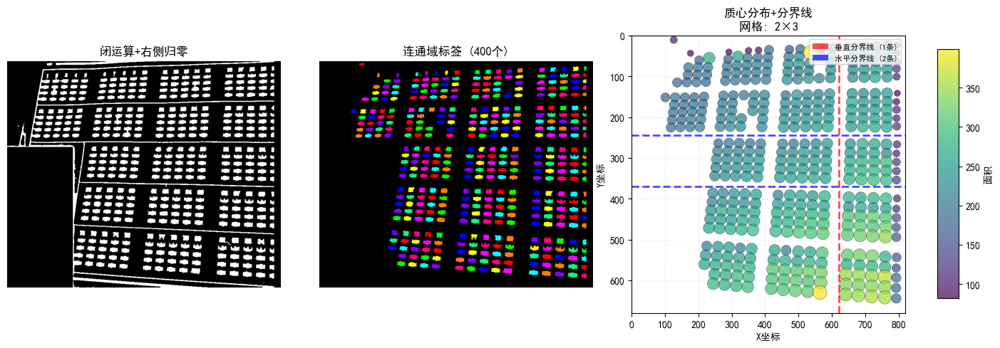

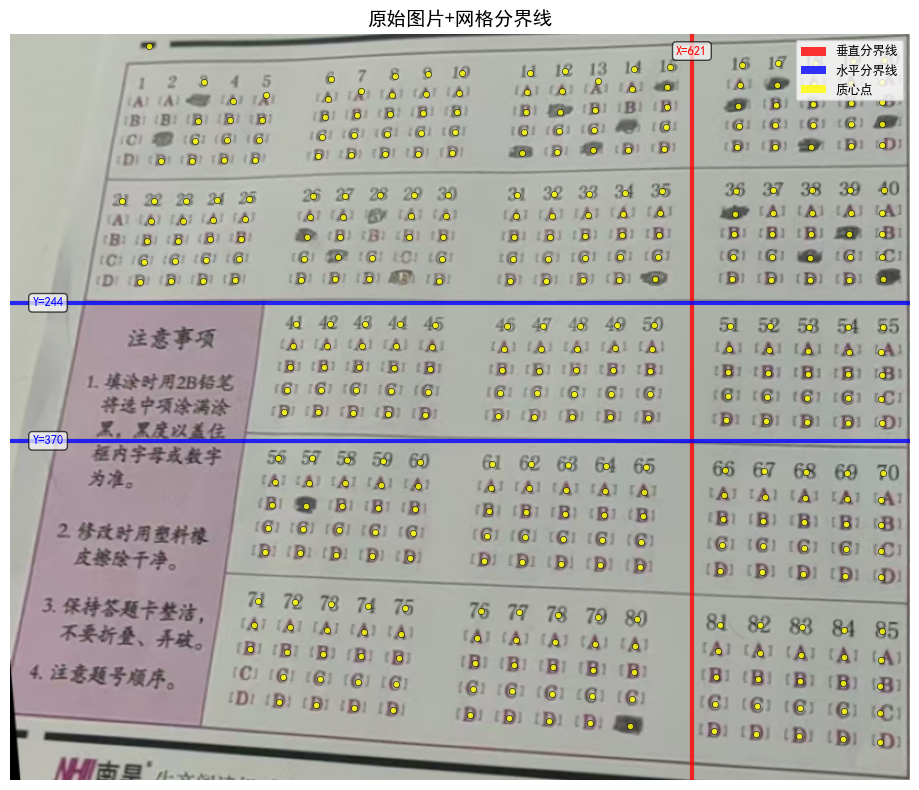


质心统计:
  X范围: 102-796
  Y范围: 11-644


In [221]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from find_region import process_answer_sheet

# ==================== 1. 参数配置 ====================
PARAMS = {
    'target_size': (820, 680),  # 答题卡标准尺寸
    'clahe_clip': 3.0,          # CLAHE
    'clahe_grid': (8, 8),       
    'adaptive_block': 31,       # 自适应二值化
    'adaptive_c': 15,           
    'morph_kernel': (6, 6),     # 闭运算核大小
    'mask_bottom_ratio': 0.38,  # 底部掩码比例
    'mask_right_ratio': 0.24,   # 右侧掩码比例
    'right_strip_width': 20,    # 最右侧归零宽度
    
    # 连通域参数
    'min_area': 80,     # 最小连通域面积
    'max_area': 400,    # 最大连通域面积
    
    # 分界线检测参数
    'gap_threshold_x': 35,     # 水平方向间隔阈值
    'gap_threshold_y': 30,      # 垂直方向间隔阈值
}

# ==================== 2. 读取和预处理 ====================
img_path = 'images/test15.jpg'
img = cv2.imread(img_path)
print(f"原始图片: {img.shape}")

# 提取答题区域
try:
    res = process_answer_sheet(img_path, show=False)
    sheet_warped = res[0]
    print("✓ 提取答题区域")
except:
    sheet_warped = img
    print("⚠ 使用原始图片")

# 缩放
resized = cv2.resize(sheet_warped, PARAMS['target_size'])

# 应用左下角掩码
h, w = resized.shape[:2]
masked = resized.copy()
mask_bottom = int(h * PARAMS['mask_bottom_ratio'])
mask_right = int(w * PARAMS['mask_right_ratio'])
masked[mask_bottom:, :mask_right] = 255

# 灰度转换
gray = cv2.cvtColor(masked, cv2.COLOR_BGR2GRAY)

# CLAHE增强
clahe = cv2.createCLAHE(clipLimit=PARAMS['clahe_clip'], 
                        tileGridSize=PARAMS['clahe_grid'])
gray_enhanced = clahe.apply(gray)

# 二值化
binary = cv2.adaptiveThreshold(gray_enhanced, 255, 
                               cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                               cv2.THRESH_BINARY_INV, 
                               PARAMS['adaptive_block'], 
                               PARAMS['adaptive_c'])

# 闭运算
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, PARAMS['morph_kernel'])
closed = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel)

# 最右侧归零
closed[:, -PARAMS['right_strip_width']:] = 0
print(f"右侧{PARAMS['right_strip_width']}px归零")

# ==================== 3. 连通域分析 ====================
num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(
    closed, connectivity=8
)

# 过滤和存储连通域
regions = []
for i in range(1, num_labels):
    area = stats[i, cv2.CC_STAT_AREA]
    if PARAMS['min_area'] <= area <= PARAMS['max_area']:
        x = stats[i, cv2.CC_STAT_LEFT]
        y = stats[i, cv2.CC_STAT_TOP]
        w_rect = stats[i, cv2.CC_STAT_WIDTH]
        h_rect = stats[i, cv2.CC_STAT_HEIGHT]
        centroid_x, centroid_y = centroids[i]
        
        regions.append({
            'label': i,
            'area': area,
            'centroid': (centroid_x, centroid_y),
        })

print(f"连通域: {len(regions)}个")

# ==================== 4. 分界线检测 ====================
def detect_boundaries(points_x, points_y, gap_threshold_x, gap_threshold_y):
    """检测水平和垂直分界线"""
    
    # 检测垂直分界线（基于X坐标）
    vertical_lines = []
    if len(points_x) > 1:
        sorted_x = np.sort(points_x)
        diffs = np.diff(sorted_x)
        
        print(f"\nX坐标分析:")
        print(f"  X坐标范围: {sorted_x[0]:.1f} - {sorted_x[-1]:.1f}")
        print(f"  X坐标数量: {len(sorted_x)}")
        print(f"  X坐标间隔统计:")
        print(f"    最大间隔: {max(diffs):.1f}")
        print(f"    最小间隔: {min(diffs):.1f}")
        print(f"    平均间隔: {np.mean(diffs):.1f}")
        print(f"    间隔阈值: {gap_threshold_x}")
        
        # 找到跳变点
        for i, diff in enumerate(diffs):
            if diff > gap_threshold_x:
                # 找到间隔大于阈值的两个点
                x1 = sorted_x[i]
                x2 = sorted_x[i + 1]
                boundary = (x1 + x2) / 2
                vertical_lines.append(boundary)
                print(f"    发现垂直分界线: {boundary:.1f} (在 {x1:.1f} 和 {x2:.1f} 之间, 间隔: {diff:.1f})")
    
    # 检测水平分界线（基于Y坐标）
    horizontal_lines = []
    if len(points_y) > 1:
        sorted_y = np.sort(points_y)
        diffs = np.diff(sorted_y)
        
        print(f"\nY坐标分析:")
        print(f"  Y坐标范围: {sorted_y[0]:.1f} - {sorted_y[-1]:.1f}")
        print(f"  Y坐标数量: {len(sorted_y)}")
        print(f"  Y坐标间隔统计:")
        print(f"    最大间隔: {max(diffs):.1f}")
        print(f"    最小间隔: {min(diffs):.1f}")
        print(f"    平均间隔: {np.mean(diffs):.1f}")
        print(f"    间隔阈值: {gap_threshold_y}")
        
        # 找到跳变点
        for i, diff in enumerate(diffs):
            if diff > gap_threshold_y:
                # 找到间隔大于阈值的两个点
                y1 = sorted_y[i]
                y2 = sorted_y[i + 1]
                boundary = (y1 + y2) / 2
                horizontal_lines.append(boundary)
                print(f"    发现水平分界线: {boundary:.1f} (在 {y1:.1f} 和 {y2:.1f} 之间, 间隔: {diff:.1f})")
    
    return vertical_lines, horizontal_lines

# 提取质心坐标
if regions:
    centroids_x = [r['centroid'][0] for r in regions]
    centroids_y = [r['centroid'][1] for r in regions]
    
    # 检测分界线
    vertical_lines, horizontal_lines = detect_boundaries(
        centroids_x, centroids_y, 
        PARAMS['gap_threshold_x'], PARAMS['gap_threshold_y']
    )
    
    print(f"\n分界线检测结果:")
    print(f"  垂直分界线: {len(vertical_lines)}条")
    if vertical_lines:
        for i, line in enumerate(sorted(vertical_lines)):
            print(f"    第{i+1}条: x = {line:.1f}")
    
    print(f"  水平分界线: {len(horizontal_lines)}条")
    if horizontal_lines:
        for i, line in enumerate(sorted(horizontal_lines)):
            print(f"    第{i+1}条: y = {line:.1f}")
    
    # 计算网格区域
    if vertical_lines and horizontal_lines:
        # 添加边界
        all_x_lines = [0] + sorted(vertical_lines) + [w]
        all_y_lines = [0] + sorted(horizontal_lines) + [h]
        
        print(f"\n网格区域划分:")
        print(f"  X方向区域: {len(all_x_lines)-1}个")
        print(f"  Y方向区域: {len(all_y_lines)-1}个")
        print(f"  总网格数: {(len(all_x_lines)-1) * (len(all_y_lines)-1)}")

# ==================== 5. 可视化 ====================
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# 左图：预处理结果
ax = axes[0]
ax.imshow(closed, cmap='gray')
ax.set_title('闭运算+右侧归零', fontsize=12)
ax.axis('off')

# 中图：连通域标签
ax = axes[1]
if regions:
    # 创建鲜艳的彩色标签图像
    label_colors = np.zeros((labels.shape[0], labels.shape[1], 3), dtype=np.uint8)
    
    # 使用鲜艳的颜色
    colors = [
        (255, 0, 0),    # 红
        (0, 255, 0),    # 绿
        (0, 0, 255),    # 蓝
        (255, 255, 0),  # 黄
        (255, 0, 255),  # 品红
        (0, 255, 255),  # 青
        (255, 128, 0),  # 橙
        (128, 0, 255),  # 紫
        (0, 255, 128),  # 青绿
        (255, 0, 128),  # 粉
    ]
    
    # 为每个连通域分配颜色
    for idx, region in enumerate(regions):
        color_idx = idx % len(colors)
        color = colors[color_idx]
        label_colors[labels == region['label']] = color
    
    ax.imshow(label_colors)
    ax.set_title(f'连通域标签 ({len(regions)}个)', fontsize=12)
else:
    ax.text(0.5, 0.5, '无连通域', ha='center', va='center', 
            transform=ax.transAxes, fontsize=12)
    ax.set_title('连通域标签', fontsize=12)
ax.axis('off')

# 右图：质心分布+分界线
ax = axes[2]
if regions:
    centroids_x = [r['centroid'][0] for r in regions]
    centroids_y = [r['centroid'][1] for r in regions]
    areas = [r['area'] for r in regions]
    
    # 散点图
    scatter = ax.scatter(centroids_x, centroids_y, 
                       s=[a/2 for a in areas],
                       c=areas, cmap='viridis', 
                       alpha=0.7, edgecolors='k', linewidth=0.3)
    
    # 绘制分界线
    img_height, img_width = closed.shape
    
    # 绘制垂直分界线
    for line_x in vertical_lines:
        ax.axvline(x=line_x, color='red', linestyle='--', linewidth=2, alpha=0.7)
    
    # 绘制水平分界线
    for line_y in horizontal_lines:
        ax.axhline(y=line_y, color='blue', linestyle='--', linewidth=2, alpha=0.7)
    
    # 设置坐标轴
    ax.invert_yaxis()
    ax.set_xlabel('X坐标', fontsize=10)
    ax.set_ylabel('Y坐标', fontsize=10)
    
    # 添加图例
    from matplotlib.patches import Patch
    legend_elements = [
        Patch(facecolor='red', alpha=0.7, label=f'垂直分界线 ({len(vertical_lines)}条)'),
        Patch(facecolor='blue', alpha=0.7, label=f'水平分界线 ({len(horizontal_lines)}条)'),
    ]
    ax.legend(handles=legend_elements, loc='upper right', fontsize=8)
    
    title = '质心分布+分界线'
    if vertical_lines and horizontal_lines:
        title += f'\n网格: {len(vertical_lines)+1}×{len(horizontal_lines)+1}'
    ax.set_title(title, fontsize=12)
    ax.grid(True, alpha=0.2, linestyle='--')
    
    # 设置坐标轴范围
    ax.set_xlim(0, img_width)
    ax.set_ylim(img_height, 0)
else:
    ax.text(0.5, 0.5, '无连通域', ha='center', va='center', 
            transform=ax.transAxes, fontsize=12)
    ax.set_title('质心分布', fontsize=12)
    ax.axis('off')

plt.tight_layout()

# 在图形外部添加颜色条
if regions:
    fig.subplots_adjust(right=0.85)
    cbar_ax = fig.add_axes([0.88, 0.15, 0.02, 0.7])  # [左, 下, 宽, 高]
    cbar = fig.colorbar(scatter, cax=cbar_ax)
    cbar.set_label('面积', fontsize=10)

plt.show()

# ==================== 6. 在原始图片上绘制网格 ====================
if regions and (vertical_lines or horizontal_lines):
    fig, ax = plt.subplots(figsize=(10, 8))
    
    # 显示原始图片
    img_rgb = cv2.cvtColor(resized, cv2.COLOR_BGR2RGB)
    ax.imshow(img_rgb)
    
    # 绘制分界线网格
    img_height, img_width = img_rgb.shape[:2]
    
    # 绘制垂直分界线
    for line_x in vertical_lines:
        if 0 < line_x < img_width:
            ax.axvline(x=line_x, color='red', linestyle='-', linewidth=3, alpha=0.8)
    
    # 绘制水平分界线
    for line_y in horizontal_lines:
        if 0 < line_y < img_height:
            ax.axhline(y=line_y, color='blue', linestyle='-', linewidth=3, alpha=0.8)
    
    # 标注分界线位置
    for i, line_x in enumerate(vertical_lines):
        if 0 < line_x < img_width:
            ax.text(line_x, 20, f'X={line_x:.0f}', 
                   ha='center', va='bottom', fontsize=9, color='red',
                   bbox=dict(boxstyle='round', facecolor='white', alpha=0.7))
    
    for i, line_y in enumerate(horizontal_lines):
        if 0 < line_y < img_height:
            ax.text(20, line_y, f'Y={line_y:.0f}', 
                   ha='left', va='center', fontsize=9, color='blue',
                   bbox=dict(boxstyle='round', facecolor='white', alpha=0.7))
    
    # 绘制质心点
    centroids_x = [r['centroid'][0] for r in regions]
    centroids_y = [r['centroid'][1] for r in regions]
    ax.scatter(centroids_x, centroids_y, s=20, c='yellow', 
               edgecolors='black', linewidth=0.5, alpha=0.8, marker='o')
    
    ax.set_title('原始图片+网格分界线', fontsize=14)
    ax.axis('off')
    
    # 添加图例
    from matplotlib.patches import Patch
    legend_elements = [
        Patch(facecolor='red', alpha=0.8, label='垂直分界线'),
        Patch(facecolor='blue', alpha=0.8, label='水平分界线'),
        Patch(facecolor='yellow', alpha=0.8, label='质心点'),
    ]
    ax.legend(handles=legend_elements, loc='upper right', fontsize=9)
    
    plt.tight_layout()
    plt.show()

# ==================== 7. 简单统计 ====================
if regions:
    centroids_x = [r['centroid'][0] for r in regions]
    centroids_y = [r['centroid'][1] for r in regions]
    print(f"\n质心统计:")
    print(f"  X范围: {min(centroids_x):.0f}-{max(centroids_x):.0f}")
    print(f"  Y范围: {min(centroids_y):.0f}-{max(centroids_y):.0f}")

原始图片: (1706, 1279, 3)
✓ 提取答题区域
右侧20px归零
连通域: 375个

进行KMeans聚类: 5行 × 4列
  对Y坐标进行5类聚类...
  对X坐标进行4类聚类...
  行聚类中心: [(3, 57.16259899624572), (0, 162.16574910252925), (4, 267.00622517663123), (1, 373.30410334969207), (2, 483.06732151750094)]
  列聚类中心: [(3, 96.64155711855575), (1, 304.5419778267466), (0, 521.8882083345445), (2, 727.2493088089667)]

网格点分布 (5行 × 4列):
行0:   22 24 18 24 
行1:   21 23 22 22 
行2:    0 21 24 21 
行3:    0 23 21 25 
行4:    0 20 18 26 

计算的分界线:
  水平分界线 (4条): ['109.8', '215.5', '320.3', '425.1']
  垂直分界线 (3条): ['199.3', '404.9', '622.4']


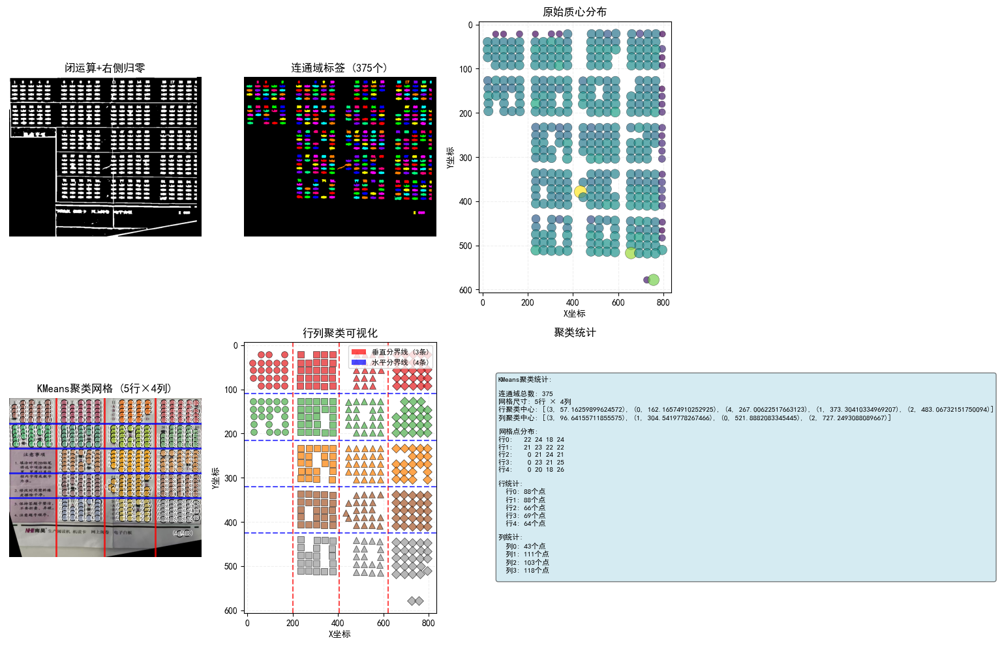


详细聚类结果 (前20个点):
------------------------------------------------------------
序号   标签     行    列    质心X      质心Y      面积    
------------------------------------------------------------
1    2      0    1    233.8    21.5     97    
2    3      0    2    482.3    21.4     201   
3    4      0    2    517.7    21.3     205   
4    5      0    2    553.7    21.6     168   
5    6      0    2    589.5    20.6     198   
6    7      0    3    660.4    21.3     199   
7    8      0    3    695.7    20.7     139   
8    9      0    3    731.2    21.4     194   
9    10     0    3    766.6    21.4     201   
10   12     0    0    58.3     21.7     98    
11   13     0    0    93.3     21.6     98    
12   15     0    0    163.9    21.4     105   
13   17     0    1    304.6    21.4     109   
14   18     0    1    339.9    21.2     104   
15   19     0    1    376.4    21.4     196   
16   20     0    3    795.6    21.6     92    
17   22     0    2    552.8    39.0     202   
18   23     0  

In [241]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from find_region import process_answer_sheet
from sklearn.cluster import KMeans
from scipy.spatial import ConvexHull

# ==================== 1. 参数配置 ====================
PARAMS = {
    'target_size': (820, 680),  # 答题卡标准尺寸
    'clahe_clip': 3.0,          # CLAHE
    'clahe_grid': (8, 8),       
    'adaptive_block': 31,       # 自适应二值化
    'adaptive_c': 15,           
    'morph_kernel': (6, 6),     # 闭运算核大小
    'mask_bottom_ratio': 0.38,  # 底部掩码比例
    'mask_right_ratio': 0.24,   # 右侧掩码比例
    'right_strip_width': 20,    # 最右侧归零宽度
    
    # 连通域参数
    'min_area': 80,     # 最小连通域面积
    'max_area': 400,    # 最大连通域面积
    
    # KMeans聚类参数
    'n_rows': 5,        # 行数（自上而下）
    'n_cols': 4,        # 列数（自左向右）
}

# ==================== 2. 读取和预处理 ====================
img_path = 'images/test6.jpg'
img = cv2.imread(img_path)
print(f"原始图片: {img.shape}")

# 提取答题区域
try:
    res = process_answer_sheet(img_path, show=False)
    sheet_warped = res[0]
    print("✓ 提取答题区域")
except:
    sheet_warped = img
    print("⚠ 使用原始图片")

# 缩放
resized = cv2.resize(sheet_warped, PARAMS['target_size'])

# 应用左下角掩码
h, w = resized.shape[:2]
masked = resized.copy()
mask_bottom = int(h * PARAMS['mask_bottom_ratio'])
mask_right = int(w * PARAMS['mask_right_ratio'])
masked[mask_bottom:, :mask_right] = 255

# 灰度转换
gray = cv2.cvtColor(masked, cv2.COLOR_BGR2GRAY)

# CLAHE增强
clahe = cv2.createCLAHE(clipLimit=PARAMS['clahe_clip'], 
                        tileGridSize=PARAMS['clahe_grid'])
gray_enhanced = clahe.apply(gray)

# 二值化
binary = cv2.adaptiveThreshold(gray_enhanced, 255, 
                               cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                               cv2.THRESH_BINARY_INV, 
                               PARAMS['adaptive_block'], 
                               PARAMS['adaptive_c'])

# 闭运算
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, PARAMS['morph_kernel'])
closed = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel)

# 最右侧归零
closed[:, -PARAMS['right_strip_width']:] = 0
print(f"右侧{PARAMS['right_strip_width']}px归零")

# ==================== 3. 连通域分析 ====================
num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(
    closed, connectivity=8
)

# 过滤和存储连通域
regions = []
for i in range(1, num_labels):
    area = stats[i, cv2.CC_STAT_AREA]
    if PARAMS['min_area'] <= area <= PARAMS['max_area']:
        x = stats[i, cv2.CC_STAT_LEFT]
        y = stats[i, cv2.CC_STAT_TOP]
        w_rect = stats[i, cv2.CC_STAT_WIDTH]
        h_rect = stats[i, cv2.CC_STAT_HEIGHT]
        centroid_x, centroid_y = centroids[i]
        
        regions.append({
            'label': i,
            'area': area,
            'centroid': (centroid_x, centroid_y),
        })

print(f"连通域: {len(regions)}个")

# ==================== 4. KMeans聚类 (5行4列) ====================
if len(regions) >= max(PARAMS['n_rows'], PARAMS['n_cols']):
    print(f"\n进行KMeans聚类: {PARAMS['n_rows']}行 × {PARAMS['n_cols']}列")
    
    # 准备聚类数据
    points = np.array([[r['centroid'][0], r['centroid'][1]] for r in regions])
    x_coords = points[:, 0].reshape(-1, 1)  # X坐标
    y_coords = points[:, 1].reshape(-1, 1)  # Y坐标
    
    # 1. 对Y坐标聚类，得到5行（自上而下）
    print(f"  对Y坐标进行{PARAMS['n_rows']}类聚类...")
    kmeans_y = KMeans(n_clusters=min(PARAMS['n_rows'], len(y_coords)), 
                     random_state=42, n_init=10)
    row_labels_raw = kmeans_y.fit_predict(y_coords)
    
    # 计算每个Y聚类的中心并排序（从上到下：Y值小的在上）
    row_centers = {}
    for label in np.unique(row_labels_raw):
        row_centers[label] = y_coords[row_labels_raw == label].mean()
    
    # 按Y中心值从小到大排序（Y小在上）
    sorted_row_labels = sorted(row_centers.items(), key=lambda x: x[1])
    row_mapping = {old_label: i for i, (old_label, _) in enumerate(sorted_row_labels)}
    
    # 2. 对X坐标聚类，得到4列（自左向右）
    print(f"  对X坐标进行{PARAMS['n_cols']}类聚类...")
    kmeans_x = KMeans(n_clusters=min(PARAMS['n_cols'], len(x_coords)), 
                     random_state=42, n_init=10)
    col_labels_raw = kmeans_x.fit_predict(x_coords)
    
    # 计算每个X聚类的中心并排序（从左到右：X值小的在左）
    col_centers = {}
    for label in np.unique(col_labels_raw):
        col_centers[label] = x_coords[col_labels_raw == label].mean()
    
    # 按X中心值从小到大排序（X小在左）
    sorted_col_labels = sorted(col_centers.items(), key=lambda x: x[1])
    col_mapping = {old_label: i for i, (old_label, _) in enumerate(sorted_col_labels)}
    
    # 3. 为每个区域分配行列标签
    for i, region in enumerate(regions):
        region['row_raw'] = int(row_labels_raw[i])
        region['col_raw'] = int(col_labels_raw[i])
        region['row'] = row_mapping[region['row_raw']]  # 0-4，0在上
        region['col'] = col_mapping[region['col_raw']]  # 0-3，0在左
    
    print(f"  行聚类中心: {sorted_row_labels}")
    print(f"  列聚类中心: {sorted_col_labels}")
    
    # 4. 统计每个网格单元的点数
    grid_counts = np.zeros((PARAMS['n_rows'], PARAMS['n_cols']), dtype=int)
    for region in regions:
        if region['row'] < PARAMS['n_rows'] and region['col'] < PARAMS['n_cols']:
            grid_counts[region['row'], region['col']] += 1
    
    print(f"\n网格点分布 ({PARAMS['n_rows']}行 × {PARAMS['n_cols']}列):")
    for r in range(PARAMS['n_rows']):
        row_text = "  "
        for c in range(PARAMS['n_cols']):
            count = grid_counts[r, c]
            row_text += f"{count:2d} "
        print(f"行{r}: {row_text}")
    
    # 5. 计算网格边界
    # 收集每个行/列的坐标范围
    row_bounds = {}
    col_bounds = {}
    
    for region in regions:
        row = region['row']
        col = region['col']
        cx, cy = region['centroid']
        
        if row not in row_bounds:
            row_bounds[row] = {'min_y': cy, 'max_y': cy}
        else:
            row_bounds[row]['min_y'] = min(row_bounds[row]['min_y'], cy)
            row_bounds[row]['max_y'] = max(row_bounds[row]['max_y'], cy)
            
        if col not in col_bounds:
            col_bounds[col] = {'min_x': cx, 'max_x': cx}
        else:
            col_bounds[col]['min_x'] = min(col_bounds[col]['min_x'], cx)
            col_bounds[col]['max_x'] = max(col_bounds[col]['max_x'], cx)
    
    # 计算行分界线
    horizontal_lines = []
    for r in range(PARAMS['n_rows'] - 1):
        if r in row_bounds and r+1 in row_bounds:
            y_bottom = row_bounds[r]['max_y']  # 当前行的底部
            y_top = row_bounds[r+1]['min_y']   # 下一行的顶部
            boundary = (y_bottom + y_top) / 2
            horizontal_lines.append(boundary)
    
    # 计算列分界线
    vertical_lines = []
    for c in range(PARAMS['n_cols'] - 1):
        if c in col_bounds and c+1 in col_bounds:
            x_right = col_bounds[c]['max_x']   # 当前列的右边界
            x_left = col_bounds[c+1]['min_x']  # 下一列的左边界
            boundary = (x_right + x_left) / 2
            vertical_lines.append(boundary)
    
    print(f"\n计算的分界线:")
    print(f"  水平分界线 ({len(horizontal_lines)}条): {[f'{y:.1f}' for y in sorted(horizontal_lines)]}")
    print(f"  垂直分界线 ({len(vertical_lines)}条): {[f'{x:.1f}' for x in sorted(vertical_lines)]}")
    
else:
    print(f"\n连通域数量({len(regions)})不足，无法进行{PARAMS['n_rows']}×{PARAMS['n_cols']}聚类")
    horizontal_lines = []
    vertical_lines = []

# ==================== 5. 可视化 ====================
fig, axes = plt.subplots(2, 3, figsize=(15, 10))

# 第1行：基本处理结果
# 1. 预处理结果
ax = axes[0, 0]
ax.imshow(closed, cmap='gray')
ax.set_title('闭运算+右侧归零', fontsize=12)
ax.axis('off')

# 2. 连通域标签
ax = axes[0, 1]
if regions:
    label_colors_img = np.zeros((labels.shape[0], labels.shape[1], 3), dtype=np.uint8)
    colors = [
        (255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0),
        (255, 0, 255), (0, 255, 255), (255, 128, 0), (128, 0, 255),
        (0, 255, 128), (255, 0, 128)
    ]
    
    for idx, region in enumerate(regions):
        color_idx = idx % len(colors)
        color = colors[color_idx]
        label_colors_img[labels == region['label']] = color
    
    ax.imshow(label_colors_img)
    ax.set_title(f'连通域标签 ({len(regions)}个)', fontsize=12)
else:
    ax.text(0.5, 0.5, '无连通域', ha='center', va='center', fontsize=12)
    ax.set_title('连通域标签', fontsize=12)
ax.axis('off')

# 3. 原始质心分布
ax = axes[0, 2]
if regions:
    centroids_x = [r['centroid'][0] for r in regions]
    centroids_y = [r['centroid'][1] for r in regions]
    areas = [r['area'] for r in regions]
    
    scatter = ax.scatter(centroids_x, centroids_y, 
                       s=[a/2 for a in areas],
                       c=areas, cmap='viridis', 
                       alpha=0.7, edgecolors='k', linewidth=0.3)
    
    ax.invert_yaxis()
    ax.set_xlabel('X坐标', fontsize=10)
    ax.set_ylabel('Y坐标', fontsize=10)
    ax.set_title('原始质心分布', fontsize=12)
    ax.grid(True, alpha=0.2, linestyle='--')
else:
    ax.text(0.5, 0.5, '无连通域', ha='center', va='center', fontsize=12)
    ax.set_title('质心分布', fontsize=12)
    ax.axis('off')

# 第2行：KMeans聚类结果
# 4. 行列聚类结果
ax = axes[1, 0]
if regions and 'row' in regions[0] and 'col' in regions[0]:
    # 准备颜色映射
    row_cmap = plt.cm.get_cmap('Set1', PARAMS['n_rows'])
    col_cmap = plt.cm.get_cmap('Set2', PARAMS['n_cols'])
    
    # 绘制原始图片
    img_rgb = cv2.cvtColor(resized, cv2.COLOR_BGR2RGB)
    ax.imshow(img_rgb)
    
    # 绘制网格分界线
    img_height, img_width = img_rgb.shape[:2]
    
    # 绘制垂直分界线
    for line_x in vertical_lines:
        ax.axvline(x=line_x, color='red', linestyle='-', linewidth=2, alpha=0.8)
    
    # 绘制水平分界线
    for line_y in horizontal_lines:
        ax.axhline(y=line_y, color='blue', linestyle='-', linewidth=2, alpha=0.8)
    
    # 绘制质心点，按行列着色
    for region in regions:
        cx, cy = region['centroid']
        row = region['row']
        col = region['col']
        
        # 使用行列组合颜色
        row_color = row_cmap(row)
        col_color = col_cmap(col)
        # 混合颜色
        mixed_color = (
            (row_color[0] + col_color[0]) / 2,
            (row_color[1] + col_color[1]) / 2,
            (row_color[2] + col_color[2]) / 2,
            0.8
        )
        
        ax.scatter(cx, cy, s=50, color=mixed_color, 
                  edgecolors='black', linewidth=1, alpha=0.8, marker='o')
        
        # 添加行列标签
        ax.text(cx, cy, f'({row},{col})', 
               ha='center', va='center', fontsize=7, 
               color='white', weight='bold')
    
    ax.set_title(f'KMeans聚类网格 ({PARAMS["n_rows"]}行×{PARAMS["n_cols"]}列)', fontsize=12)
    ax.axis('off')
else:
    ax.text(0.5, 0.5, '聚类条件不满足', ha='center', va='center', fontsize=12)
    ax.set_title('KMeans聚类网格', fontsize=12)
    ax.axis('off')

# 5. 行列聚类可视化
ax = axes[1, 1]
if regions and 'row' in regions[0] and 'col' in regions[0]:
    # 准备颜色
    row_cmap = plt.cm.get_cmap('Set1', PARAMS['n_rows'])
    col_cmap = plt.cm.get_cmap('Set2', PARAMS['n_cols'])
    
    # 绘制每个点，用行颜色和列形状
    for region in regions:
        cx, cy = region['centroid']
        row = region['row']
        col = region['col']
        
        # 行决定颜色
        row_color = row_cmap(row)
        # 列决定形状
        markers = ['o', 's', '^', 'D', 'v', '<', '>', 'p', '*', 'h']
        marker = markers[col % len(markers)]
        
        ax.scatter(cx, cy, s=50, color=row_color, 
                  marker=marker, edgecolors='black', linewidth=0.5, alpha=0.7,
                  label=f'行{row}列{col}' if region == regions[0] else "")
    
    # 绘制分界线
    for line_x in vertical_lines:
        ax.axvline(x=line_x, color='red', linestyle='--', linewidth=1.5, alpha=0.7)
    for line_y in horizontal_lines:
        ax.axhline(y=line_y, color='blue', linestyle='--', linewidth=1.5, alpha=0.7)
    
    ax.invert_yaxis()
    ax.set_xlabel('X坐标', fontsize=10)
    ax.set_ylabel('Y坐标', fontsize=10)
    ax.set_title(f'行列聚类可视化', fontsize=12)
    ax.grid(True, alpha=0.2, linestyle='--')
    
    # 添加图例
    from matplotlib.patches import Patch
    legend_elements = [
        Patch(facecolor='red', alpha=0.7, label=f'垂直分界线 ({len(vertical_lines)}条)'),
        Patch(facecolor='blue', alpha=0.7, label=f'水平分界线 ({len(horizontal_lines)}条)'),
    ]
    ax.legend(handles=legend_elements, loc='upper right', fontsize=8)
else:
    ax.text(0.5, 0.5, '聚类条件不满足', ha='center', va='center', fontsize=12)
    ax.set_title('行列聚类可视化', fontsize=12)
    ax.axis('off')

# 6. 聚类统计信息
ax = axes[1, 2]
ax.axis('off')

if regions and 'row' in regions[0] and 'col' in regions[0]:
    # 计算网格统计
    grid_counts = np.zeros((PARAMS['n_rows'], PARAMS['n_cols']), dtype=int)
    for region in regions:
        if region['row'] < PARAMS['n_rows'] and region['col'] < PARAMS['n_cols']:
            grid_counts[region['row'], region['col']] += 1
    
    stats_text = f"KMeans聚类统计:\n\n"
    stats_text += f"连通域总数: {len(regions)}\n"
    stats_text += f"网格尺寸: {PARAMS['n_rows']}行 × {PARAMS['n_cols']}列\n"
    stats_text += f"行聚类中心: {sorted_row_labels}\n"
    stats_text += f"列聚类中心: {sorted_col_labels}\n\n"
    
    stats_text += f"网格点分布:\n"
    for r in range(PARAMS['n_rows']):
        row_text = "  "
        for c in range(PARAMS['n_cols']):
            count = grid_counts[r, c]
            row_text += f"{count:2d} "
        stats_text += f"行{r}: {row_text}\n"
    
    # 计算每行每列的点数
    row_counts = grid_counts.sum(axis=1)
    col_counts = grid_counts.sum(axis=0)
    
    stats_text += f"\n行统计:\n"
    for r in range(PARAMS['n_rows']):
        stats_text += f"  行{r}: {row_counts[r]}个点\n"
    
    stats_text += f"\n列统计:\n"
    for c in range(PARAMS['n_cols']):
        stats_text += f"  列{c}: {col_counts[c]}个点\n"
    
    ax.text(0.1, 0.5, stats_text, fontsize=8, 
           verticalalignment='center',
           bbox=dict(boxstyle='round', facecolor='lightblue', alpha=0.5))
    ax.set_title('聚类统计', fontsize=12)
else:
    ax.text(0.5, 0.5, '无聚类结果', ha='center', va='center', fontsize=12)
    ax.set_title('聚类统计', fontsize=12)

plt.tight_layout()
plt.show()

# ==================== 6. 打印详细结果 ====================
if regions and 'row' in regions[0] and 'col' in regions[0]:
    print(f"\n详细聚类结果 (前20个点):")
    print("-" * 60)
    print(f"{'序号':<4} {'标签':<6} {'行':<4} {'列':<4} {'质心X':<8} {'质心Y':<8} {'面积':<6}")
    print("-" * 60)
    
    for i, region in enumerate(regions[:20]):
        cx, cy = region['centroid']
        print(f"{i+1:<4} {region['label']:<6} {region['row']:<4} {region['col']:<4} "
              f"{cx:<8.1f} {cy:<8.1f} {region['area']:<6}")
    
    if len(regions) > 20:
        print(f"... 还有 {len(regions) - 20} 个点未显示")

# ==================== 7. 简单统计 ====================
if regions:
    centroids_x = [r['centroid'][0] for r in regions]
    centroids_y = [r['centroid'][1] for r in regions]
    print(f"\n质心统计:")
    print(f"  X范围: {min(centroids_x):.0f}-{max(centroids_x):.0f}")
    print(f"  Y范围: {min(centroids_y):.0f}-{max(centroids_y):.0f}")

原始图片: (1919, 1080, 3)
✓ 提取答题区域
右侧20px归零
连通域: 424个

进行KMeans聚类: 5行 × 4列

网格点分布 (5行 × 4列):
行0:   24 25 25 25 
行1:   25 25 25 25 
行2:    0 25 25 25 
行3:    0 25 25 25 
行4:    0 25 25 25 

原始分界线:
  水平分界线: ['0.0', '132.6', '263.7', '394.9', '527.4', '680.0']
  垂直分界线: ['0.0', '201.5', '410.0', '619.8', '820.0']

扩展后的分界线 (扩展10像素):
  水平分界线: ['0.0', '132.6', '263.7', '394.9', '527.4', '680.0']
  垂直分界线: ['0.0', '201.5', '410.0', '619.8', '820.0']
  忽略区域(2,0): 点数不足 (0 < 5)
  忽略区域(3,0): 点数不足 (0 < 5)
  忽略区域(4,0): 点数不足 (0 < 5)

有效区域统计:
  总区域数: 5×4 = 20
  有效区域数: 17
  过滤阈值: 点数 ≥ 5

有效区域详细信息:
--------------------------------------------------------------------------------
区域ID     位置(行,列)      边界(x1,y1,x2,y2)           尺寸           点数    
--------------------------------------------------------------------------------


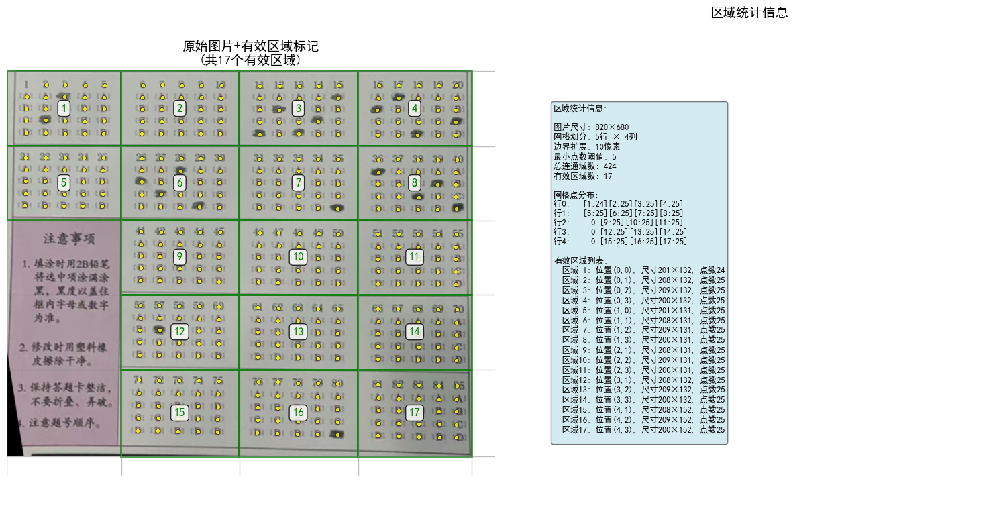

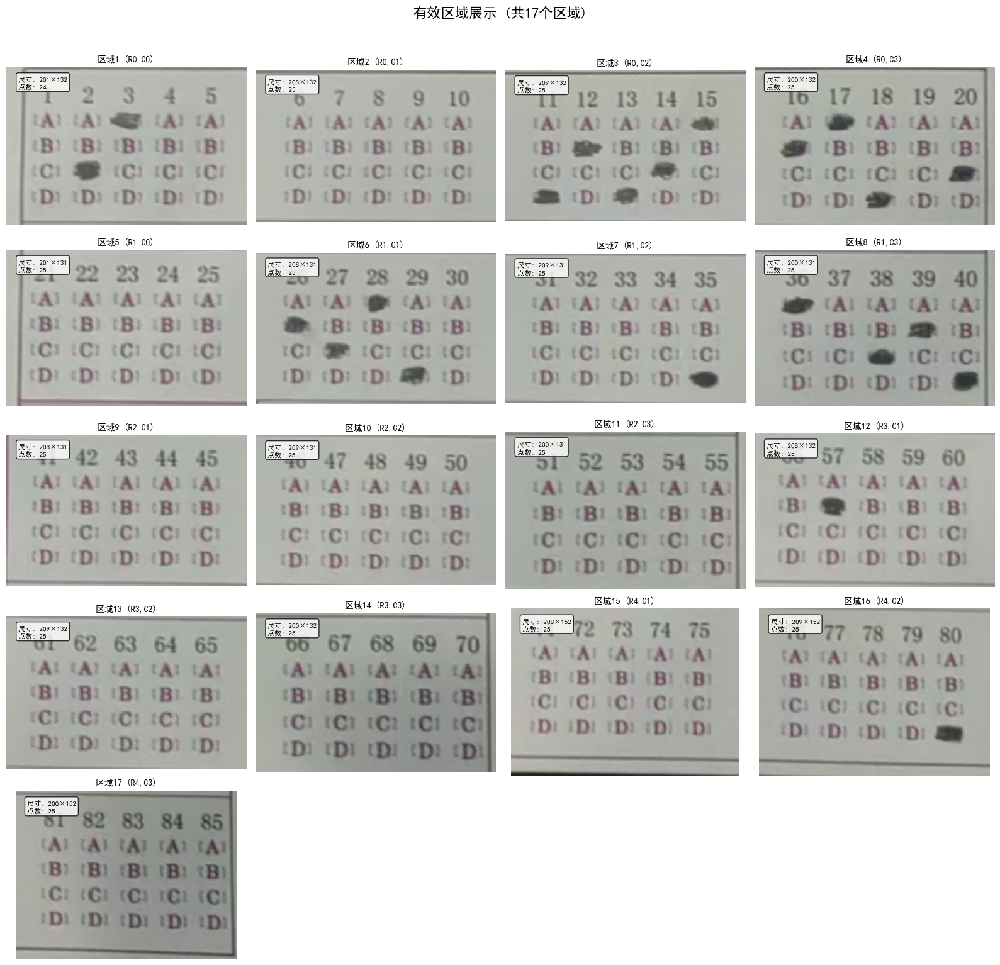

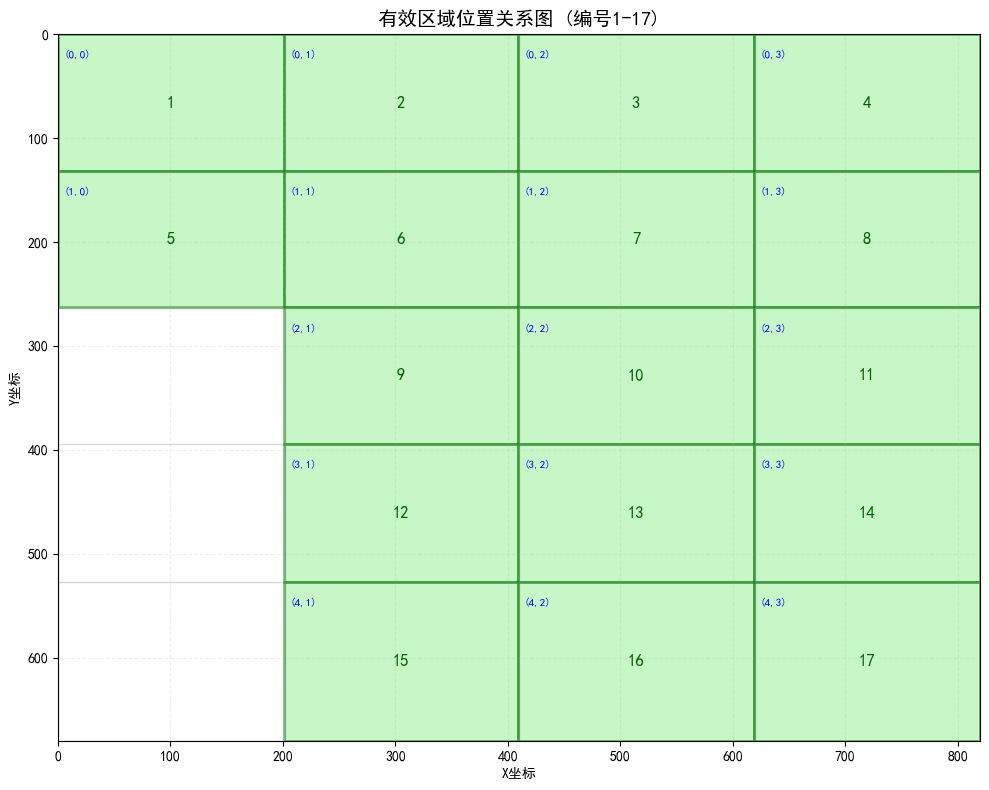


处理完成!
原始图片: (1919, 1080, 3)
处理后尺寸: (680, 820, 3)
检测到连通域: 424个
网格划分: 5行 × 4列
有效区域数: 17个
边界扩展: 10像素
最小点数阈值: 5


In [281]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from find_region import process_answer_sheet
from sklearn.cluster import KMeans

# ==================== 1. 参数配置 ====================
PARAMS = {
    'target_size': (820, 680),  # 答题卡标准尺寸
    'clahe_clip': 3.0,          # CLAHE
    'clahe_grid': (8, 8),       
    'adaptive_block': 31,       # 自适应二值化
    'adaptive_c': 15,           
    'morph_kernel': (6, 6),     # 闭运算核大小
    'mask_bottom_ratio': 0.38,  # 底部掩码比例
    'mask_right_ratio': 0.24,   # 右侧掩码比例
    'right_strip_width': 20,    # 最右侧归零宽度
    
    # 连通域参数
    'min_area': 80,     # 最小连通域面积
    'max_area': 400,    # 最大连通域面积
    
    # KMeans聚类参数
    'n_rows': 5,        # 行数（自上而下）
    'n_cols': 4,        # 列数（自左向右）
    
    # 区域裁剪参数
    'min_points_per_region': 5,  # 区域最小点数阈值
    'border_expand': 10,         # 边界扩展像素数
}

# ==================== 2. 读取和预处理 ====================
img_path = 'images/test13.jpg'
img = cv2.imread(img_path)
print(f"原始图片: {img.shape}")

# 提取答题区域
try:
    res = process_answer_sheet(img_path, show=False)
    sheet_warped = res[0]
    print("✓ 提取答题区域")
except:
    sheet_warped = img
    print("⚠ 使用原始图片")

# 缩放
resized = cv2.resize(sheet_warped, PARAMS['target_size'])

# 应用左下角掩码
h, w = resized.shape[:2]
masked = resized.copy()
mask_bottom = int(h * PARAMS['mask_bottom_ratio'])
mask_right = int(w * PARAMS['mask_right_ratio'])
masked[mask_bottom:, :mask_right] = 255

# 灰度转换
gray = cv2.cvtColor(masked, cv2.COLOR_BGR2GRAY)

# CLAHE增强
clahe = cv2.createCLAHE(clipLimit=PARAMS['clahe_clip'], 
                        tileGridSize=PARAMS['clahe_grid'])
gray_enhanced = clahe.apply(gray)

# 二值化
binary = cv2.adaptiveThreshold(gray_enhanced, 255, 
                               cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                               cv2.THRESH_BINARY_INV, 
                               PARAMS['adaptive_block'], 
                               PARAMS['adaptive_c'])

# 闭运算
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, PARAMS['morph_kernel'])
closed = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel)

# 最右侧归零
closed[:, -PARAMS['right_strip_width']:] = 0
print(f"右侧{PARAMS['right_strip_width']}px归零")

# ==================== 3. 连通域分析 ====================
num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(
    closed, connectivity=8
)

# 过滤和存储连通域
regions = []
for i in range(1, num_labels):
    area = stats[i, cv2.CC_STAT_AREA]
    if PARAMS['min_area'] <= area <= PARAMS['max_area']:
        x = stats[i, cv2.CC_STAT_LEFT]
        y = stats[i, cv2.CC_STAT_TOP]
        w_rect = stats[i, cv2.CC_STAT_WIDTH]
        h_rect = stats[i, cv2.CC_STAT_HEIGHT]
        centroid_x, centroid_y = centroids[i]
        
        regions.append({
            'label': i,
            'area': area,
            'centroid': (centroid_x, centroid_y),
        })

print(f"连通域: {len(regions)}个")

# ==================== 4. KMeans聚类 (5行4列) ====================
if len(regions) >= max(PARAMS['n_rows'], PARAMS['n_cols']):
    print(f"\n进行KMeans聚类: {PARAMS['n_rows']}行 × {PARAMS['n_cols']}列")
    
    # 准备聚类数据
    points = np.array([[r['centroid'][0], r['centroid'][1]] for r in regions])
    x_coords = points[:, 0].reshape(-1, 1)  # X坐标
    y_coords = points[:, 1].reshape(-1, 1)  # Y坐标
    
    # 1. 对Y坐标聚类，得到5行（自上而下）
    kmeans_y = KMeans(n_clusters=min(PARAMS['n_rows'], len(y_coords)), 
                     random_state=42, n_init=10)
    row_labels_raw = kmeans_y.fit_predict(y_coords)
    
    # 计算每个Y聚类的中心并排序（从上到下：Y值小的在上）
    row_centers = {}
    for label in np.unique(row_labels_raw):
        row_centers[label] = y_coords[row_labels_raw == label].mean()
    
    # 按Y中心值从小到大排序（Y小在上）
    sorted_row_labels = sorted(row_centers.items(), key=lambda x: x[1])
    row_mapping = {old_label: i for i, (old_label, _) in enumerate(sorted_row_labels)}
    
    # 2. 对X坐标聚类，得到4列（自左向右）
    kmeans_x = KMeans(n_clusters=min(PARAMS['n_cols'], len(x_coords)), 
                     random_state=42, n_init=10)
    col_labels_raw = kmeans_x.fit_predict(x_coords)
    
    # 计算每个X聚类的中心并排序（从左到右：X值小的在左）
    col_centers = {}
    for label in np.unique(col_labels_raw):
        col_centers[label] = x_coords[col_labels_raw == label].mean()
    
    # 按X中心值从小到大排序（X小在左）
    sorted_col_labels = sorted(col_centers.items(), key=lambda x: x[1])
    col_mapping = {old_label: i for i, (old_label, _) in enumerate(sorted_col_labels)}
    
    # 3. 为每个区域分配行列标签
    for i, region in enumerate(regions):
        region['row_raw'] = int(row_labels_raw[i])
        region['col_raw'] = int(col_labels_raw[i])
        region['row'] = row_mapping[region['row_raw']]  # 0-4，0在上
        region['col'] = col_mapping[region['col_raw']]  # 0-3，0在左
    
    # 4. 统计每个网格单元的点数
    grid_counts = np.zeros((PARAMS['n_rows'], PARAMS['n_cols']), dtype=int)
    for region in regions:
        if region['row'] < PARAMS['n_rows'] and region['col'] < PARAMS['n_cols']:
            grid_counts[region['row'], region['col']] += 1
    
    print(f"\n网格点分布 ({PARAMS['n_rows']}行 × {PARAMS['n_cols']}列):")
    for r in range(PARAMS['n_rows']):
        row_text = "  "
        for c in range(PARAMS['n_cols']):
            count = grid_counts[r, c]
            row_text += f"{count:2d} "
        print(f"行{r}: {row_text}")
    
    # 5. 计算网格边界
    # 收集每个行/列的坐标范围
    row_bounds = {}
    col_bounds = {}
    
    for region in regions:
        row = region['row']
        col = region['col']
        cx, cy = region['centroid']
        
        if row not in row_bounds:
            row_bounds[row] = {'min_y': cy, 'max_y': cy}
        else:
            row_bounds[row]['min_y'] = min(row_bounds[row]['min_y'], cy)
            row_bounds[row]['max_y'] = max(row_bounds[row]['max_y'], cy)
            
        if col not in col_bounds:
            col_bounds[col] = {'min_x': cx, 'max_x': cx}
        else:
            col_bounds[col]['min_x'] = min(col_bounds[col]['min_x'], cx)
            col_bounds[col]['max_x'] = max(col_bounds[col]['max_x'], cx)
    
    # 计算行分界线
    horizontal_lines = []
    for r in range(PARAMS['n_rows'] - 1):
        if r in row_bounds and r+1 in row_bounds:
            y_bottom = row_bounds[r]['max_y']  # 当前行的底部
            y_top = row_bounds[r+1]['min_y']   # 下一行的顶部
            boundary = (y_bottom + y_top) / 2
            horizontal_lines.append(boundary)
    
    # 计算列分界线
    vertical_lines = []
    for c in range(PARAMS['n_cols'] - 1):
        if c in col_bounds and c+1 in col_bounds:
            x_right = col_bounds[c]['max_x']   # 当前列的右边界
            x_left = col_bounds[c+1]['min_x']  # 下一列的左边界
            boundary = (x_right + x_left) / 2
            vertical_lines.append(boundary)
    
    # 添加图像边界
    all_horizontal = [0] + sorted(horizontal_lines) + [h]
    all_vertical = [0] + sorted(vertical_lines) + [w]
    
    print(f"\n原始分界线:")
    print(f"  水平分界线: {[f'{y:.1f}' for y in all_horizontal]}")
    print(f"  垂直分界线: {[f'{x:.1f}' for x in all_vertical]}")
    
else:
    print(f"\n连通域数量({len(regions)})不足，无法进行{PARAMS['n_rows']}×{PARAMS['n_cols']}聚类")
    all_horizontal = [0, h]
    all_vertical = [0, w]

# ==================== 5. 区域裁剪和过滤 ====================
# 1. 计算扩展后的分界线
expand = PARAMS['border_expand']
expanded_horizontal = []
expanded_vertical = []

# 水平分界线扩展
for i, y in enumerate(all_horizontal):
    if i == 0:  # 顶部边界
        expanded_y = max(0, y - expand)
    elif i == len(all_horizontal) - 1:  # 底部边界
        expanded_y = min(h, y + expand)
    else:  # 中间分界线
        # 向上下两个方向扩展
        expanded_y = y
    expanded_horizontal.append(expanded_y)

# 垂直分界线扩展
for i, x in enumerate(all_vertical):
    if i == 0:  # 左侧边界
        expanded_x = max(0, x - expand)
    elif i == len(all_vertical) - 1:  # 右侧边界
        expanded_x = min(w, x + expand)
    else:  # 中间分界线
        # 向左右两个方向扩展
        expanded_x = x
    expanded_vertical.append(expanded_x)

print(f"\n扩展后的分界线 (扩展{expand}像素):")
print(f"  水平分界线: {[f'{y:.1f}' for y in expanded_horizontal]}")
print(f"  垂直分界线: {[f'{x:.1f}' for x in expanded_vertical]}")

# 2. 定义区域并过滤
valid_regions = []
region_counter = 1  # 区域编号从1开始

# 创建网格映射
grid_regions = [[None for _ in range(PARAMS['n_cols'])] for _ in range(PARAMS['n_rows'])]

for r in range(PARAMS['n_rows']):
    for c in range(PARAMS['n_cols']):
        # 计算区域边界
        y1 = expanded_horizontal[r]
        y2 = expanded_horizontal[r + 1]
        x1 = expanded_vertical[c]
        x2 = expanded_vertical[c + 1]
        
        # 计算该区域的点数
        point_count = 0
        for region in regions:
            cx, cy = region['centroid']
            if x1 <= cx <= x2 and y1 <= cy <= y2:
                point_count += 1
        
        # 只保留点数足够的区域
        if point_count >= PARAMS['min_points_per_region']:
            region_info = {
                'region_id': region_counter,
                'row': r,
                'col': c,
                'x1': int(x1),
                'y1': int(y1),
                'x2': int(x2),
                'y2': int(y2),
                'width': int(x2 - x1),
                'height': int(y2 - y1),
                'point_count': point_count,
                'cropped': None
            }
            
            # 裁剪区域
            cropped = resized[int(y1):int(y2), int(x1):int(x2)]
            region_info['cropped'] = cropped
            
            valid_regions.append(region_info)
            grid_regions[r][c] = region_info
            
            region_counter += 1
        else:
            print(f"  忽略区域({r},{c}): 点数不足 ({point_count} < {PARAMS['min_points_per_region']})")

print(f"\n有效区域统计:")
print(f"  总区域数: {PARAMS['n_rows']}×{PARAMS['n_cols']} = {PARAMS['n_rows']*PARAMS['n_cols']}")
print(f"  有效区域数: {len(valid_regions)}")
print(f"  过滤阈值: 点数 ≥ {PARAMS['min_points_per_region']}")

# 3. 打印有效区域信息
print(f"\n有效区域详细信息:")
print("-" * 80)
print(f"{'区域ID':<8} {'位置(行,列)':<12} {'边界(x1,y1,x2,y2)':<25} {'尺寸':<12} {'点数':<6}")
print("-" * 80)

for region in valid_regions:
    pass
# ==================== 6. 可视化结果 ====================
# 1. 在原始图片上绘制有效区域
fig1, axes1 = plt.subplots(1, 2, figsize=(15, 8))

# 左图：原始图片+网格+有效区域标记
ax = axes1[0]
img_rgb = cv2.cvtColor(resized, cv2.COLOR_BGR2RGB)
ax.imshow(img_rgb)

# 绘制所有网格线
for y in all_horizontal:
    ax.axhline(y=y, color='gray', linestyle='-', linewidth=1, alpha=0.5)
for x in all_vertical:
    ax.axvline(x=x, color='gray', linestyle='-', linewidth=1, alpha=0.5)

# 绘制有效区域边界
for region in valid_regions:
    x1, y1, x2, y2 = region['x1'], region['y1'], region['x2'], region['y2']
    
    # 绘制矩形框
    rect = plt.Rectangle((x1, y1), x2-x1, y2-y1, 
                        linewidth=2, edgecolor='green', 
                        facecolor='none', alpha=0.8)
    ax.add_patch(rect)
    
    # 添加区域编号
    ax.text(x1 + (x2-x1)/2, y1 + (y2-y1)/2, f"{region['region_id']}", 
           ha='center', va='center', fontsize=12, 
           color='green', weight='bold',
           bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

# 绘制质心点
if regions:
    centroids_x = [r['centroid'][0] for r in regions]
    centroids_y = [r['centroid'][1] for r in regions]
    ax.scatter(centroids_x, centroids_y, s=20, c='yellow', 
               edgecolors='black', linewidth=0.5, alpha=0.8, marker='o')

ax.set_title(f'原始图片+有效区域标记\n(共{len(valid_regions)}个有效区域)', fontsize=14)
ax.axis('off')

# 右图：网格统计图
ax = axes1[1]
ax.axis('off')

# 创建统计文本
stats_text = f"区域统计信息:\n\n"
stats_text += f"图片尺寸: {w}×{h}\n"
stats_text += f"网格划分: {PARAMS['n_rows']}行 × {PARAMS['n_cols']}列\n"
stats_text += f"边界扩展: {expand}像素\n"
stats_text += f"最小点数阈值: {PARAMS['min_points_per_region']}\n"
stats_text += f"总连通域数: {len(regions)}\n"
stats_text += f"有效区域数: {len(valid_regions)}\n\n"

# 创建网格状态图
if 'grid_counts' in locals():
    stats_text += f"网格点分布:\n"
    for r in range(PARAMS['n_rows']):
        row_text = "  "
        for c in range(PARAMS['n_cols']):
            count = grid_counts[r, c]
            if count >= PARAMS['min_points_per_region']:
                # 找到对应的区域ID
                region_id = "?"
                for region in valid_regions:
                    if region['row'] == r and region['col'] == c:
                        region_id = region['region_id']
                        break
                row_text += f"[{region_id}:{count}]"
            else:
                row_text += f" {count:2d} "
        stats_text += f"行{r}: {row_text}\n"

# 添加有效区域列表
if valid_regions:
    stats_text += f"\n有效区域列表:\n"
    for region in valid_regions:
        stats_text += f"  区域{region['region_id']:2d}: 位置({region['row']},{region['col']}), "
        stats_text += f"尺寸{region['width']}×{region['height']}, "
        stats_text += f"点数{region['point_count']}\n"

ax.text(0.1, 0.5, stats_text, fontsize=9, 
       verticalalignment='center',
       bbox=dict(boxstyle='round', facecolor='lightblue', alpha=0.5))

ax.set_title('区域统计信息', fontsize=14)

plt.tight_layout()
plt.show()

# 2. 展示所有有效区域
if valid_regions:
    # 计算展示布局
    n_valid = len(valid_regions)
    n_cols_show = min(4, n_valid)  # 每行最多显示4个
    n_rows_show = (n_valid + n_cols_show - 1) // n_cols_show
    
    fig2, axes2 = plt.subplots(n_rows_show, n_cols_show, figsize=(n_cols_show*4, n_rows_show*3))
    
    # 如果是单行，将axes2转换为2D数组
    if n_rows_show == 1 and n_cols_show == 1:
        axes2 = np.array([[axes2]])
    elif n_rows_show == 1:
        axes2 = axes2.reshape(1, -1)
    elif n_cols_show == 1:
        axes2 = axes2.reshape(-1, 1)
    
    # 展平axes2以便遍历
    axes_flat = axes2.flatten()
    
    for idx, region in enumerate(valid_regions):
        ax = axes_flat[idx]
        
        # 显示裁剪的区域
        cropped_rgb = cv2.cvtColor(region['cropped'], cv2.COLOR_BGR2RGB)
        ax.imshow(cropped_rgb)
        
        # 添加标题
        ax.set_title(f'区域{region["region_id"]} (R{region["row"]},C{region["col"]})', fontsize=10)
        
        # 添加信息文本
        info_text = f"尺寸: {region['width']}×{region['height']}\n"
        info_text += f"点数: {region['point_count']}"
        
        ax.text(0.05, 0.95, info_text, transform=ax.transAxes,
               fontsize=8, verticalalignment='top',
               bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        ax.axis('off')
    
    # 隐藏多余的子图
    for idx in range(len(valid_regions), len(axes_flat)):
        axes_flat[idx].axis('off')
    
    plt.suptitle(f'有效区域展示 (共{len(valid_regions)}个区域)', fontsize=16, y=1.02)
    plt.tight_layout()
    plt.show()
    
    # 3. 展示区域位置关系图
    fig3, ax3 = plt.subplots(figsize=(10, 8))
    
    # 绘制网格
    for y in all_horizontal:
        ax3.axhline(y=y, color='gray', linestyle='-', linewidth=1, alpha=0.3)
    for x in all_vertical:
        ax3.axvline(x=x, color='gray', linestyle='-', linewidth=1, alpha=0.3)
    
    # 绘制有效区域
    for region in valid_regions:
        x1, y1, x2, y2 = region['x1'], region['y1'], region['x2'], region['y2']
        
        # 绘制矩形
        rect = plt.Rectangle((x1, y1), x2-x1, y2-y1, 
                            linewidth=2, edgecolor='green', 
                            facecolor='lightgreen', alpha=0.5)
        ax3.add_patch(rect)
        
        # 添加区域编号
        ax3.text(x1 + (x2-x1)/2, y1 + (y2-y1)/2, f"{region['region_id']}", 
                ha='center', va='center', fontsize=12, 
                color='darkgreen', weight='bold')
        
        # 添加位置标签
        ax3.text(x1 + 5, y1 + 15, f"({region['row']},{region['col']})", 
                ha='left', va='top', fontsize=8, 
                color='blue', weight='bold')
    
    # 设置坐标轴
    ax3.set_xlim(0, w)
    ax3.set_ylim(h, 0)  # 反转Y轴
    ax3.set_xlabel('X坐标', fontsize=10)
    ax3.set_ylabel('Y坐标', fontsize=10)
    ax3.set_title(f'有效区域位置关系图 (编号1-{len(valid_regions)})', fontsize=14)
    ax3.grid(True, alpha=0.2, linestyle='--')
    
    plt.tight_layout()
    plt.show()

# ==================== 7. 保存结果 ====================
# 可以选择保存裁剪的区域
save_regions = False
if save_regions and valid_regions:
    import os
    output_dir = "output_regions"
    os.makedirs(output_dir, exist_ok=True)
    
    for region in valid_regions:
        filename = os.path.join(output_dir, f"region_{region['region_id']:02d}_R{region['row']}_C{region['col']}.jpg")
        cv2.imwrite(filename, region['cropped'])
        print(f"保存: {filename}")
    
    print(f"\n所有有效区域已保存到 '{output_dir}' 目录")

# ==================== 8. 总结 ====================
print(f"\n" + "="*60)
print("处理完成!")
print("="*60)
print(f"原始图片: {img.shape}")
print(f"处理后尺寸: {resized.shape}")
print(f"检测到连通域: {len(regions)}个")
print(f"网格划分: {PARAMS['n_rows']}行 × {PARAMS['n_cols']}列")
print(f"有效区域数: {len(valid_regions)}个")
print(f"边界扩展: {PARAMS['border_expand']}像素")
print(f"最小点数阈值: {PARAMS['min_points_per_region']}")

原始图片: (1919, 1080, 3)
✓ 提取答题区域
右侧20px归零

完整预处理流程可视化


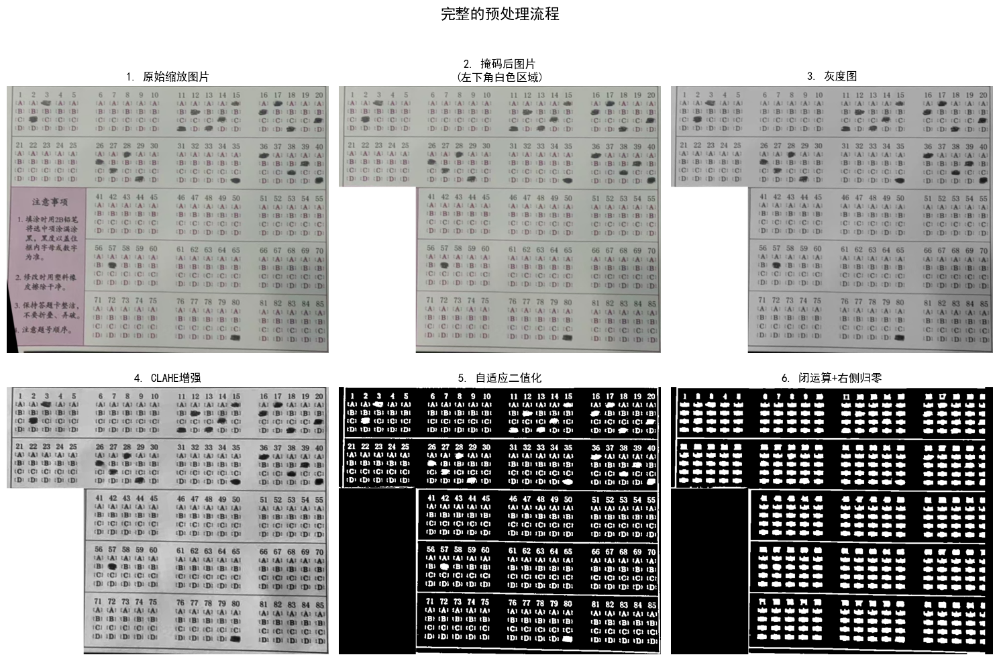

连通域: 424个

连通域标签可视化


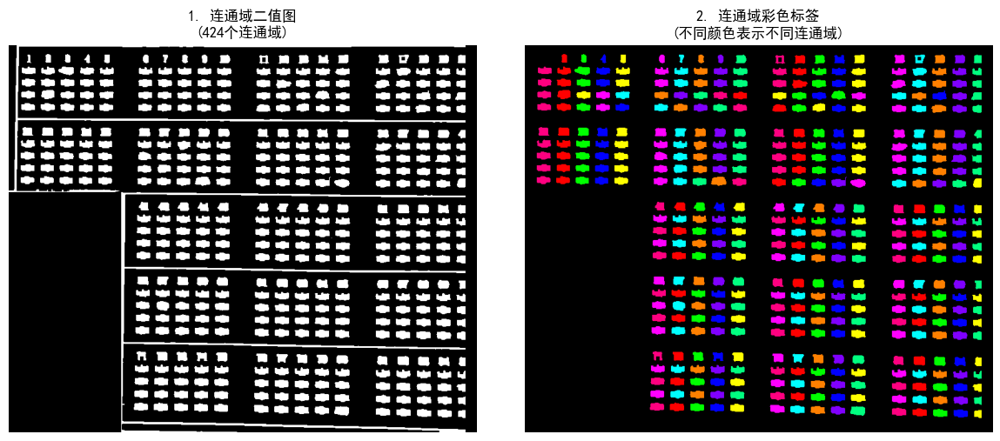


进行KMeans聚类: 5行 × 4列

网格点分布 (5行 × 4列):
行0:   24 25 25 25 
行1:   25 25 25 25 
行2:    0 25 25 25 
行3:    0 25 25 25 
行4:    0 25 25 25 

原始分界线:
  水平分界线: ['0.0', '132.6', '263.7', '394.9', '527.4', '680.0']
  垂直分界线: ['0.0', '201.5', '410.0', '619.8', '820.0']

扩展后的分界线 (扩展10像素):
  水平分界线: ['0.0', '132.6', '263.7', '394.9', '527.4', '680.0']
  垂直分界线: ['0.0', '201.5', '410.0', '619.8', '820.0']
  忽略区域(2,0): 点数不足 (0 < 5)
  忽略区域(3,0): 点数不足 (0 < 5)
  忽略区域(4,0): 点数不足 (0 < 5)

有效区域统计:
  总区域数: 5×4 = 20
  有效区域数: 17
  过滤阈值: 点数 ≥ 5

宽高比检测和调整:
  目标宽高比: 1.5
  宽高比阈值: 1.0
  区域1: 宽高比1.52 ≥ 1.0，无需调整
  区域2: 宽高比1.58 ≥ 1.0，无需调整
  区域3: 宽高比1.58 ≥ 1.0，无需调整
  区域4: 宽高比1.52 ≥ 1.0，无需调整
  区域5: 宽高比1.53 ≥ 1.0，无需调整
  区域6: 宽高比1.59 ≥ 1.0，无需调整
  区域7: 宽高比1.60 ≥ 1.0，无需调整
  区域8: 宽高比1.53 ≥ 1.0，无需调整
  区域9: 宽高比1.59 ≥ 1.0，无需调整
  区域10: 宽高比1.60 ≥ 1.0，无需调整
  区域11: 宽高比1.53 ≥ 1.0，无需调整
  区域12: 宽高比1.58 ≥ 1.0，无需调整
  区域13: 宽高比1.58 ≥ 1.0，无需调整
  区域14: 宽高比1.52 ≥ 1.0，无需调整
  区域15: 宽高比1.37 ≥ 1.0，无需调整
  区域16: 宽高比1.38 ≥ 1.0，无需调整
  区域17: 宽高比1.32 ≥ 

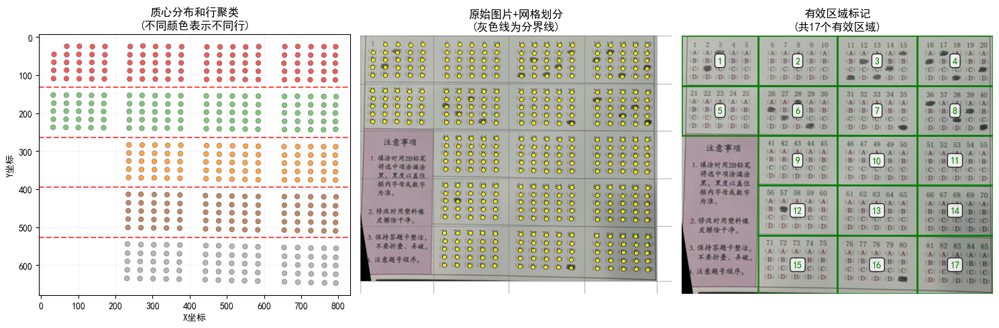

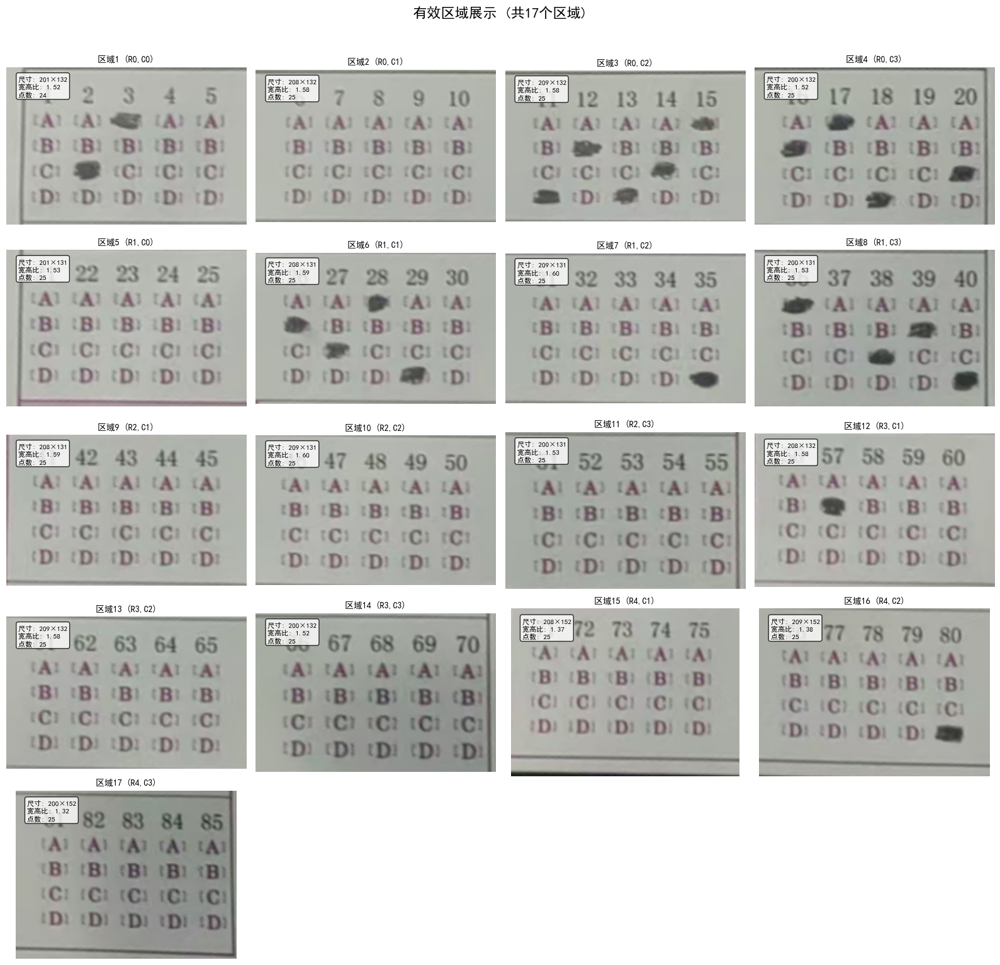

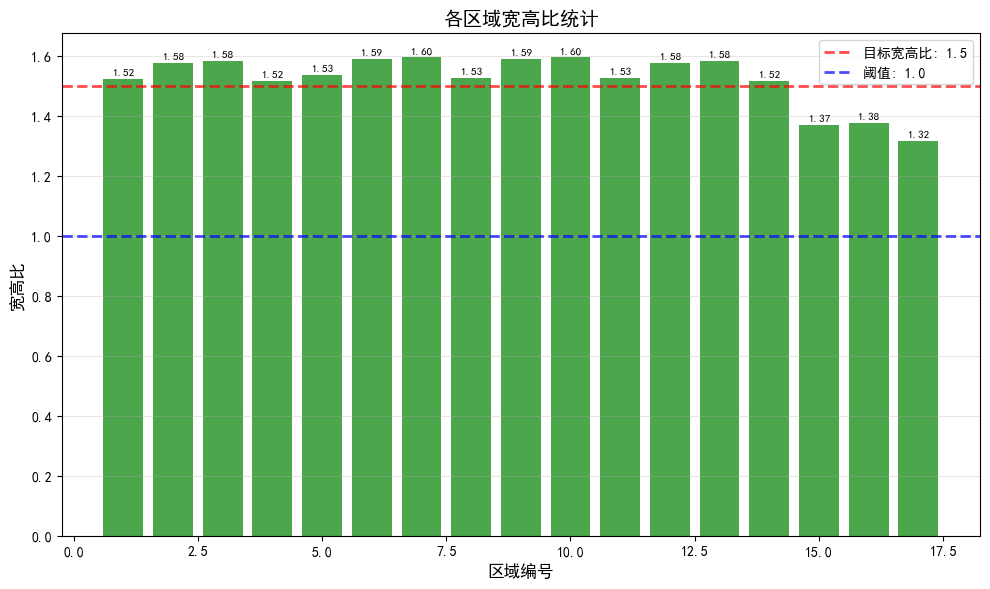


存储17个区域为图像变量
region_01: 尺寸(132, 201, 3), 位置(R0,C0)
region_02: 尺寸(132, 208, 3), 位置(R0,C1)
region_03: 尺寸(132, 210, 3), 位置(R0,C2)
region_04: 尺寸(132, 201, 3), 位置(R0,C3)
region_05: 尺寸(131, 201, 3), 位置(R1,C0)
region_06: 尺寸(131, 208, 3), 位置(R1,C1)
region_07: 尺寸(131, 210, 3), 位置(R1,C2)
region_08: 尺寸(131, 201, 3), 位置(R1,C3)
region_09: 尺寸(131, 208, 3), 位置(R2,C1)
region_10: 尺寸(131, 210, 3), 位置(R2,C2)
region_11: 尺寸(131, 201, 3), 位置(R2,C3)
region_12: 尺寸(133, 208, 3), 位置(R3,C1)
region_13: 尺寸(133, 210, 3), 位置(R3,C2)
region_14: 尺寸(133, 201, 3), 位置(R3,C3)
region_15: 尺寸(153, 208, 3), 位置(R4,C1)
region_16: 尺寸(153, 210, 3), 位置(R4,C2)
region_17: 尺寸(153, 201, 3), 位置(R4,C3)

已创建 17 个区域图像变量:
  1. 单个变量: region_01 到 region_17
  2. 字典: all_regions_dict (包含所有区域)
  3. 列表: all_regions_list (包含所有区域)

处理完成!
原始图片: (1919, 1080, 3)
处理后尺寸: (680, 820, 3)
检测到连通域: 424个
网格划分: 5行 × 4列
有效区域数: 17个
宽高比调整: 0个区域被调整
边界扩展: 10像素
最小点数阈值: 5
宽高比范围: 1.32 - 1.60
平均宽高比: 1.52

验证: region_01 变量类型: <class 'numpy.ndarray'>
验证: region_01 形状: (1

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from find_region import process_answer_sheet
from sklearn.cluster import KMeans

# ==================== 1. 参数配置 ====================
PARAMS = {
    'target_size': (820, 680),  # 答题卡标准尺寸
    'clahe_clip': 3.0,          # CLAHE
    'clahe_grid': (8, 8),       
    'adaptive_block': 31,       # 自适应二值化
    'adaptive_c': 15,           
    'morph_kernel': (6, 6),     # 闭运算核大小
    'mask_bottom_ratio': 0.38,  # 底部掩码比例
    'mask_right_ratio': 0.24,   # 右侧掩码比例
    'right_strip_width': 20,    # 最右侧归零宽度
    
    # 连通域参数
    'min_area': 80,     # 最小连通域面积
    'max_area': 400,    # 最大连通域面积
    
    # KMeans聚类参数
    'n_rows': 5,        # 行数（自上而下）
    'n_cols': 4,        # 列数（自左向右）
    
    # 区域裁剪参数
    'min_points_per_region': 5,  # 区域最小点数阈值
    'border_expand': 10,         # 边界扩展像素数
    'target_aspect_ratio': 1.5,  # 目标宽高比
    'aspect_ratio_threshold': 1.0,  # 宽高比阈值，小于此值需要调整
}

# ==================== 2. 完整的预处理可视化 ====================
def visualize_preprocessing_pipeline(resized, masked, gray, gray_enhanced, binary, closed):
    """可视化完整的预处理流程"""
    print("\n" + "="*60)
    print("完整预处理流程可视化")
    print("="*60)
    
    fig, axes = plt.subplots(2, 3, figsize=(15, 10))
    
    # 1. 原始缩放图片
    ax = axes[0, 0]
    ax.imshow(cv2.cvtColor(resized, cv2.COLOR_BGR2RGB))
    ax.set_title('1. 原始缩放图片', fontsize=12)
    ax.axis('off')
    
    # 2. 掩码后图片
    ax = axes[0, 1]
    ax.imshow(cv2.cvtColor(masked, cv2.COLOR_BGR2RGB))
    ax.set_title('2. 掩码后图片\n(左下角白色区域)', fontsize=12)
    ax.axis('off')
    
    # 3. 灰度图
    ax = axes[0, 2]
    ax.imshow(gray, cmap='gray')
    ax.set_title('3. 灰度图', fontsize=12)
    ax.axis('off')
    
    # 4. CLAHE增强
    ax = axes[1, 0]
    ax.imshow(gray_enhanced, cmap='gray')
    ax.set_title('4. CLAHE增强', fontsize=12)
    ax.axis('off')
    
    # 5. 自适应二值化
    ax = axes[1, 1]
    ax.imshow(binary, cmap='gray')
    ax.set_title('5. 自适应二值化', fontsize=12)
    ax.axis('off')
    
    # 6. 闭运算+右侧归零
    ax = axes[1, 2]
    ax.imshow(closed, cmap='gray')
    ax.set_title('6. 闭运算+右侧归零', fontsize=12)
    ax.axis('off')
    
    plt.suptitle('完整的预处理流程', fontsize=16, y=1.02)
    plt.tight_layout()
    plt.show()

# ==================== 3. 连通域标签可视化 ====================
def visualize_connected_components(labels, regions):
    """可视化连通域标签"""
    print("\n" + "="*60)
    print("连通域标签可视化")
    print("="*60)
    
    fig, axes = plt.subplots(1, 2, figsize=(12, 5))
    
    # 左图：二值化连通域
    ax = axes[0]
    binary_labels = np.zeros_like(labels, dtype=np.uint8)
    binary_labels[labels > 0] = 255
    ax.imshow(binary_labels, cmap='gray')
    ax.set_title(f'1. 连通域二值图\n({len(regions)}个连通域)', fontsize=12)
    ax.axis('off')
    
    # 右图：彩色标签
    ax = axes[1]
    label_colors = np.zeros((labels.shape[0], labels.shape[1], 3), dtype=np.uint8)
    
    # 使用鲜艳的颜色
    colors = [
        (255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0),
        (255, 0, 255), (0, 255, 255), (255, 128, 0), (128, 0, 255),
        (0, 255, 128), (255, 0, 128)
    ]
    
    for idx, region in enumerate(regions):
        color_idx = idx % len(colors)
        color = colors[color_idx]
        label_colors[labels == region['label']] = color
    
    ax.imshow(label_colors)
    ax.set_title(f'2. 连通域彩色标签\n(不同颜色表示不同连通域)', fontsize=12)
    ax.axis('off')
    
    plt.tight_layout()
    plt.show()

# ==================== 4. 主处理流程 ====================
# 读取和预处理
img_path = 'images/test2.jpg'
img = cv2.imread(img_path)
print(f"图片路径:{img_path}")
print(f"原始图片: {img.shape}")

# 提取答题区域
try:
    res = process_answer_sheet(img_path, show=False)
    sheet_warped = res[0]
    print("✓ 提取答题区域")
except:
    sheet_warped = img
    print("⚠ 使用原始图片")

# 缩放
resized = cv2.resize(sheet_warped, PARAMS['target_size'])

# 应用左下角掩码
h, w = resized.shape[:2]
masked = resized.copy()
mask_bottom = int(h * PARAMS['mask_bottom_ratio'])
mask_right = int(w * PARAMS['mask_right_ratio'])
masked[mask_bottom:, :mask_right] = 255

# 灰度转换
gray = cv2.cvtColor(masked, cv2.COLOR_BGR2GRAY)

# CLAHE增强
clahe = cv2.createCLAHE(clipLimit=PARAMS['clahe_clip'], 
                        tileGridSize=PARAMS['clahe_grid'])
gray_enhanced = clahe.apply(gray)

# 二值化
binary = cv2.adaptiveThreshold(gray_enhanced, 255, 
                               cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                               cv2.THRESH_BINARY_INV, 
                               PARAMS['adaptive_block'], 
                               PARAMS['adaptive_c'])

# 闭运算
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, PARAMS['morph_kernel'])
closed = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel)

# 最右侧归零
closed[:, -PARAMS['right_strip_width']:] = 0
print(f"右侧{PARAMS['right_strip_width']}px归零")

# 可视化预处理流程
visualize_preprocessing_pipeline(resized, masked, gray, gray_enhanced, binary, closed)

# ==================== 5. 连通域分析 ====================
num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(
    closed, connectivity=8
)

# 过滤和存储连通域
regions = []
for i in range(1, num_labels):
    area = stats[i, cv2.CC_STAT_AREA]
    if PARAMS['min_area'] <= area <= PARAMS['max_area']:
        x = stats[i, cv2.CC_STAT_LEFT]
        y = stats[i, cv2.CC_STAT_TOP]
        w_rect = stats[i, cv2.CC_STAT_WIDTH]
        h_rect = stats[i, cv2.CC_STAT_HEIGHT]
        centroid_x, centroid_y = centroids[i]
        
        regions.append({
            'label': i,
            'area': area,
            'centroid': (centroid_x, centroid_y),
            'x': x,
            'y': y,
            'width': w_rect,
            'height': h_rect,
        })

print(f"连通域: {len(regions)}个")

# 可视化连通域标签
visualize_connected_components(labels, regions)

# ==================== 6. KMeans聚类 (5行4列) ====================
if len(regions) >= max(PARAMS['n_rows'], PARAMS['n_cols']):
    print(f"\n进行KMeans聚类: {PARAMS['n_rows']}行 × {PARAMS['n_cols']}列")
    
    # 准备聚类数据
    points = np.array([[r['centroid'][0], r['centroid'][1]] for r in regions])
    x_coords = points[:, 0].reshape(-1, 1)  # X坐标
    y_coords = points[:, 1].reshape(-1, 1)  # Y坐标
    
    # 1. 对Y坐标聚类，得到5行（自上而下）
    kmeans_y = KMeans(n_clusters=min(PARAMS['n_rows'], len(y_coords)), 
                     random_state=42, n_init=10)
    row_labels_raw = kmeans_y.fit_predict(y_coords)
    
    # 计算每个Y聚类的中心并排序（从上到下：Y值小的在上）
    row_centers = {}
    for label in np.unique(row_labels_raw):
        row_centers[label] = y_coords[row_labels_raw == label].mean()
    
    # 按Y中心值从小到大排序（Y小在上）
    sorted_row_labels = sorted(row_centers.items(), key=lambda x: x[1])
    row_mapping = {old_label: i for i, (old_label, _) in enumerate(sorted_row_labels)}
    
    # 2. 对X坐标聚类，得到4列（自左向右）
    kmeans_x = KMeans(n_clusters=min(PARAMS['n_cols'], len(x_coords)), 
                     random_state=42, n_init=10)
    col_labels_raw = kmeans_x.fit_predict(x_coords)
    
    # 计算每个X聚类的中心并排序（从左到右：X值小的在左）
    col_centers = {}
    for label in np.unique(col_labels_raw):
        col_centers[label] = x_coords[col_labels_raw == label].mean()
    
    # 按X中心值从小到大排序（X小在左）
    sorted_col_labels = sorted(col_centers.items(), key=lambda x: x[1])
    col_mapping = {old_label: i for i, (old_label, _) in enumerate(sorted_col_labels)}
    
    # 3. 为每个区域分配行列标签
    for i, region in enumerate(regions):
        region['row_raw'] = int(row_labels_raw[i])
        region['col_raw'] = int(col_labels_raw[i])
        region['row'] = row_mapping[region['row_raw']]  # 0-4，0在上
        region['col'] = col_mapping[region['col_raw']]  # 0-3，0在左
    
    # 4. 统计每个网格单元的点数
    grid_counts = np.zeros((PARAMS['n_rows'], PARAMS['n_cols']), dtype=int)
    for region in regions:
        if region['row'] < PARAMS['n_rows'] and region['col'] < PARAMS['n_cols']:
            grid_counts[region['row'], region['col']] += 1
    
    print(f"\n网格点分布 ({PARAMS['n_rows']}行 × {PARAMS['n_cols']}列):")
    for r in range(PARAMS['n_rows']):
        row_text = "  "
        for c in range(PARAMS['n_cols']):
            count = grid_counts[r, c]
            row_text += f"{count:2d} "
        print(f"行{r}: {row_text}")
    
    # 5. 计算网格边界
    # 收集每个行/列的坐标范围
    row_bounds = {}
    col_bounds = {}
    
    for region in regions:
        row = region['row']
        col = region['col']
        cx, cy = region['centroid']
        
        if row not in row_bounds:
            row_bounds[row] = {'min_y': cy, 'max_y': cy}
        else:
            row_bounds[row]['min_y'] = min(row_bounds[row]['min_y'], cy)
            row_bounds[row]['max_y'] = max(row_bounds[row]['max_y'], cy)
            
        if col not in col_bounds:
            col_bounds[col] = {'min_x': cx, 'max_x': cx}
        else:
            col_bounds[col]['min_x'] = min(col_bounds[col]['min_x'], cx)
            col_bounds[col]['max_x'] = max(col_bounds[col]['max_x'], cx)
    
    # 计算行分界线
    horizontal_lines = []
    for r in range(PARAMS['n_rows'] - 1):
        if r in row_bounds and r+1 in row_bounds:
            y_bottom = row_bounds[r]['max_y']  # 当前行的底部
            y_top = row_bounds[r+1]['min_y']   # 下一行的顶部
            boundary = (y_bottom + y_top) / 2
            horizontal_lines.append(boundary)
    
    # 计算列分界线
    vertical_lines = []
    for c in range(PARAMS['n_cols'] - 1):
        if c in col_bounds and c+1 in col_bounds:
            x_right = col_bounds[c]['max_x']   # 当前列的右边界
            x_left = col_bounds[c+1]['min_x']  # 下一列的左边界
            boundary = (x_right + x_left) / 2
            vertical_lines.append(boundary)
    
    # 添加图像边界
    all_horizontal = [0] + sorted(horizontal_lines) + [h]
    all_vertical = [0] + sorted(vertical_lines) + [w]
    
    print(f"\n原始分界线:")
    print(f"  水平分界线: {[f'{y:.1f}' for y in all_horizontal]}")
    print(f"  垂直分界线: {[f'{x:.1f}' for x in all_vertical]}")
    
else:
    print(f"\n连通域数量({len(regions)})不足，无法进行{PARAMS['n_rows']}×{PARAMS['n_cols']}聚类")
    all_horizontal = [0, h]
    all_vertical = [0, w]

# ==================== 7. 区域裁剪和过滤 ====================
# 1. 计算扩展后的分界线
expand = PARAMS['border_expand']
expanded_horizontal = []
expanded_vertical = []

# 水平分界线扩展
for i, y in enumerate(all_horizontal):
    if i == 0:  # 顶部边界
        expanded_y = max(0, y - expand)
    elif i == len(all_horizontal) - 1:  # 底部边界
        expanded_y = min(h, y + expand)
    else:  # 中间分界线
        expanded_y = y
    expanded_horizontal.append(expanded_y)

# 垂直分界线扩展
for i, x in enumerate(all_vertical):
    if i == 0:  # 左侧边界
        expanded_x = max(0, x - expand)
    elif i == len(all_vertical) - 1:  # 右侧边界
        expanded_x = min(w, x + expand)
    else:  # 中间分界线
        expanded_x = x
    expanded_vertical.append(expanded_x)

print(f"\n扩展后的分界线 (扩展{expand}像素):")
print(f"  水平分界线: {[f'{y:.1f}' for y in expanded_horizontal]}")
print(f"  垂直分界线: {[f'{x:.1f}' for x in expanded_vertical]}")

# 2. 定义区域并过滤
valid_regions = []
region_counter = 1  # 区域编号从1开始

# 创建网格映射
grid_regions = [[None for _ in range(PARAMS['n_cols'])] for _ in range(PARAMS['n_rows'])]

for r in range(PARAMS['n_rows']):
    for c in range(PARAMS['n_cols']):
        # 计算区域边界
        y1 = expanded_horizontal[r]
        y2 = expanded_horizontal[r + 1]
        x1 = expanded_vertical[c]
        x2 = expanded_vertical[c + 1]
        
        # 计算该区域的点数
        point_count = 0
        region_points = []  # 存储该区域内的点
        for region in regions:
            cx, cy = region['centroid']
            if x1 <= cx <= x2 and y1 <= cy <= y2:
                point_count += 1
                region_points.append({'cx': cx, 'cy': cy})
        
        # 只保留点数足够的区域
        if point_count >= PARAMS['min_points_per_region']:
            region_info = {
                'region_id': region_counter,
                'row': r,
                'col': c,
                'x1': int(x1),
                'y1': int(y1),
                'x2': int(x2),
                'y2': int(y2),
                'width': int(x2 - x1),
                'height': int(y2 - y1),
                'point_count': point_count,
                'points': region_points,  # 存储该区域内的点
                'cropped': None,
                'adjusted': False,  # 是否经过宽高比调整
                'aspect_ratio': None,  # 宽高比
            }
            
            # 计算宽高比
            region_info['aspect_ratio'] = region_info['width'] / region_info['height'] if region_info['height'] > 0 else 0
            
            # 裁剪区域
            cropped = resized[int(y1):int(y2), int(x1):int(x2)]
            region_info['cropped'] = cropped
            
            valid_regions.append(region_info)
            grid_regions[r][c] = region_info
            
            region_counter += 1
        else:
            print(f"  忽略区域({r},{c}): 点数不足 ({point_count} < {PARAMS['min_points_per_region']})")

print(f"\n有效区域统计:")
print(f"  总区域数: {PARAMS['n_rows']}×{PARAMS['n_cols']} = {PARAMS['n_rows']*PARAMS['n_cols']}")
print(f"  有效区域数: {len(valid_regions)}")
print(f"  过滤阈值: 点数 ≥ {PARAMS['min_points_per_region']}")

# 3. 宽高比检测和调整
print(f"\n宽高比检测和调整:")
print(f"  目标宽高比: {PARAMS['target_aspect_ratio']}")
print(f"  宽高比阈值: {PARAMS['aspect_ratio_threshold']}")

for region in valid_regions:
    aspect_ratio = region['aspect_ratio']
    
    if aspect_ratio < PARAMS['aspect_ratio_threshold']:
        print(f"  区域{region['region_id']}: 宽高比{aspect_ratio:.2f} < 1.0，需要调整")
        
        # 计算需要的高度以达到目标宽高比
        target_height = int(region['width'] / PARAMS['target_aspect_ratio'])
        
        if target_height <= 0:
            print(f"    警告: 计算的目标高度无效 ({target_height})，跳过调整")
            continue
            
        # 计算两种裁剪方式
        # 方式1: 裁剪上半部分
        crop_top_y1 = region['y1']
        crop_top_y2 = region['y1'] + target_height
        
        # 方式2: 裁剪下半部分
        crop_bottom_y1 = region['y2'] - target_height
        crop_bottom_y2 = region['y2']
        
        # 计算两种方式中保留的点数
        points_top = 0
        points_bottom = 0
        
        for point in region['points']:
            cy = point['cy']
            if crop_top_y1 <= cy <= crop_top_y2:
                points_top += 1
            if crop_bottom_y1 <= cy <= crop_bottom_y2:
                points_bottom += 1
        
        # 选择点数多的裁剪方式
        if points_top >= points_bottom:
            print(f"    选择裁剪上半部分: 保留{points_top}个点")
            new_y1, new_y2 = crop_top_y1, crop_top_y2
        else:
            print(f"    选择裁剪下半部分: 保留{points_bottom}个点")
            new_y1, new_y2 = crop_bottom_y1, crop_bottom_y2
        
        # 确保新边界有效
        if new_y2 > new_y1 and new_y2 <= h and new_y1 >= 0:
            # 更新区域信息
            region['y1'] = int(new_y1)
            region['y2'] = int(new_y2)
            region['height'] = region['y2'] - region['y1']
            region['aspect_ratio'] = region['width'] / region['height'] if region['height'] > 0 else 0
            region['adjusted'] = True
            
            # 重新裁剪区域
            cropped = resized[region['y1']:region['y2'], region['x1']:region['x2']]
            region['cropped'] = cropped
            
            print(f"    调整后: 尺寸{region['width']}×{region['height']}, 宽高比{region['aspect_ratio']:.2f}")
        else:
            print(f"    警告: 裁剪边界无效，跳过调整")
    else:
        print(f"  区域{region['region_id']}: 宽高比{aspect_ratio:.2f} ≥ 1.0，无需调整")

# 4. 打印有效区域信息
print(f"\n有效区域详细信息:")
print("-" * 100)
print(f"{'区域ID':<8} {'位置':<8} {'边界':<25} {'尺寸':<12} {'宽高比':<8} {'点数':<6} {'调整':<6}")
print("-" * 100)

for region in valid_regions:
    adjusted_text = "是" if region['adjusted'] else "否"

# ==================== 8. 可视化结果 ====================
# 1. 聚类和分界线可视化
fig1, axes1 = plt.subplots(1, 3, figsize=(15, 5))

# 左图：质心分布和聚类
ax = axes1[0]
if regions:
    centroids_x = [r['centroid'][0] for r in regions]
    centroids_y = [r['centroid'][1] for r in regions]
    cluster_colors = []
    
    # 为不同行分配颜色
    cmap = plt.cm.get_cmap('Set1', PARAMS['n_rows'])
    for region in regions:
        cluster_colors.append(cmap(region['row']))
    
    scatter = ax.scatter(centroids_x, centroids_y, s=30, c=cluster_colors, 
                        alpha=0.7, edgecolors='k', linewidth=0.3)
    
    # 绘制行分界线
    for line_y in horizontal_lines:
        ax.axhline(y=line_y, color='red', linestyle='--', linewidth=1.5, alpha=0.7)
    
    ax.invert_yaxis()
    ax.set_xlabel('X坐标', fontsize=10)
    ax.set_ylabel('Y坐标', fontsize=10)
    ax.set_title(f'质心分布和行聚类\n(不同颜色表示不同行)', fontsize=12)
    ax.grid(True, alpha=0.2, linestyle='--')

# 中图：原始图片+网格
ax = axes1[1]
img_rgb = cv2.cvtColor(resized, cv2.COLOR_BGR2RGB)
ax.imshow(img_rgb)

# 绘制所有网格线
for y in all_horizontal:
    ax.axhline(y=y, color='gray', linestyle='-', linewidth=1, alpha=0.5)
for x in all_vertical:
    ax.axvline(x=x, color='gray', linestyle='-', linewidth=1, alpha=0.5)

# 绘制质心点
if regions:
    centroids_x = [r['centroid'][0] for r in regions]
    centroids_y = [r['centroid'][1] for r in regions]
    ax.scatter(centroids_x, centroids_y, s=20, c='yellow', 
               edgecolors='black', linewidth=0.5, alpha=0.8, marker='o')

ax.set_title(f'原始图片+网格划分\n(灰色线为分界线)', fontsize=12)
ax.axis('off')

# 右图：有效区域标记
ax = axes1[2]
ax.imshow(img_rgb)

# 绘制有效区域边界
for region in valid_regions:
    x1, y1, x2, y2 = region['x1'], region['y1'], region['x2'], region['y2']
    
    # 使用不同颜色区分是否调整过
    if region['adjusted']:
        color = 'orange'  # 橙色表示调整过的区域
    else:
        color = 'green'   # 绿色表示未调整的区域
    
    # 绘制矩形框
    rect = plt.Rectangle((x1, y1), x2-x1, y2-y1, 
                        linewidth=2, edgecolor=color, 
                        facecolor='none', alpha=0.8)
    ax.add_patch(rect)
    
    # 添加区域编号
    ax.text(x1 + (x2-x1)/2, y1 + (y2-y1)/2, f"{region['region_id']}", 
           ha='center', va='center', fontsize=10, 
           color=color, weight='bold',
           bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))

ax.set_title(f'有效区域标记\n(共{len(valid_regions)}个有效区域)', fontsize=12)
ax.axis('off')

plt.tight_layout()
plt.show()

# 2. 展示所有有效区域
if valid_regions:
    # 计算展示布局
    n_valid = len(valid_regions)
    n_cols_show = 4
    n_rows_show = (n_valid + n_cols_show - 1) // n_cols_show
    
    fig2, axes2 = plt.subplots(n_rows_show, n_cols_show, figsize=(n_cols_show*4, n_rows_show*3))
    
    # 将axes2转换为2D数组以便统一处理
    if n_rows_show == 1 and n_cols_show == 1:
        axes2 = np.array([[axes2]])
    elif n_rows_show == 1:
        axes2 = axes2.reshape(1, -1)
    elif n_cols_show == 1:
        axes2 = axes2.reshape(-1, 1)
    
    axes_flat = axes2.flatten()
    
    for idx, region in enumerate(valid_regions):
        ax = axes_flat[idx]
        
        # 显示裁剪的区域
        cropped_rgb = cv2.cvtColor(region['cropped'], cv2.COLOR_BGR2RGB)
        ax.imshow(cropped_rgb)
        
        # 添加标题
        title_color = 'orange' if region['adjusted'] else 'black'
        ax.set_title(f'区域{region["region_id"]} (R{region["row"]},C{region["col"]})', 
                    fontsize=10, color=title_color)
        
        # 添加信息文本
        info_text = f"尺寸: {region['width']}×{region['height']}\n"
        info_text += f"宽高比: {region['aspect_ratio']:.2f}\n"
        info_text += f"点数: {region['point_count']}"
        
        if region['adjusted']:
            info_text += f"\n(已调整)"
        
        ax.text(0.05, 0.95, info_text, transform=ax.transAxes,
               fontsize=8, verticalalignment='top',
               bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        ax.axis('off')
    
    # 隐藏多余的子图
    for idx in range(len(valid_regions), len(axes_flat)):
        axes_flat[idx].axis('off')
    
    plt.suptitle(f'有效区域展示 (共{len(valid_regions)}个区域)', fontsize=16, y=1.02)
    plt.tight_layout()
    plt.show()

# 3. 宽高比统计
fig3, ax3 = plt.subplots(figsize=(10, 6))

aspect_ratios = [r['aspect_ratio'] for r in valid_regions]
region_ids = [r['region_id'] for r in valid_regions]
adjusted_flags = [1 if r['adjusted'] else 0 for r in valid_regions]

# 创建颜色列表
colors = ['orange' if adj else 'green' for adj in adjusted_flags]

bars = ax3.bar(region_ids, aspect_ratios, color=colors, alpha=0.7)

# 添加目标宽高比线
ax3.axhline(y=PARAMS['target_aspect_ratio'], color='red', linestyle='--', 
           linewidth=2, alpha=0.7, label=f'目标宽高比: {PARAMS["target_aspect_ratio"]}')

# 添加宽高比阈值线
ax3.axhline(y=PARAMS['aspect_ratio_threshold'], color='blue', linestyle='--', 
           linewidth=2, alpha=0.7, label=f'阈值: {PARAMS["aspect_ratio_threshold"]}')

# 添加数值标签
for bar, aspect_ratio in zip(bars, aspect_ratios):
    height = bar.get_height()
    ax3.text(bar.get_x() + bar.get_width()/2., height + 0.01,
            f'{aspect_ratio:.2f}', ha='center', va='bottom', fontsize=8)

ax3.set_xlabel('区域编号', fontsize=12)
ax3.set_ylabel('宽高比', fontsize=12)
ax3.set_title('各区域宽高比统计', fontsize=14)
ax3.legend()
ax3.grid(True, alpha=0.3, axis='y')

plt.tight_layout()
plt.show()

# ==================== 9. 存储17个区域为图像变量 ====================
print(f"\n" + "="*60)
print("存储17个区域为图像变量")
print("="*60)

# 创建字典存储所有区域
all_regions_dict = {}

# 创建单独的变量
for i, region in enumerate(valid_regions, 1):
    var_name = f"region_{i:02d}"
    
    # 将区域图像存储到变量
    globals()[var_name] = region['cropped'].copy()
    
    # 同时存储到字典
    all_regions_dict[var_name] = region['cropped'].copy()
    
    # 打印信息
    print(f"{var_name}: 尺寸{region['cropped'].shape}, 位置(R{region['row']},C{region['col']})")

# 创建一个包含所有区域的列表
all_regions_list = [region['cropped'].copy() for region in valid_regions]

print(f"\n已创建 {len(valid_regions)} 个区域图像变量:")
print(f"  1. 单个变量: region_01 到 region_{len(valid_regions):02d}")
print(f"  2. 字典: all_regions_dict (包含所有区域)")
print(f"  3. 列表: all_regions_list (包含所有区域)")

# ==================== 10. 总结 ====================
print(f"\n" + "="*60)
print("处理完成!")
print("="*60)
print(f"原始图片: {img.shape}")
print(f"处理后尺寸: {resized.shape}")
print(f"检测到连通域: {len(regions)}个")
print(f"网格划分: {PARAMS['n_rows']}行 × {PARAMS['n_cols']}列")
print(f"有效区域数: {len(valid_regions)}个")
print(f"宽高比调整: {sum(1 for r in valid_regions if r['adjusted'])}个区域被调整")
print(f"边界扩展: {PARAMS['border_expand']}像素")
print(f"最小点数阈值: {PARAMS['min_points_per_region']}")

# 计算宽高比统计
aspect_ratios = [r['aspect_ratio'] for r in valid_regions]
if aspect_ratios:
    print(f"宽高比范围: {min(aspect_ratios):.2f} - {max(aspect_ratios):.2f}")
    print(f"平均宽高比: {np.mean(aspect_ratios):.2f}")

# 验证变量已创建
print(f"\n验证: region_01 变量类型: {type(region_01)}")
print(f"验证: region_01 形状: {region_01.shape}")
print(f"验证: 所有区域数量: {len(all_regions_list)}")

处理17个区域...
闭运算核大小: (6, 2)
边缘置黑宽度: 10像素
宽高比筛选范围: 0.5 - 6.0
区域1: 检测到24个轮廓
区域2: 检测到25个轮廓
区域3: 检测到25个轮廓
区域4: 检测到21个轮廓
区域5: 检测到25个轮廓
区域6: 检测到25个轮廓
区域7: 检测到25个轮廓
区域8: 检测到21个轮廓
区域9: 检测到25个轮廓
区域10: 检测到25个轮廓
区域11: 检测到25个轮廓
区域12: 检测到25个轮廓
区域13: 检测到25个轮廓
区域14: 检测到25个轮廓
区域15: 检测到25个轮廓
区域16: 检测到25个轮廓
区域17: 检测到25个轮廓


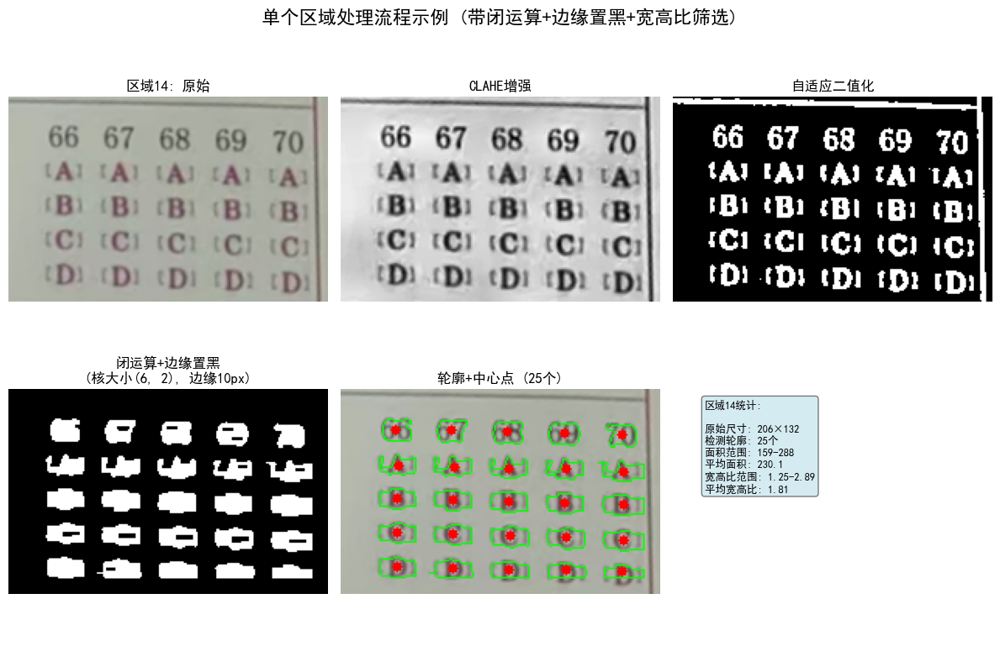

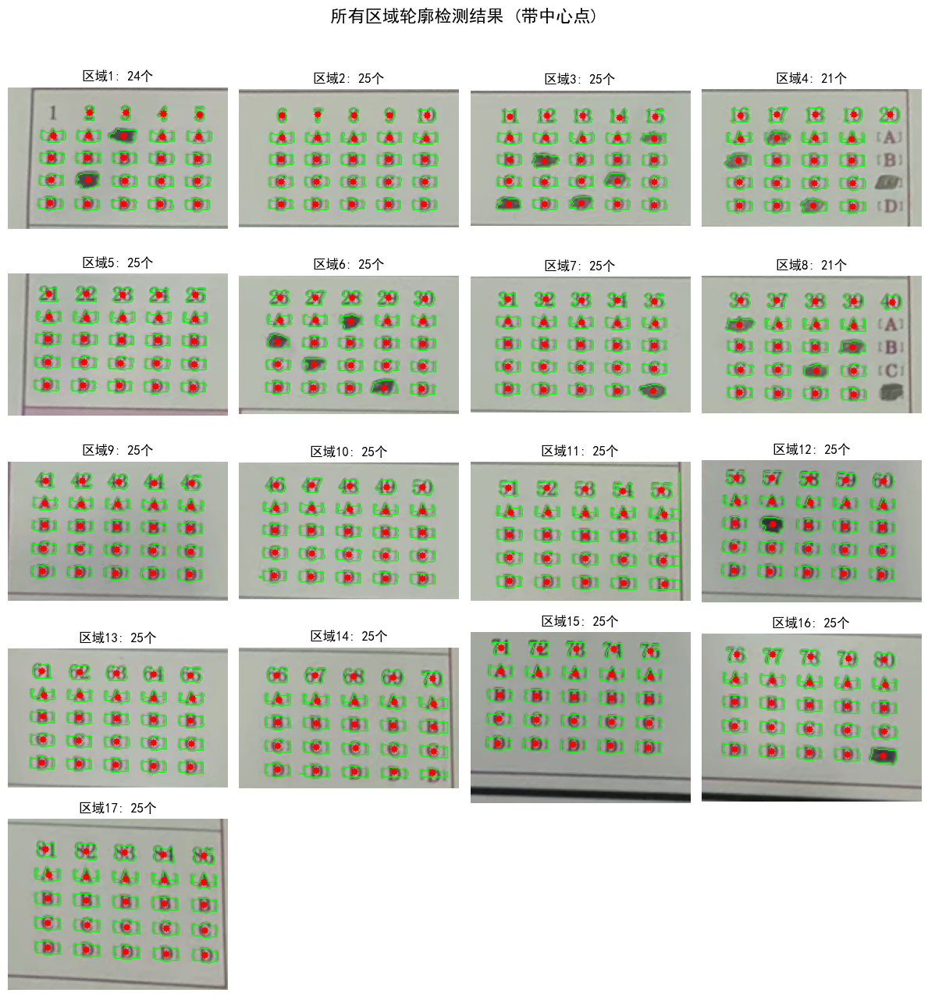


各区域轮廓数量统计:
区域 1: 24个轮廓
区域 2: 25个轮廓
区域 3: 25个轮廓
区域 4: 21个轮廓
区域 5: 25个轮廓
区域 6: 25个轮廓
区域 7: 25个轮廓
区域 8: 21个轮廓
区域 9: 25个轮廓
区域10: 25个轮廓
区域11: 25个轮廓
区域12: 25个轮廓
区域13: 25个轮廓
区域14: 25个轮廓
区域15: 25个轮廓
区域16: 25个轮廓
区域17: 25个轮廓

总计: 416个轮廓
平均每个区域: 24.5个轮廓

宽高比统计:
  最小宽高比: 0.630
  最大宽高比: 2.889
  平均宽高比: 1.655
  筛选范围: 0.5 - 6.0


In [282]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# ==================== 1. 参数配置 ====================
PARAMS = {
    'clahe_clip': 2.0,
    'clahe_grid': (8, 8),
    'adaptive_block': 31,
    'adaptive_c': 10,
    'close_kernel': (6, 2),  # 闭运算核
    'border_width': 10,  # 边缘置黑宽度
    'min_area': 20,
    'max_area': 300,
    'min_aspect_ratio': 0.5,  # 最小宽高比
    'max_aspect_ratio': 6.0,  # 最大宽高比
}

# ==================== 2. 单个区域处理函数 ====================
def process_single_region(region_img, region_id):
    """处理单个区域，返回处理结果"""
    # 转换为灰度
    if len(region_img.shape) == 3:
        gray = cv2.cvtColor(region_img, cv2.COLOR_BGR2GRAY)
    else:
        gray = region_img.copy()
    
    # CLAHE增强
    clahe = cv2.createCLAHE(clipLimit=PARAMS['clahe_clip'], 
                           tileGridSize=PARAMS['clahe_grid'])
    clahe_result = clahe.apply(gray)
    
    # 自适应二值化
    binary = cv2.adaptiveThreshold(clahe_result, 255,
                                  cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                  cv2.THRESH_BINARY_INV,
                                  PARAMS['adaptive_block'],
                                  PARAMS['adaptive_c'])
    
    # 闭运算（填充小孔洞）
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, PARAMS['close_kernel'])
    closed = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel)
    
    # 将边缘一周的像素置为黑色（避免边界黏连）
    border_width = PARAMS['border_width']
    h, w = closed.shape
    
    if border_width > 0:
        # 设置上下左右四个边的像素为0
        closed[0:border_width, :] = 0  # 上边
        closed[h-border_width:h, :] = 0  # 下边
        closed[:, 0:border_width] = 0  # 左边
        closed[:, w-border_width:w] = 0  # 右边
    
    # 轮廓检测
    contours, _ = cv2.findContours(closed, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # 过滤轮廓（面积 + 宽高比）
    valid_contours = []
    contour_info = []  # 存储轮廓信息，包括中心点
    
    for cnt in contours:
        area = cv2.contourArea(cnt)
        x, y, w_rect, h_rect = cv2.boundingRect(cnt)
        
        # 计算宽高比
        aspect_ratio = w_rect / h_rect if h_rect > 0 else 0
        
        # 面积和宽高比筛选
        if (PARAMS['min_area'] <= area <= PARAMS['max_area'] and
            PARAMS['min_aspect_ratio'] <= aspect_ratio <= PARAMS['max_aspect_ratio']):
            
            valid_contours.append(cnt)
            
            # 计算中心点
            M = cv2.moments(cnt)
            if M['m00'] != 0:
                cx = int(M['m10'] / M['m00'])
                cy = int(M['m01'] / M['m00'])
            else:
                cx = x + w_rect // 2
                cy = y + h_rect // 2
            
            contour_info.append({
                'contour': cnt,
                'bbox': (x, y, w_rect, h_rect),
                'area': area,
                'aspect_ratio': aspect_ratio,
                'center': (cx, cy)
            })
    
    # 在原图上绘制轮廓和中心点
    if len(region_img.shape) == 3:
        contour_img = region_img.copy()
    else:
        contour_img = cv2.cvtColor(region_img, cv2.COLOR_GRAY2BGR)
    
    # 绘制轮廓
    cv2.drawContours(contour_img, valid_contours, -1, (0, 255, 0), 1)
    
    # 绘制中心点（红色）
    for info in contour_info:
        cx, cy = info['center']
        cv2.circle(contour_img, (cx, cy), 3, (0, 0, 255), -1)  # 红色实心圆点
    
    return {
        'region_id': region_id,
        'original': region_img,
        'gray': gray,
        'clahe': clahe_result,
        'binary': binary,
        'closed': closed,
        'contour_img': contour_img,
        'contours': valid_contours,
        'contour_info': contour_info,
    }

# ==================== 3. 处理所有区域 ====================
print("处理17个区域...")
print(f"闭运算核大小: {PARAMS['close_kernel']}")
print(f"边缘置黑宽度: {PARAMS['border_width']}像素")
print(f"宽高比筛选范围: {PARAMS['min_aspect_ratio']} - {PARAMS['max_aspect_ratio']}")

results = []
for i in range(1, 18):
    var_name = f"region_{i:02d}"
    if var_name in globals():
        region_img = globals()[var_name]
        result = process_single_region(region_img, i)
        results.append(result)
        print(f"区域{i}: 检测到{len(result['contours'])}个轮廓")

# ==================== 4. 显示第一个区域的完整处理流程 ====================
if results:
    first_region = results[13]
    
    fig, axes = plt.subplots(2, 3, figsize=(12, 8))
    
    # 1. 原始图像
    if len(first_region['original'].shape) == 3:
        axes[0,0].imshow(cv2.cvtColor(first_region['original'], cv2.COLOR_BGR2RGB))
    else:
        axes[0,0].imshow(first_region['original'], cmap='gray')
    axes[0,0].set_title(f"区域{first_region['region_id']}: 原始")
    axes[0,0].axis('off')
    
    # 2. CLAHE增强
    axes[0,1].imshow(first_region['clahe'], cmap='gray')
    axes[0,1].set_title('CLAHE增强')
    axes[0,1].axis('off')
    
    # 3. 二值化
    axes[0,2].imshow(first_region['binary'], cmap='gray')
    axes[0,2].set_title('自适应二值化')
    axes[0,2].axis('off')
    
    # 4. 闭运算+边缘置黑
    axes[1,0].imshow(first_region['closed'], cmap='gray')
    axes[1,0].set_title(f'闭运算+边缘置黑\n(核大小{PARAMS["close_kernel"]}, 边缘{PARAMS["border_width"]}px)')
    axes[1,0].axis('off')
    
    # 5. 轮廓检测结果
    axes[1,1].imshow(cv2.cvtColor(first_region['contour_img'], cv2.COLOR_BGR2RGB))
    axes[1,1].set_title(f'轮廓+中心点 ({len(first_region["contours"])}个)')
    axes[1,1].axis('off')
    
    # 6. 统计信息
    axes[1,2].axis('off')
    stats_text = f"区域{first_region['region_id']}统计:\n\n"
    stats_text += f"原始尺寸: {first_region['original'].shape[1]}×{first_region['original'].shape[0]}\n"
    stats_text += f"检测轮廓: {len(first_region['contours'])}个\n"
    
    if first_region['contour_info']:
        areas = [info['area'] for info in first_region['contour_info']]
        aspect_ratios = [info['aspect_ratio'] for info in first_region['contour_info']]
        stats_text += f"面积范围: {min(areas):.0f}-{max(areas):.0f}\n"
        stats_text += f"平均面积: {np.mean(areas):.1f}\n"
        stats_text += f"宽高比范围: {min(aspect_ratios):.2f}-{max(aspect_ratios):.2f}\n"
        stats_text += f"平均宽高比: {np.mean(aspect_ratios):.2f}"
    
    axes[1,2].text(0.1, 0.5, stats_text, fontsize=9,
                  transform=axes[1,2].transAxes,
                  bbox=dict(boxstyle='round', facecolor='lightblue', alpha=0.5))
    
    plt.suptitle('单个区域处理流程示例 (带闭运算+边缘置黑+宽高比筛选)', fontsize=16)
    plt.tight_layout()
    plt.show()

# ==================== 5. 显示所有区域的轮廓检测结果 ====================
n_rows = 5
n_cols = 4
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols*3, n_rows*2.5))

for idx, result in enumerate(results):
    row = idx // n_cols
    col = idx % n_cols
    
    contour_img_rgb = cv2.cvtColor(result['contour_img'], cv2.COLOR_BGR2RGB)
    axes[row, col].imshow(contour_img_rgb)
    axes[row, col].set_title(f'区域{result["region_id"]}: {len(result["contours"])}个')
    axes[row, col].axis('off')

# 隐藏多余的子图
for idx in range(len(results), n_rows*n_cols):
    row = idx // n_cols
    col = idx % n_cols
    axes[row, col].axis('off')

plt.suptitle('所有区域轮廓检测结果 (带中心点)', fontsize=16, y=1.02)
plt.tight_layout()
plt.show()

# ==================== 6. 轮廓数量统计 ====================
print("\n各区域轮廓数量统计:")
for result in results:
    print(f"区域{result['region_id']:2d}: {len(result['contours']):2d}个轮廓")

total_contours = sum(len(r['contours']) for r in results)
print(f"\n总计: {total_contours}个轮廓")
print(f"平均每个区域: {total_contours/len(results):.1f}个轮廓")

# 宽高比统计
if results and any(len(r['contour_info']) > 0 for r in results):
    all_aspect_ratios = []
    for result in results:
        for info in result['contour_info']:
            all_aspect_ratios.append(info['aspect_ratio'])
    
    if all_aspect_ratios:
        print(f"\n宽高比统计:")
        print(f"  最小宽高比: {min(all_aspect_ratios):.3f}")
        print(f"  最大宽高比: {max(all_aspect_ratios):.3f}")
        print(f"  平均宽高比: {np.mean(all_aspect_ratios):.3f}")
        print(f"  筛选范围: {PARAMS['min_aspect_ratio']} - {PARAMS['max_aspect_ratio']}")

# 保存处理结果
processed_regions = results